## Load Data

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import re

# Set max_columns to None to always display all columns
pd.set_option('display.max_columns', None)

# Updated city details with OSMID and target date
city_details = {
    "Stockholm": {"osmid": "398021", "date": "2024-06-20"},
    "Amsterdam": {"osmid": "271110", "date": "2024-06-20"},
    "Boston": {"osmid": "2315704", "date": "2024-06-20"},
    # "Cambridge": {"osmid": "1933745", "date": "2024-06-20"},
    "Tunis": {"osmid": "8896976", "date": "2024-06-20"},
    "Hong Kong": {"osmid": "913110", "date": "2025-06-20"},
    "Singapore": {"osmid": "536780", "date": "2024-03-20"},
    "Belem": {"osmid": "185567", "date": "2025-03-20"},
    "Rio": {"osmid": "2697338", "date": "2025-12-21"},
    "Cape Town": {"osmid": "79604", "date": "2024-12-21"},
    "Sydney": {"osmid": "1251066", "date": "2025-12-21"},
}

# Enable test run and visualization toggle if needed
test_run = False
visualize = False
if test_run:
    city_details = {k: city_details[k] for k in list(city_details.keys())[:2]}

# Base path to the folders containing city files
base_path = "../results/output"

# First, load (and combine) raw data by city key.
# For Boston and Cambridge, use the same key ("Boston").
combined_city_data = {}  # key -> combined GeoDataFrame
for city, details in city_details.items():
    # Use "Boston" as the key for both Boston and Cambridge
    key = "Boston" if city in ["Boston", "Cambridge"] else city
    osmid = details["osmid"]
    target_date = details["date"]
    file_path = f"{base_path}/{osmid}/{osmid}_sidewalks_with_stats_multiple_dates.gpkg"
    
    try:
        city_data = gpd.read_file(file_path, engine='pyogrio')
        # If the key already exists, append (concatenate) the new data;
        # otherwise, start with this GeoDataFrame.
        if key in combined_city_data:
            combined_city_data[key] = pd.concat([combined_city_data[key], city_data], ignore_index=True)
        else:
            combined_city_data[key] = city_data
        print(f"Loaded data for {city} into key '{key}'.")
    except FileNotFoundError:
        print(f"File not found for {city} at {file_path}. Skipping...")

# Now process each (possibly combined) city's data to compute the time-series.
processed_building_shade = {}
processed_tree_shade = {}
all_hours = range(48)  # 48 slots for 30-minute intervals (0:00 to 24:00)

for key, city_data in combined_city_data.items():
    # Determine the target date.
    # For Boston (the combined key), we assume Boston’s target date.
    target_date = city_details["Boston"]["date"] if key == "Boston" else city_details[key]["date"]
    date_str = target_date.replace("-", "")
    
    # Build a regex to match columns like: YYYYMMDD_(building|tree)_shade_percent_at_(\d+)
    column_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    matched_columns = [col for col in city_data.columns if re.match(column_pattern, col)]
    if not matched_columns:
        print(f"No data columns for {key} on {target_date}. Skipping...")
        continue

    # Separate building and tree columns
    building_columns = [col for col in matched_columns if "_building_" in col]
    tree_columns = [col for col in matched_columns if "_tree_" in col]
    
    # Get the times (as integers) from the column names using a regex pattern.
    time_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    building_times = [int(re.search(time_pattern, col).group(2)) for col in building_columns]
    tree_times = [int(re.search(time_pattern, col).group(2)) for col in tree_columns]
    
    # Sort columns by time
    sorted_building_columns = [col for _, col in sorted(zip(building_times, building_columns))]
    sorted_tree_columns = [col for _, col in sorted(zip(tree_times, tree_columns))]
    
    # Create arrays for full 24-hour coverage (default value 100%)
    building_full = np.full(len(all_hours), 100.0)
    tree_full = np.full(len(all_hours), 100.0)
    
    # A helper function to map a time (e.g., 930 for 9:30) to an index (0 to 47)
    def normalize_time_to_index(time):
        hour = time // 100
        minute = time % 100
        return hour * 2 + minute // 30

    building_indices = [normalize_time_to_index(t) for t in building_times]
    tree_indices = [normalize_time_to_index(t) for t in tree_times]
    
    # Fill the arrays with the average values from the combined GeoDataFrame.
    for idx, col in zip(building_indices, sorted_building_columns):
        if idx < len(all_hours):
            building_full[idx] = city_data[col].mean()
    for idx, col in zip(tree_indices, sorted_tree_columns):
        if idx < len(all_hours):
            tree_full[idx] = city_data[col].mean()
    
    processed_building_shade[key] = building_full
    processed_tree_shade[key] = tree_full
    print(f"Processed data for {key}.")

# Create DataFrames for further analysis or plotting.
city_names = list(processed_building_shade.keys())
time_labels = [f"{h//2:02}:{(h%2)*30:02}" for h in all_hours]

building_shade_df = pd.DataFrame(
    [processed_building_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)
tree_shade_df = pd.DataFrame(
    [processed_tree_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)

# Preview the DataFrames
print("\nBuilding Shade DataFrame:")
print(building_shade_df.head())

print("\nTree Shade DataFrame:")
print(tree_shade_df.head())


Loaded data for Stockholm into key 'Stockholm'.
Loaded data for Amsterdam into key 'Amsterdam'.
Loaded data for Boston into key 'Boston'.
Loaded data for Tunis into key 'Tunis'.
Loaded data for Hong Kong into key 'Hong Kong'.
Loaded data for Singapore into key 'Singapore'.
Loaded data for Belem into key 'Belem'.
Loaded data for Rio into key 'Rio'.
Loaded data for Cape Town into key 'Cape Town'.
Loaded data for Sydney into key 'Sydney'.
Processed data for Stockholm.
Processed data for Amsterdam.
Processed data for Boston.
Processed data for Tunis.
Processed data for Hong Kong.
Processed data for Singapore.
Processed data for Belem.
Processed data for Rio.
Processed data for Cape Town.
Processed data for Sydney.

Building Shade DataFrame:
           00:00  00:30  01:00  01:30  02:00  02:30       03:00       03:30  \
Stockholm  100.0  100.0  100.0  100.0  100.0  100.0   91.110865   82.919447   
Amsterdam  100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Boston     100.0

## Also compute the shade availability index for each city

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import re

# Set max_columns to None to always display all columns
pd.set_option('display.max_columns', None)

# Updated city details with OSMID, target date, and custom shade target.
city_details = {
    "Stockholm": {"osmid": "398021", "date": "2024-06-20", "shade_target": 30},
    "Amsterdam": {"osmid": "271110", "date": "2024-06-20", "shade_target": 30},
    "Boston": {"osmid": "2315704", "date": "2024-06-20", "shade_target": 30},
    # "Cambridge": {"osmid": "1933745", "date": "2024-06-20", "shade_target": 50},
    "Rome": {"osmid": "2084465", "date": "2025-06-20", "shade_target": 50},
    "Tunis": {"osmid": "8896976", "date": "2024-06-20", "shade_target": 50},
    "Hong Kong": {"osmid": "913110", "date": "2025-06-20", "shade_target": 50},
    # "Singapore": {"osmid": "536780", "date": "2024-03-20", "shade_target": 50},
    "Belem": {"osmid": "185567", "date": "2025-03-20", "shade_target": 50},
    "Rio": {"osmid": "2697338", "date": "2025-12-21", "shade_target": 50},
    "Sydney": {"osmid": "1251066", "date": "2025-12-21", "shade_target": 50},
    "Cape Town": {"osmid": "79604", "date": "2024-12-21", "shade_target": 50},
}

# Toggle for test run / visualization if needed
test_run = False
visualize = False
if test_run:
    city_details = {k: city_details[k] for k in list(city_details.keys())[:2]}

# Base path to the folders containing city files
base_path = "../results/output"

# First, load (and combine) raw data by city key.
# For Boston and Cambridge, use the same key ("Boston").
combined_city_data = {}  # key -> combined GeoDataFrame
for city, details in city_details.items():
    key = "Boston" if city in ["Boston", "Cambridge"] else city
    osmid = details["osmid"]
    target_date = details["date"]
    file_path = f"{base_path}/{osmid}/{osmid}_sidewalks_with_stats_multiple_dates.gpkg"
    
    try:
        city_data = gpd.read_file(file_path, engine='pyogrio')
        # If the key already exists, append (concatenate) the new data;
        # otherwise, start with this GeoDataFrame.
        if key in combined_city_data:
            combined_city_data[key] = pd.concat([combined_city_data[key], city_data], ignore_index=True)
        else:
            combined_city_data[key] = city_data
        print(f"Loaded data for {city} into key '{key}'.")
    except FileNotFoundError:
        print(f"File not found for {city} at {file_path}. Skipping...")

# ----- Define daylight hour range per city -----
# (Times are given as (start, end) in HH:MM format; the range is [start, end),
#  so for 08:00 to 17:00, timepoints from 08:00 up to 16:30 are included.)
daylight_hours = {
    "Tunis": ("08:00", "17:00"),
    "Cape Town": ("08:00", "17:00"),
    "Sydney": ("08:00", "17:00"),
    # Adjust these ranges for other cities as needed
    "Stockholm": ("09:00", "18:00"),
    "Amsterdam": ("09:00", "18:00"),
    "Boston": ("09:00", "18:00"),
    "Hong Kong": ("08:00", "17:00"),
    "Singapore": ("09:00", "18:00"),
    "Belem": ("08:00", "17:00"),
    "Rio": ("08:00", "17:00"),
    "Rome": ("08:00", "17:00"),
}

# Helper function to convert HH:MM string to a half-hour index (0 to 47)
def time_str_to_index(time_str):
    hour, minute = map(int, time_str.split(':'))
    return hour * 2 + minute // 30

# Number of half-hour time slots in a day
n_slots = 48

# ----- Process each city's data to compute time-series and the shade availability index -----
processed_building_shade = {}
processed_tree_shade = {}
all_hours = range(n_slots)  # 0:00 to 24:00 in 30-minute steps

for key, city_data in combined_city_data.items():
    # Determine the target date (for Boston the combined key, use Boston’s target date)
    target_date = city_details["Boston"]["date"] if key == "Boston" else city_details[key]["date"]
    date_str = target_date.replace("-", "")
    
    # Build a regex to match columns like: YYYYMMDD_(building|tree)_shade_percent_at_(\d+)
    column_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    matched_columns = [col for col in city_data.columns if re.match(column_pattern, col)]
    if not matched_columns:
        print(f"No data columns for {key} on {target_date}. Skipping...")
        continue

    # Separate building and tree columns
    building_columns = [col for col in matched_columns if "_building_" in col]
    tree_columns = [col for col in matched_columns if "_tree_" in col]
    
    # Extract times (e.g., 930 for 9:30) from the column names using regex.
    time_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    building_times = [int(re.search(time_pattern, col).group(2)) for col in building_columns]
    tree_times = [int(re.search(time_pattern, col).group(2)) for col in tree_columns]
    
    # Helper function to map numeric time (e.g., 930) to an index (0-47)
    def normalize_time_to_index(time):
        hour = time // 100
        minute = time % 100
        return hour * 2 + minute // 30

    building_indices = [normalize_time_to_index(t) for t in building_times]
    tree_indices = [normalize_time_to_index(t) for t in tree_times]
    
    # --- Part 1: Build averaged shade arrays (if needed for plotting) ---
    # Create arrays for full 24-hour coverage (default value 100%)
    building_full = np.full(n_slots, 100.0)
    tree_full = np.full(n_slots, 100.0)
    for idx, col in zip(building_indices, building_columns):
        if idx < n_slots:
            building_full[idx] = city_data[col].mean()
    for idx, col in zip(tree_indices, tree_columns):
        if idx < n_slots:
            tree_full[idx] = city_data[col].mean()
    
    processed_building_shade[key] = building_full
    processed_tree_shade[key] = tree_full
    print(f"Processed averaged data for {key}.")

    # --- Part 2: Compute per-sidewalk shade availability index ---
    # Get the custom shade target for the city (default is 50 if not provided)
    shade_target = city_details[key].get("shade_target", 50)
    
    # Determine the daylight time range for the city (default to 08:00-17:00 if not defined)
    start_time, end_time = daylight_hours.get(key, ("08:00", "17:00"))
    start_idx = time_str_to_index(start_time)
    end_idx = time_str_to_index(end_time)
    daylight_indices = list(range(start_idx, end_idx))  # indices corresponding to the desired time range
    
    # Create full matrices for building and tree shade for each sidewalk (each row) over 48 slots,
    # but now initialize with NaN so that missing measurements remain missing.
    n_rows = city_data.shape[0]
    building_matrix = np.full((n_rows, n_slots), np.nan)
    tree_matrix = np.full((n_rows, n_slots), np.nan)
    
    # Fill the matrices using the available measured columns.
    for idx, col in zip(building_indices, building_columns):
        if idx < n_slots:
            building_matrix[:, idx] = city_data[col].values
    for idx, col in zip(tree_indices, tree_columns):
        if idx < n_slots:
            tree_matrix[:, idx] = city_data[col].values

    # For each half-hour time slot in the daylight range, compute the effective shade as the maximum
    # of building and tree shade. Use np.nanmax over a stacked array so that if one value is missing,
    # the other (if valid) is taken.
    stacked = np.stack([building_matrix[:, daylight_indices], tree_matrix[:, daylight_indices]], axis=0)
    effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
    
    # Compute the shade availability index per sidewalk.
    # For each row, count only time slots with valid (non-NaN) measurements.
    valid_counts = np.sum(np.isfinite(effective_shade), axis=1)
    # Count the number of time slots where effective shade meets or exceeds the custom target.
    sufficient_counts = np.nansum((effective_shade >= shade_target).astype(int), axis=1)
    
    # Initialize index as NaN, then compute fraction for rows with valid data.
    shade_index = np.full(n_rows, np.nan)
    valid_mask = valid_counts > 0
    shade_index[valid_mask] = sufficient_counts[valid_mask] / valid_counts[valid_mask]
    
    # Add this index as a new column in the city's GeoDataFrame.
    city_data["shade_availability_index"] = shade_index
    combined_city_data[key] = city_data  # update with the new column
    print(f"Computed shade availability index for {key}.")

# Create DataFrames for further analysis or plotting of averaged data.
city_names = list(processed_building_shade.keys())
time_labels = [f"{h//2:02}:{(h%2)*30:02}" for h in range(n_slots)]

building_shade_df = pd.DataFrame(
    [processed_building_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)
tree_shade_df = pd.DataFrame(
    [processed_tree_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)

# Preview the DataFrames
print("\nBuilding Shade DataFrame (averaged):")
print(building_shade_df.head())

print("\nTree Shade DataFrame (averaged):")
print(tree_shade_df.head())

# (Optionally, visualize or further analyze the 'shade_availability_index' column for each city.)

Loaded data for Stockholm into key 'Stockholm'.
Loaded data for Amsterdam into key 'Amsterdam'.
Loaded data for Boston into key 'Boston'.
Loaded data for Rome into key 'Rome'.
Loaded data for Tunis into key 'Tunis'.
Loaded data for Hong Kong into key 'Hong Kong'.
Loaded data for Belem into key 'Belem'.
Loaded data for Rio into key 'Rio'.
Loaded data for Sydney into key 'Sydney'.
Loaded data for Cape Town into key 'Cape Town'.
Processed averaged data for Stockholm.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Stockholm.
Processed averaged data for Amsterdam.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Amsterdam.
Processed averaged data for Boston.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Boston.
Processed averaged data for Rome.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Rome.
Processed averaged data for Tunis.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Tunis.
Processed averaged data for Hong Kong.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Hong Kong.
Processed averaged data for Belem.
Computed shade availability index for Belem.
Processed averaged data for Rio.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Rio.
Processed averaged data for Sydney.
Computed shade availability index for Sydney.
Processed averaged data for Cape Town.
Computed shade availability index for Cape Town.

Building Shade DataFrame (averaged):
           00:00  00:30  01:00  01:30  02:00  02:30       03:00       03:30  \
Stockholm  100.0  100.0  100.0  100.0  100.0  100.0   91.110865   82.919447   
Amsterdam  100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Boston     100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Rome       100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Tunis      100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   

                04:00      04:30      05:00       05:30      06:00      06:30  \
Stockholm   73.525237   63.90843   54.20146   46.335861  39.943996  34.447656   
Amsterdam  100.000000  100.00000  100.00000   92.415439  76.866839  62.284672   
Boston     100.000000  100.0000

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2641957121.py:160: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


# How about shade availability index pre- and post?

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import re

# Set max_columns to None to always display all columns
pd.set_option('display.max_columns', None)

# Updated city details with OSMID, target date, and custom shade target.
city_details = {
    "Stockholm": {"osmid": "398021", "date": "2024-06-20", "shade_target": 30},
    "Amsterdam": {"osmid": "271110", "date": "2024-06-20", "shade_target": 30},
    "Boston": {"osmid": "2315704", "date": "2024-06-20", "shade_target": 30},
    # "Cambridge": {"osmid": "1933745", "date": "2024-06-20", "shade_target": 50},
    "Rome": {"osmid": "2084465", "date": "2025-06-20", "shade_target": 50},
    "Tunis": {"osmid": "8896976", "date": "2024-06-20", "shade_target": 50},
    "Hong Kong": {"osmid": "913110", "date": "2025-06-20", "shade_target": 50},
    # "Singapore": {"osmid": "536780", "date": "2024-03-20", "shade_target": 50},
    "Belem": {"osmid": "185567", "date": "2025-03-20", "shade_target": 50},
    "Rio": {"osmid": "2697338", "date": "2025-12-21", "shade_target": 50},
    "Sydney": {"osmid": "1251066", "date": "2025-12-21", "shade_target": 50},
    "Cape Town": {"osmid": "79604", "date": "2024-12-21", "shade_target": 50},
}

# Toggle for test run / visualization if needed
test_run = False
visualize = False
if test_run:
    city_details = {k: city_details[k] for k in list(city_details.keys())[:2]}

# Base path to the folders containing city files
base_path = "../results/output"

# First, load (and combine) raw data by city key.
# For Boston and Cambridge, use the same key ("Boston").
combined_city_data = {}  # key -> combined GeoDataFrame
for city, details in city_details.items():
    key = "Boston" if city in ["Boston", "Cambridge"] else city
    osmid = details["osmid"]
    target_date = details["date"]
    file_path = f"{base_path}/{osmid}/{osmid}_sidewalks_with_stats_multiple_dates.gpkg"
    
    try:
        city_data = gpd.read_file(file_path, engine='pyogrio')
        # If the key already exists, append (concatenate) the new data;
        # otherwise, start with this GeoDataFrame.
        if key in combined_city_data:
            combined_city_data[key] = pd.concat([combined_city_data[key], city_data], ignore_index=True)
        else:
            combined_city_data[key] = city_data
        print(f"Loaded data for {city} into key '{key}'.")
    except FileNotFoundError:
        print(f"File not found for {city} at {file_path}. Skipping...")

# ----- Define daylight hour range per city -----
# (Times are given as (start, end) in HH:MM format; the range is [start, end),
#  so for 08:00 to 17:00, timepoints from 08:00 up to 16:30 are included.)
daylight_hours = {
    "Tunis": ("08:00", "17:00"),
    "Cape Town": ("08:00", "17:00"),
    "Sydney": ("08:00", "17:00"),
    # Adjust these ranges for other cities as needed
    "Stockholm": ("09:00", "18:00"),
    "Amsterdam": ("09:00", "18:00"),
    "Boston": ("09:00", "18:00"),
    "Hong Kong": ("08:00", "17:00"),
    "Singapore": ("09:00", "18:00"),
    "Belem": ("08:00", "17:00"),
    "Rio": ("08:00", "17:00"),
    "Rome": ("08:00", "17:00"),
}

# Helper function to convert HH:MM string to a half-hour index (0 to 47)
def time_str_to_index(time_str):
    hour, minute = map(int, time_str.split(':'))
    return hour * 2 + minute // 30

# Number of half-hour time slots in a day
n_slots = 48

# ----- Process each city's data to compute time-series and the shade availability index -----
processed_building_shade = {}
processed_tree_shade = {}
all_hours = range(n_slots)  # 0:00 to 24:00 in 30-minute steps

for key, city_data in combined_city_data.items():
    # Determine the target date (for Boston the combined key, use Boston’s target date)
    target_date = city_details["Boston"]["date"] if key == "Boston" else city_details[key]["date"]
    date_str = target_date.replace("-", "")
    
    # Build a regex to match columns like: YYYYMMDD_(building|tree)_shade_percent_at_(\d+)
    column_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    matched_columns = [col for col in city_data.columns if re.match(column_pattern, col)]
    if not matched_columns:
        print(f"No data columns for {key} on {target_date}. Skipping...")
        continue

    # Separate building and tree columns
    building_columns = [col for col in matched_columns if "_building_" in col]
    tree_columns = [col for col in matched_columns if "_tree_" in col]
    
    # Extract times (e.g., 930 for 9:30) from the column names using regex.
    time_pattern = rf"{date_str}_(building|tree)_shade_percent_at_(\d+)"
    building_times = [int(re.search(time_pattern, col).group(2)) for col in building_columns]
    tree_times = [int(re.search(time_pattern, col).group(2)) for col in tree_columns]
    
    # Helper function to map numeric time (e.g., 930) to an index (0-47)
    def normalize_time_to_index(time):
        hour = time // 100
        minute = time % 100
        return hour * 2 + minute // 30

    building_indices = [normalize_time_to_index(t) for t in building_times]
    tree_indices = [normalize_time_to_index(t) for t in tree_times]
    
    # --- Part 1: Build averaged shade arrays (if needed for plotting) ---
    # Create arrays for full 24-hour coverage (default value 100%)
    
    building_full = np.full(n_slots, 100.0)
    tree_full = np.full(n_slots, 100.0)
    for idx, col in zip(building_indices, building_columns):
        if idx < n_slots:
            building_full[idx] = city_data[col].mean()
    for idx, col in zip(tree_indices, tree_columns):
        if idx < n_slots:
            tree_full[idx] = city_data[col].mean()
    
    processed_building_shade[key] = building_full
    processed_tree_shade[key] = tree_full
    print(f"Processed averaged data for {key}.")

    # --- Part 2: Compute per-sidewalk shade availability index ---
    # Get the custom shade target for the city (default is 50 if not provided)
    shade_target = city_details[key].get("shade_target", 50)
    
    # Determine the daylight time range for the city (default to 08:00-17:00 if not defined)
    start_time, end_time = daylight_hours.get(key, ("08:00", "17:00"))
    start_idx = time_str_to_index(start_time)
    end_idx = time_str_to_index(end_time)
    daylight_indices = list(range(start_idx, end_idx))  # indices corresponding to the desired time range
    
    # Create full matrices for building and tree shade for each sidewalk (each row) over 48 slots,
    # but now initialize with NaN so that missing measurements remain missing.
    n_rows = city_data.shape[0]
    building_matrix = np.full((n_rows, n_slots), np.nan)
    tree_matrix = np.full((n_rows, n_slots), np.nan)
    
    # Fill the matrices using the available measured columns.
    for idx, col in zip(building_indices, building_columns):
        if idx < n_slots:
            building_matrix[:, idx] = city_data[col].values
    for idx, col in zip(tree_indices, tree_columns):
        if idx < n_slots:
            tree_matrix[:, idx] = city_data[col].values

    # For each half-hour time slot in the daylight range, compute the effective shade as the maximum
    # of building and tree shade. Use np.nanmax over a stacked array so that if one value is missing,
    # the other (if valid) is taken.
    stacked = np.stack([building_matrix[:, daylight_indices], tree_matrix[:, daylight_indices]], axis=0)
    effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
    
    # Compute the shade availability index per sidewalk, separately
    def compute_availability(matrix, threshold):
        valid_counts = np.sum(np.isfinite(matrix), axis=1)
        sufficient_counts = np.nansum((matrix >= threshold).astype(int), axis=1)
        availability = np.full(matrix.shape[0], np.nan)
        valid_mask = valid_counts > 0
        availability[valid_mask] = sufficient_counts[valid_mask] / valid_counts[valid_mask]
        return availability

    # Subset to daylight slots
    bldg_daylight = building_matrix[:, daylight_indices]
    tree_daylight = tree_matrix[:, daylight_indices]

    # Compute availability indices
    building_avail_index = compute_availability(bldg_daylight, shade_target)
    tree_avail_index = compute_availability(tree_daylight, shade_target)

    # Store both separately and as max of the two (already calculated)
    city_data["shade_availability_index_building"] = building_avail_index
    city_data["shade_availability_index_tree"] = tree_avail_index
    city_data["shade_availability_index"] = np.nanmax(
        np.stack([bldg_daylight, tree_daylight], axis=0), axis=0
    ).mean(axis=1)  # optional: average max shade over time as a complement

    # Update dictionary
    combined_city_data[key] = city_data
    print(f"Computed shade availability index for {key}.")

# Create DataFrames for further analysis or plotting of averaged data.
city_names = list(processed_building_shade.keys())
time_labels = [f"{h//2:02}:{(h%2)*30:02}" for h in range(n_slots)]

building_shade_df = pd.DataFrame(
    [processed_building_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)
tree_shade_df = pd.DataFrame(
    [processed_tree_shade[city] for city in city_names],
    index=city_names,
    columns=time_labels
)

# Preview the DataFrames
print("\nBuilding Shade DataFrame (averaged):")
print(building_shade_df.head())

print("\nTree Shade DataFrame (averaged):")
print(tree_shade_df.head())

# (Optionally, visualize or further analyze the 'shade_availability_index' column for each city.)

Loaded data for Stockholm into key 'Stockholm'.
Loaded data for Amsterdam into key 'Amsterdam'.
Loaded data for Boston into key 'Boston'.
Loaded data for Rome into key 'Rome'.
Loaded data for Tunis into key 'Tunis'.
Loaded data for Hong Kong into key 'Hong Kong'.
Loaded data for Belem into key 'Belem'.
Loaded data for Rio into key 'Rio'.
Loaded data for Sydney into key 'Sydney'.
Loaded data for Cape Town into key 'Cape Town'.
Processed averaged data for Stockholm.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Stockholm.
Processed averaged data for Amsterdam.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Amsterdam.
Processed averaged data for Boston.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Boston.
Processed averaged data for Rome.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Rome.
Processed averaged data for Tunis.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Tunis.
Processed averaged data for Hong Kong.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Hong Kong.
Processed averaged data for Belem.
Computed shade availability index for Belem.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Processed averaged data for Rio.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


Computed shade availability index for Rio.
Processed averaged data for Sydney.
Computed shade availability index for Sydney.
Processed averaged data for Cape Town.


/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:161: RuntimeWarning: All-NaN slice encountered
  effective_shade = np.nanmax(stacked, axis=0)  # shape: (n_rows, number of daylight slots)


Computed shade availability index for Cape Town.

Building Shade DataFrame (averaged):
           00:00  00:30  01:00  01:30  02:00  02:30       03:00       03:30  \
Stockholm  100.0  100.0  100.0  100.0  100.0  100.0   91.110865   82.919447   
Amsterdam  100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Boston     100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Rome       100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   
Tunis      100.0  100.0  100.0  100.0  100.0  100.0  100.000000  100.000000   

                04:00      04:30      05:00       05:30      06:00      06:30  \
Stockholm   73.525237   63.90843   54.20146   46.335861  39.943996  34.447656   
Amsterdam  100.000000  100.00000  100.00000   92.415439  76.866839  62.284672   
Boston     100.000000  100.00000  100.00000   86.410995  69.421787  55.676718   
Rome       100.000000  100.00000  100.00000  100.000000  82.627604  67.672558   
Tunis      100.000000  100.00000 

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_12340/3406914813.py:183: RuntimeWarning: All-NaN slice encountered
  city_data["shade_availability_index"] = np.nanmax(


In [3]:
import os

base_path = "../results/output"
total_size_mb = 0
city_file_sizes = {}

for city, details in city_details.items():
    key = "Boston" if city in ["Boston", "Cambridge"] else city
    osmid = details["osmid"]
    file_path = f"{base_path}/{osmid}/{osmid}_sidewalks_with_stats_multiple_dates.gpkg"
    
    if os.path.exists(file_path):
        size_bytes = os.path.getsize(file_path)
        size_mb = size_bytes / (1024 * 1024)
        city_file_sizes[city] = size_mb
        total_size_mb += size_mb
    else:
        print(f"File not found for {city}: {file_path}")

# Print per city and total
for city, size in city_file_sizes.items():
    print(f"{city}: {size:.2f} MB")
print(f"\nEstimated total size: {total_size_mb:.2f} MB")

Stockholm: 199.42 MB
Amsterdam: 167.78 MB
Boston: 102.25 MB
Rome: 268.83 MB
Tunis: 180.23 MB
Hong Kong: 326.77 MB
Belem: 85.70 MB
Rio: 549.29 MB
Sydney: 26.43 MB
Cape Town: 461.12 MB

Estimated total size: 2367.82 MB


## City Comparison

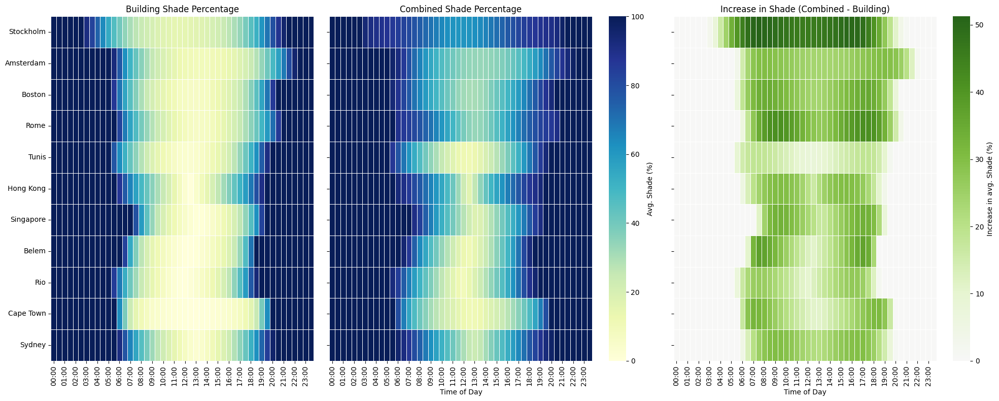

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Compute the difference between combined shade and building shade
shade_diff = tree_shade_df - building_shade_df

# Define a common scale for the building and combined shade heatmaps
shade_vmin = 0
shade_vmax = 100

# Create a figure with three subplots.
# Adjust the width ratios so that the first plot (without a colorbar) is made slightly narrower.
fig, axes = plt.subplots(1, 3, figsize=(20, 8), sharey=True, 
                           gridspec_kw={'width_ratios': [0.8, 1, 1]})

# Plot 1: Building shade heatmap (no colorbar)
sns.heatmap(
    building_shade_df,
    ax=axes[0],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar=False,       # remove the colorbar here
    linewidths=0.5
)
axes[0].set_title("Building Shade Percentage")
# axes[0].set_ylabel("City")
# axes[0].set_xlabel("Time of Day")

# Plot 2: Combined shade heatmap (with colorbar)
sns.heatmap(
    tree_shade_df,
    ax=axes[1],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar_kws={'label': 'Avg. Shade (%)'},
    linewidths=0.5
)
axes[1].set_title("Combined Shade Percentage")
# axes[1].set_xlabel("Time of Day")

# Plot 3: Difference heatmap (with colorbar)
sns.heatmap(
    shade_diff,
    ax=axes[2],
    cmap="PiYG",   # diverging colormap for differences
    center=0,          # center the colormap at 0 for the difference plot
    cbar_kws={'label': 'Increase in avg. Shade (%)'},
    linewidths=0.5
)
axes[2].set_title("Increase in Shade (Combined - Building)")
axes[2].set_xlabel("Time of Day")

plt.tight_layout()
plt.show()

/tmp/ipykernel_3553936/273886304.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


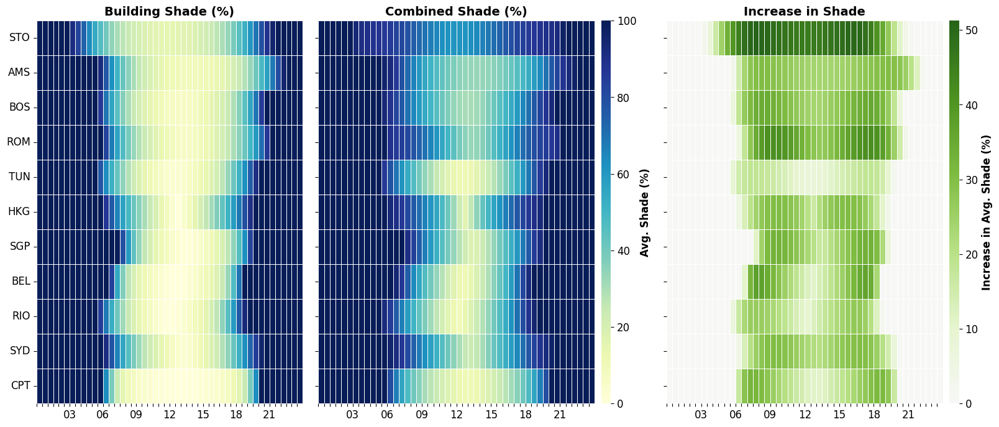

In [30]:
import matplotlib.pyplot as plt
import seaborn as sns

# === Plot Settings ===
font_size = 14
tick_label_fontsize = 12
colorbar_fontsize = 12

# Abbreviations
city_abbreviations = {
    "Stockholm": "STO", "Amsterdam": "AMS", "Boston": "BOS", "Rome": "ROM",
    "Tunis": "TUN", "Hong Kong": "HKG", "Singapore": "SGP", "Belem": "BEL",
    "Rio": "RIO", "Sydney": "SYD", "Cape Town": "CPT"
}

# === Safe renaming with fallback ===
def abbreviate_index(df):
    df = df.copy()
    df.index = df.index.astype(str).str.strip()

    # Only apply mapping if all values are full city names
    if all(name in city_abbreviations for name in df.index):
        df.index = df.index.map(city_abbreviations.get)
    return df

def abbreviate_time_labels(labels, step=6):
    return [label[:2] if i % step == 0 else "" for i, label in enumerate(labels)]

building_shade_df = abbreviate_index(building_shade_df)
tree_shade_df = abbreviate_index(tree_shade_df)
shade_diff = tree_shade_df - building_shade_df

# === X-tick labels (every 3 hours) ===
xticks = list(range(len(tree_shade_df.columns)))
xtick_labels = [col if i % 6 == 0 else "" for i, col in enumerate(tree_shade_df.columns)]
xtick_labels = abbreviate_time_labels(tree_shade_df.columns, step=6)
xtick_labels[0] = ""  # remove the first label (e.g., "00:00")


# === Create plot ===
fig, axes = plt.subplots(1, 3, figsize=(20, 8), sharey=True,
                         gridspec_kw={'width_ratios': [0.8, 1, 1], 'wspace': 0.05})

heatmap_kws = dict(vmin=0, vmax=100, linewidths=0.5, cmap="YlGnBu")

# Plot 1: Building shade
sns.heatmap(building_shade_df, ax=axes[0], cbar=False, **heatmap_kws)
axes[0].set_title("Building Shade (%)", fontweight='bold', fontsize=font_size)
# axes[0].set_ylabel("City", fontweight='bold', fontsize=font_size)
axes[0].set_xticks(xticks)
axes[0].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[0].tick_params(axis='x', rotation=0)
axes[0].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[0].set_yticklabels(axes[0].get_yticklabels(), rotation=0, fontsize=tick_label_fontsize)

# Plot 2: Combined shade
sns.heatmap(tree_shade_df, ax=axes[1],
            cbar_kws={'label': 'Avg. Shade (%)', 'aspect': 40, 'pad': 0.02},
            **heatmap_kws)
axes[1].set_title("Combined Shade (%)", fontweight='bold', fontsize=font_size)
axes[1].set_xticks(xticks)
axes[1].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[1].tick_params(axis='x', rotation=0)
axes[1].tick_params(axis='y', labelsize=0)

# Plot 3: Difference (diverging)
sns.heatmap(shade_diff, ax=axes[2],
            cmap="PiYG", center=0,
            cbar_kws={'label': 'Increase in Avg. Shade (%)', 'aspect': 40, 'pad': 0.02},
            linewidths=0.5)
axes[2].set_title("Increase in Shade", fontweight='bold', fontsize=font_size)
axes[2].set_xticks(xticks)
axes[2].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[2].tick_params(axis='x', rotation=0)
axes[2].tick_params(axis='y', labelsize=0)

# === Colorbar styling ===
for ax in axes[1:]:
    cb = ax.collections[0].colorbar
    cb.ax.tick_params(labelsize=colorbar_fontsize)
    cb.set_label(cb.ax.get_ylabel(), fontweight='bold', fontsize=colorbar_fontsize)

plt.tight_layout()
plt.savefig("../results/figures/250520_shade_comparison_all_cities.png", dpi=600, bbox_inches='tight')
plt.savefig("../results/figures/250520_shade_comparison_all_cities.pdf", dpi=600, bbox_inches='tight')
plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_48810/1996490557.py:120: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


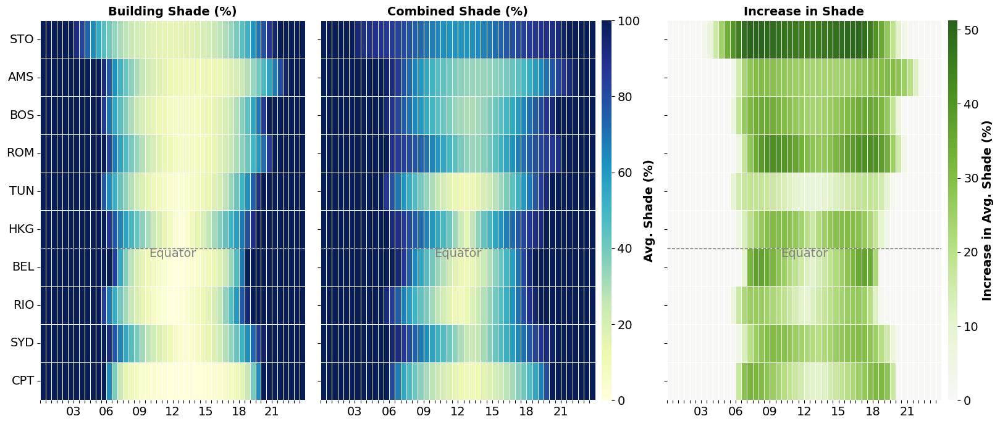

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

# === Plot Settings ===
font_size = 14
tick_label_fontsize = 14
colorbar_fontsize = 14


# Abbreviations
city_abbreviations = {
    "Stockholm": "STO", "Amsterdam": "AMS", "Boston": "BOS", "Rome": "ROM",
    "Tunis": "TUN", "Hong Kong": "HKG", "Belem": "BEL",
    "Rio": "RIO", "Sydney": "SYD", "Cape Town": "CPT"
}

city_latitudes = {
    "STO": 59.3, "AMS": 52.4, "BOS": 42.4, "ROM": 41.9, "TUN": 36.8,
    "HKG": 22.3, "BEL": -1.5, "RIO": -22.9, "SYD": -33.9, "CPT": -33.9
}

def get_latitude_lines(df):
    y_positions = df.index.tolist()
    latitudes = [city_latitudes[c] for c in y_positions]

    def find_closest(target):
        return min(range(len(latitudes)), key=lambda i: abs(latitudes[i] - target))

    return {
        "Equator": find_closest(0),
        # "Tropic of Cancer": find_closest(23.5),
        # "Tropic of Capricorn": find_closest(-23.5)
    }

def sort_by_latitude(df):
    return df.loc[sorted(df.index, key=lambda city: -city_latitudes.get(city, 0))]



# === Safe renaming with fallback ===
def abbreviate_index(df):
    df = df.copy()
    df.index = df.index.astype(str).str.strip()

    # Only apply mapping if all values are full city names
    if all(name in city_abbreviations for name in df.index):
        df.index = df.index.map(city_abbreviations.get)
    return df

def abbreviate_time_labels(labels, step=6):
    return [label[:2] if i % step == 0 else "" for i, label in enumerate(labels)]

building_shade_df = abbreviate_index(building_shade_df)
tree_shade_df = abbreviate_index(tree_shade_df)
shade_diff = tree_shade_df - building_shade_df


building_shade_df = sort_by_latitude(building_shade_df)
tree_shade_df = sort_by_latitude(tree_shade_df)
shade_diff = sort_by_latitude(shade_diff)

# === X-tick labels (every 3 hours) ===
xticks = list(range(len(tree_shade_df.columns)))
xtick_labels = [col if i % 6 == 0 else "" for i, col in enumerate(tree_shade_df.columns)]
xtick_labels = abbreviate_time_labels(tree_shade_df.columns, step=6)
xtick_labels[0] = ""  # remove the first label (e.g., "00:00")


# === Create plot ===
fig, axes = plt.subplots(1, 3, figsize=(20, 8), sharey=True,
                         gridspec_kw={'width_ratios': [0.8, 1, 1], 'wspace': 0.05})

heatmap_kws = dict(vmin=0, vmax=100, linewidths=0.5, cmap="YlGnBu")

# Plot 1: Building shade
sns.heatmap(building_shade_df, ax=axes[0], cbar=False, **heatmap_kws)
axes[0].set_title("Building Shade (%)", fontweight='bold', fontsize=font_size)
# axes[0].set_ylabel("City", fontweight='bold', fontsize=font_size)
axes[0].set_xticks(xticks)
axes[0].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[0].tick_params(axis='x', rotation=0)
axes[0].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[0].set_yticklabels(axes[0].get_yticklabels(), rotation=0, fontsize=tick_label_fontsize)

# Plot 2: Combined shade
sns.heatmap(tree_shade_df, ax=axes[1],
            cbar_kws={'label': 'Avg. Shade (%)', 'aspect': 40, 'pad': 0.02},
            **heatmap_kws)
axes[1].set_title("Combined Shade (%)", fontweight='bold', fontsize=font_size)
axes[1].set_xticks(xticks)
axes[1].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[1].tick_params(axis='x', rotation=0)
axes[1].tick_params(axis='y', labelsize=0)

# Plot 3: Difference (diverging)
sns.heatmap(shade_diff, ax=axes[2],
            cmap="PiYG", center=0,
            cbar_kws={'label': 'Increase in Avg. Shade (%)', 'aspect': 40, 'pad': 0.02},
            linewidths=0.5)
axes[2].set_title("Increase in Shade", fontweight='bold', fontsize=font_size)
axes[2].set_xticks(xticks)
axes[2].set_xticklabels(xtick_labels, fontsize=tick_label_fontsize)
axes[2].tick_params(axis='x', rotation=0)
axes[2].tick_params(axis='y', labelsize=0)

# === Colorbar styling ===
for ax in axes[1:]:
    cb = ax.collections[0].colorbar
    cb.ax.tick_params(labelsize=colorbar_fontsize)
    cb.set_label(cb.ax.get_ylabel(), fontweight='bold', fontsize=colorbar_fontsize)

latitude_lines = get_latitude_lines(tree_shade_df)

for ax in axes:
    for label, y_idx in latitude_lines.items():
        ax.axhline(y=y_idx, color='gray', linestyle='--', linewidth=1)
        ax.text(0.5, y_idx + 0.3, label, transform=ax.get_yaxis_transform(),
                fontsize=14, ha='center', va='bottom', color='gray')

plt.tight_layout()
plt.savefig("../results/figures/250521_shade_comparison_all_cities.png", dpi=600, bbox_inches='tight')
plt.savefig("../results/figures/250521_shade_comparison_all_cities.pdf", dpi=600, bbox_inches='tight')
plt.show()

### Comparison without third row:

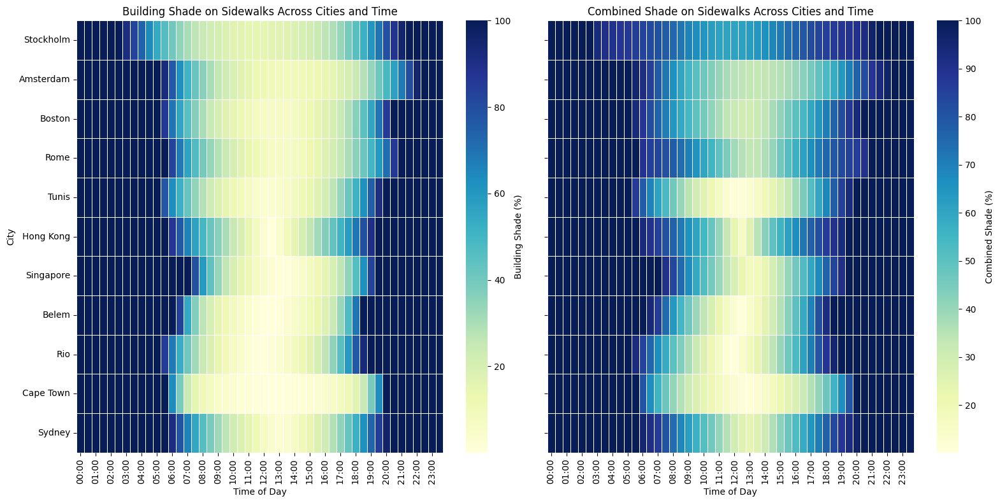

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure with two heatmaps arranged side by side, sharing the y-axis (cities)
fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharey=True)

# Building shade heatmap on the left
sns.heatmap(
    building_shade_df, 
    ax=axes[0], 
    cmap="YlGnBu", 
    cbar_kws={'label': 'Building Shade (%)'},
    linewidths=0.5
)
axes[0].set_title("Building Shade on Sidewalks Across Cities and Time")
axes[0].set_ylabel("City")
axes[0].set_xlabel("Time of Day")

# Tree shade heatmap on the right
sns.heatmap(
    tree_shade_df, 
    ax=axes[1], 
    cmap="YlGnBu", 
    cbar_kws={'label': 'Combined Shade (%)'},
    linewidths=0.5
)
axes[1].set_title("Combined Shade on Sidewalks Across Cities and Time")
axes[1].set_xlabel("Time of Day")
# No need to set the y-label on the right since it's shared

plt.tight_layout()
plt.show()

### Two Cities Only

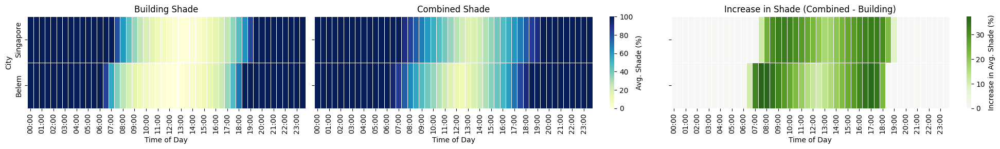

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the comparison cities
cities_to_compare = ["Singapore", "Belem"]

# Filter the DataFrames to include only the comparison cities.
comparison_building = building_shade_df.loc[cities_to_compare]
comparison_tree = tree_shade_df.loc[cities_to_compare]

# Compute the difference between the filtered tree and building shade.
comparison_diff = comparison_tree - comparison_building

# Define a common scale for the building and combined shade heatmaps.
shade_vmin = 0
shade_vmax = 100

# Create a figure with three subplots. Adjust width ratios as needed.
fig, axes = plt.subplots(1, 3, figsize=(20, 3), sharey=True, 
                           gridspec_kw={'width_ratios': [0.8, 1, 1]})

# Plot 1: Building shade heatmap (no colorbar)
sns.heatmap(
    comparison_building,
    ax=axes[0],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar=False,  # remove the colorbar here
    linewidths=0.5
)
axes[0].set_title("Building Shade")
axes[0].set_ylabel("City")
axes[0].set_xlabel("Time of Day")

# Plot 2: Combined (Tree) shade heatmap (with colorbar)
sns.heatmap(
    comparison_tree,
    ax=axes[1],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar_kws={'label': 'Avg. Shade (%)'},
    linewidths=0.5
)
axes[1].set_title("Combined Shade")
axes[1].set_xlabel("Time of Day")

# Plot 3: Difference heatmap (with colorbar)
sns.heatmap(
    comparison_diff,
    ax=axes[2],
    cmap="PiYG",  # diverging colormap for differences
    center=0,         # center the colormap at 0 for the difference plot
    cbar_kws={'label': 'Increase in Avg. Shade (%)'},
    linewidths=0.5
)
axes[2].set_title("Increase in Shade (Combined - Building)")
axes[2].set_xlabel("Time of Day")

plt.tight_layout()
plt.show()

### One city only

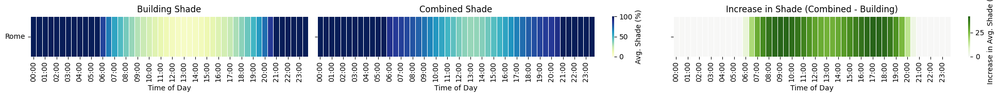

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the comparison cities
cities_to_compare = ["Rome"]

# cities_to_compare = ["Boston"]

# Filter the DataFrames to include only the comparison cities.
comparison_building = building_shade_df.loc[cities_to_compare]
comparison_tree = tree_shade_df.loc[cities_to_compare]

# Compute the difference between the filtered tree and building shade.
comparison_diff = comparison_tree - comparison_building

# Define a common scale for the building and combined shade heatmaps.
shade_vmin = 0
shade_vmax = 100

# Create a figure with three subplots. Adjust width ratios as needed.
fig, axes = plt.subplots(1, 3, figsize=(20, 2), sharey=True, 
                           gridspec_kw={'width_ratios': [0.8, 1, 1]})

# Plot 1: Building shade heatmap (no colorbar)
sns.heatmap(
    comparison_building,
    ax=axes[0],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar=False,  # remove the colorbar here
    linewidths=0.5
)
axes[0].set_title("Building Shade")
# axes[0].set_ylabel("City")
axes[0].set_xlabel("Time of Day")

# Plot 2: Combined (Tree) shade heatmap (with colorbar)
sns.heatmap(
    comparison_tree,
    ax=axes[1],
    cmap="YlGnBu",
    vmin=shade_vmin,
    vmax=shade_vmax,
    cbar_kws={'label': 'Avg. Shade (%)'},
    linewidths=0.5
)
axes[1].set_title("Combined Shade")
axes[1].set_xlabel("Time of Day")

# Plot 3: Difference heatmap (with colorbar)
sns.heatmap(
    comparison_diff,
    ax=axes[2],
    cmap="PiYG",  # diverging colormap for differences
    center=0,         # center the colormap at 0 for the difference plot
    cbar_kws={'label': 'Increase in Avg. Shade (%)'},
    linewidths=0.5
)
axes[2].set_title("Increase in Shade (Combined - Building)")
axes[2].set_xlabel("Time of Day")

for ax in axes:
    ax.tick_params(axis='y', labelrotation=0)

plt.tight_layout()
plt.show()

## Additional Contribution Trees

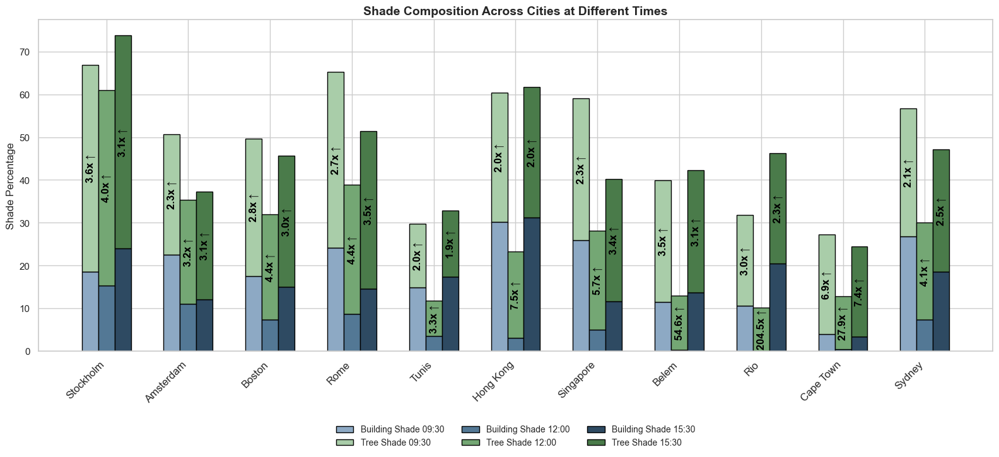

In [19]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.patches import Patch

# Use Seaborn's theme for a modern look
sns.set_theme(style="whitegrid")

# Define the time intervals you want to compare
time_intervals = ["09:30", "12:00", "15:30"]
# Get the column indices for these time labels in the DataFrame
time_indices = [building_shade_df.columns.get_loc(t) for t in time_intervals]

# Prepare data for grouped bar chart
cities = building_shade_df.index.tolist()
x = np.arange(len(cities))  # x positions for cities
bar_width = 0.2             # width of each bar
offsets = np.linspace(-bar_width, bar_width, len(time_intervals))  # Offsets for each time interval

# Define color palettes for building and tree shade components
colors_building = ["#8DA9C4", "#537895", "#2E4A62"]
colors_tree = ["#A9CDA9", "#74A774", "#4A7B4A"]

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(16, 8))

# Plot data for each time interval and annotate multiplier inside the tree bar
for i, (time_idx, time_label) in enumerate(zip(time_indices, time_intervals)):
    # Retrieve the building shade values and compute the additional tree contribution
    building_values = building_shade_df.iloc[:, time_idx]
    tree_values = tree_shade_df.iloc[:, time_idx] - building_shade_df.iloc[:, time_idx]
    
    # Plot the building shade as a bar
    ax.bar(x + offsets[i],
           building_values,
           bar_width,
           color=colors_building[i],
           edgecolor='black')
    
    # Plot the tree shade stacked on top of the building shade
    ax.bar(x + offsets[i],
           tree_values,
           bar_width,
           bottom=building_values,
           color=colors_tree[i],
           edgecolor='black')
    
    # Annotate the multiplier with an increase symbol
    for pos, b, t in zip(x + offsets[i], building_values, tree_values):
        if b > 0:
            multiplier = (b + t) / b  # Total as a multiple of the building shade
            symbol = " ↑" if multiplier > 1 else ""
            y_text = b + t / 2
            ax.text(pos, y_text, f"{multiplier:.1f}x{symbol}",
                    ha='center', va='center',
                    rotation=90, fontweight='bold',
                    color='black')
        else:
            y_text = t / 2
            ax.text(pos, y_text, "N/A",
                    ha='center', va='center',
                    rotation=90, fontweight='bold',
                    color='red')

# Create custom legend entries using Patch so we avoid duplicate legend items
legend_entries = []
for i, time_label in enumerate(time_intervals):
    legend_entries.append(Patch(facecolor=colors_building[i],
                                edgecolor='black',
                                label=f"Building Shade {time_label}"))
    legend_entries.append(Patch(facecolor=colors_tree[i],
                                edgecolor='black',
                                label=f"Tree Shade {time_label}"))

# Place the legend at the bottom outside of the plot area
ax.legend(handles=legend_entries,
          loc='upper center',
          bbox_to_anchor=(0.5, -0.2),
          ncol=3,
          frameon=False,
          fontsize=10)

# Set axis labels, title, and tick parameters for clarity
ax.set_xticks(x)
ax.set_xticklabels(cities, rotation=45, ha='right', fontsize=12)
ax.set_ylabel("Shade Percentage", fontsize=12)
ax.set_title("Shade Composition Across Cities at Different Times", fontsize=14, fontweight='bold')

# Adjust layout to ensure nothing gets cut off (especially the legend)
plt.tight_layout(rect=[0, 0.05, 1, 1])
plt.show()

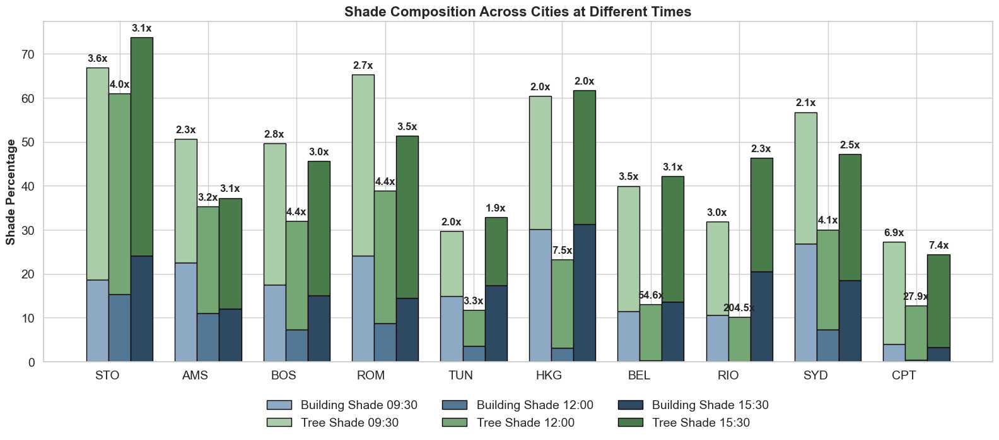

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.patches import Patch

# Theme and settings
sns.set_theme(style="whitegrid")
font_size = 16
label_fontsize = 14
tick_fontsize = 14
annotation_fontsize = 12

# Time intervals
time_intervals = ["09:30", "12:00", "15:30"]
time_indices = [building_shade_df.columns.get_loc(t) for t in time_intervals]
cities = building_shade_df.index.tolist()
x = np.arange(len(cities))

# Wider bars and adjusted offsets
bar_width = 0.25
offsets = np.linspace(-bar_width, bar_width, len(time_intervals))

colors_building = ["#8DA9C4", "#537895", "#2E4A62"]
colors_tree = ["#A9CDA9", "#74A774", "#4A7B4A"]

fig, ax = plt.subplots(figsize=(16, 8))

for i, (time_idx, time_label) in enumerate(zip(time_indices, time_intervals)):
    building_values = building_shade_df.iloc[:, time_idx]
    tree_values = tree_shade_df.iloc[:, time_idx] - building_values

    ax.bar(x + offsets[i], building_values, bar_width,
           color=colors_building[i], edgecolor='black')
    ax.bar(x + offsets[i], tree_values, bar_width,
           bottom=building_values, color=colors_tree[i], edgecolor='black')

    # Horizontal annotations
    for pos, b, t in zip(x + offsets[i], building_values, tree_values):
        if b > 0:
            multiplier = (b + t) / b
            symbol = " ↑" if multiplier > 1 else ""
            y_text = b + t + 1
            ax.text(pos, y_text, f"{multiplier:.1f}x", #{symbol}",
                    ha='center', va='bottom',
                    rotation=0, fontweight='bold',
                    fontsize=annotation_fontsize)
        elif t > 0:
            ax.text(pos, t / 2, "N/A",
                    ha='center', va='center',
                    rotation=0, fontweight='bold',
                    fontsize=annotation_fontsize,
                    color='red')

# Legend closer to plot
legend_entries = []
for i, time_label in enumerate(time_intervals):
    legend_entries.append(Patch(facecolor=colors_building[i], edgecolor='black',
                                label=f"Building Shade {time_label}"))
    legend_entries.append(Patch(facecolor=colors_tree[i], edgecolor='black',
                                label=f"Tree Shade {time_label}"))

ax.legend(handles=legend_entries,
          loc='upper center',
          bbox_to_anchor=(0.5, -0.08),
          ncol=3,
          frameon=False,
          fontsize=label_fontsize)

# Labels and ticks
ax.set_xticks(x)
ax.set_xticklabels(cities, rotation=0, ha='right', fontsize=tick_fontsize)
ax.set_ylabel("Shade Percentage", fontsize=label_fontsize, fontweight='bold')
ax.set_title("Shade Composition Across Cities at Different Times", fontsize=font_size, fontweight='bold')
ax.tick_params(axis='y', labelsize=tick_fontsize)

# Export and layout
plt.tight_layout(rect=[0, 0.1, 1, 1])  # leave room for the legend
plt.savefig("../results/figures/250520_shade_multipliers.png", dpi=600, bbox_inches='tight')
plt.savefig("../results/figures/250520_shade_multipliers.pdf", dpi=600, bbox_inches='tight')
plt.show()

## Maps

In [14]:
import geopandas as gpd
import h3
import h3pandas

gdf = gpd.GeoDataFrame(geometry=gpd.points_from_xy([4.9, 5.0], [52.36, 52.37]), crs="EPSG:4326")
gdf["h3"] = gdf.h3.geo_to_h3(10)
print(gdf)

                   geometry    h3
0  POINT (4.90000 52.36000)  None
1  POINT (5.00000 52.37000)  None


In [19]:
# Prepare data
import pandas as pd
import h3pandas
df = pd.DataFrame({'lat': [50, 51], 'lng': [14, 15]})

In [20]:
resolution = 10
df = df.h3.geo_to_h3(resolution)
df

,lat,lng
h3_10,,
8a1e30973807fff,50,14
8a1e2659c2c7fff,51,15


In [5]:
df = df.h3.h3_to_geo_boundary()
df

,lat,lng,geometry
h3_10,,,
8a1e30973807fff,50,14,"POLYGON ((13.99964 50.00100, 13.99933 50.00037..."
8a1e2659c2c7fff,51,15,"POLYGON ((14.99903 51.00057, 14.99871 50.99995..."


In [7]:
df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [16]:
import h3
import folium

def visualize_hexagons(hexagons, color="red", folium_map=None):
    """
    hexagons is a list of hexcluster. Each hexcluster is a list of hexagons. 
    eg. [[hex1, hex2], [hex3, hex4]]
    """
    polylines = []
    lat = []
    lng = []
    for hex in hexagons:
        polygons = h3.h3_set_to_multi_polygon([hex], geo_json=False)
        # flatten polygons into loops.
        outlines = [loop for polygon in polygons for loop in polygon]
        polyline = [outline + [outline[0]] for outline in outlines][0]
        lat.extend(map(lambda v:v[0],polyline))
        lng.extend(map(lambda v:v[1],polyline))
        polylines.append(polyline)
    
    if folium_map is None:
        m = folium.Map(location=[sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start=13, tiles='cartodbpositron')
    else:
        m = folium_map
    for polyline in polylines:
        my_PolyLine=folium.PolyLine(locations=polyline,weight=8,color=color)
        m.add_child(my_PolyLine)
    return m
    

def visualize_polygon(polyline, color):
    polyline.append(polyline[0])
    lat = [p[0] for p in polyline]
    lng = [p[1] for p in polyline]
    m = folium.Map(location=[sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start=13, tiles='cartodbpositron')
    my_PolyLine=folium.PolyLine(locations=polyline,weight=8,color=color)
    m.add_child(my_PolyLine)
    return m

In [24]:
h3_address = h3.latlng_to_cell(37.3615593, -122.0553238, 9) # lat, lng, hex resolution                                                                                                        
h3_address
# m = visualize_hexagons([h3_address])
# display(m)

'89283470d93ffff'

In [25]:
import h3

import geopandas
# import geodatasets
import contextily as cx
import matplotlib.pyplot as plt


def plot_df(df, column=None, ax=None):
    "Plot based on the `geometry` column of a GeoPandas dataframe"
    df = df.copy()
    df = df.to_crs(epsg=3857)  # web mercator

    if ax is None:
        _, ax = plt.subplots(figsize=(8,8))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    df.plot(
        ax=ax,
        alpha=0.5, edgecolor='k',
        column=column, categorical=True,
        legend=True, legend_kwds={'loc': 'upper left'},
    )
    cx.add_basemap(ax, crs=df.crs, source=cx.providers.CartoDB.Positron)


def plot_shape(shape, ax=None):
    df = geopandas.GeoDataFrame({'geometry': [shape]}, crs='EPSG:4326')
    plot_df(df, ax=ax)


def plot_cells(cells, ax=None):
    shape = h3.cells_to_h3shape(cells)
    plot_shape(shape, ax=ax)


def plot_shape_and_cells(shape, res=9):
    fig, axs = plt.subplots(1,2, figsize=(10,5), sharex=True, sharey=True)
    plot_shape(shape, ax=axs[0])
    plot_cells(h3.h3shape_to_cells(shape, res), ax=axs[1])
    fig.tight_layout()

<LatLngPoly: [3]>


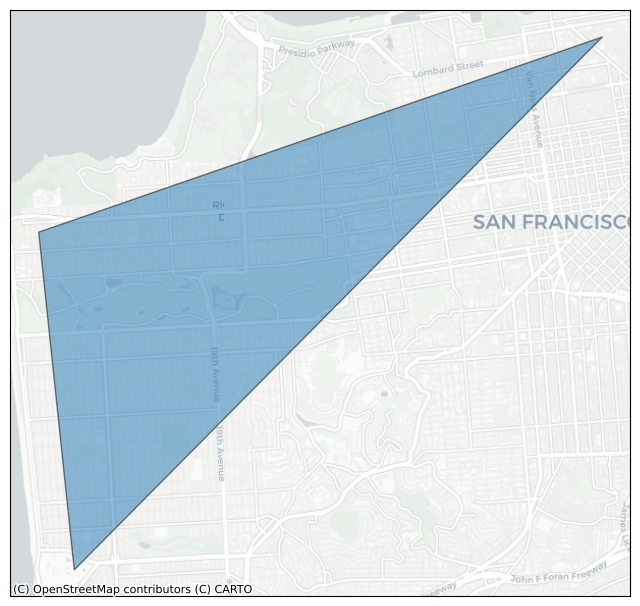

In [26]:
outer = [
    (37.804, -122.412),
    (37.778, -122.507),
    (37.733, -122.501)
]

poly = h3.LatLngPoly(outer)
print(poly)
plot_shape(poly)

<LatLngPoly: [3/(3,)]>


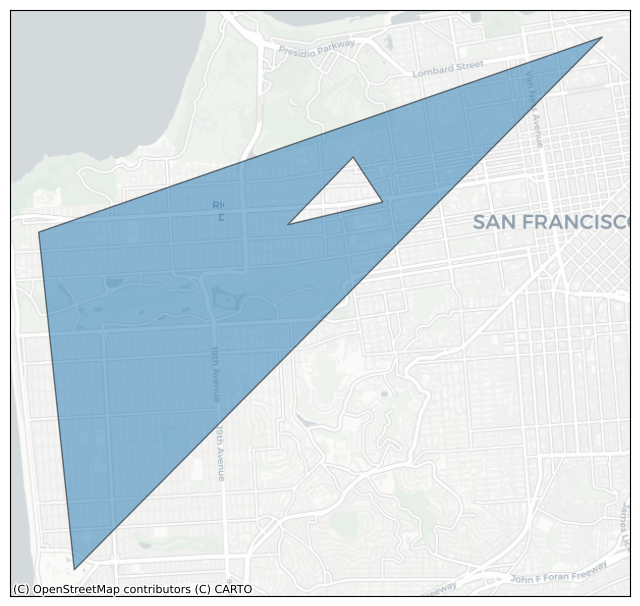

In [27]:
hole1 = [
    (37.782, -122.449),
    (37.779, -122.465),
    (37.788, -122.454),
]

poly = h3.LatLngPoly(outer, hole1)
print(poly)
plot_shape(poly)

<LatLngPoly: [3/(3, 4)]>


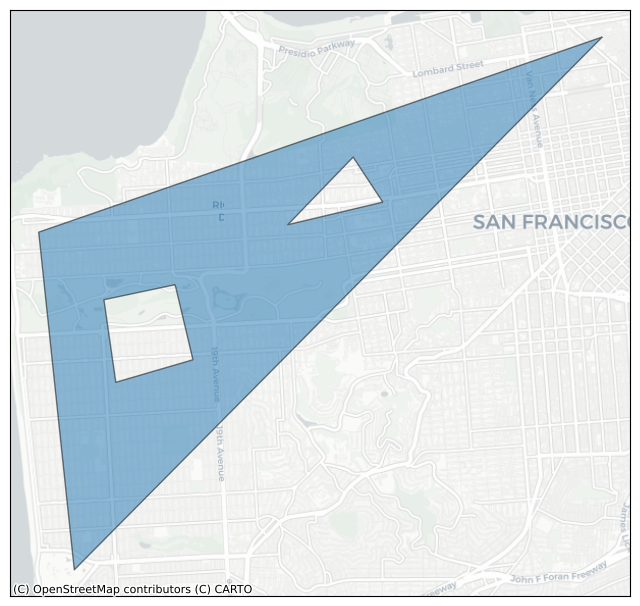

In [28]:
hole2 = [
    (37.771, -122.484),
    (37.761, -122.481),
    (37.758, -122.494),
    (37.769, -122.496),
]

poly = h3.LatLngPoly(outer, hole1, hole2)
print(poly)
plot_shape(poly)

In [29]:
poly = h3.LatLngPoly(outer, hole1, hole2)
poly

<LatLngPoly: [3/(3, 4)]>

In [30]:
poly.outer

((37.804, -122.412), (37.778, -122.507), (37.733, -122.501))

In [31]:
poly.holes

([(37.782, -122.449), (37.779, -122.465), (37.788, -122.454)],
 [(37.771, -122.484),
  (37.761, -122.481),
  (37.758, -122.494),
  (37.769, -122.496)])

In [32]:
d = poly.__geo_interface__
d

{'type': 'Polygon',
 'coordinates': (((-122.412, 37.804),
   (-122.507, 37.778),
   (-122.501, 37.733),
   (-122.412, 37.804)),
  ((-122.449, 37.782),
   (-122.465, 37.779),
   (-122.454, 37.788),
   (-122.449, 37.782)),
  ((-122.484, 37.771),
   (-122.481, 37.761),
   (-122.494, 37.758),
   (-122.496, 37.769),
   (-122.484, 37.771)))}

In [33]:
print(poly.outer)
print(poly.holes)

((37.804, -122.412), (37.778, -122.507), (37.733, -122.501))
([(37.782, -122.449), (37.779, -122.465), (37.788, -122.454)], [(37.771, -122.484), (37.761, -122.481), (37.758, -122.494), (37.769, -122.496)])


In [34]:
h3.geo_to_h3shape(d)

<LatLngPoly: [3/(3, 4)]>

In [35]:
h3.h3shape_to_cells(poly, res=7)

['872830958ffffff', '87283095bffffff', '87283095affffff', '872830829ffffff']

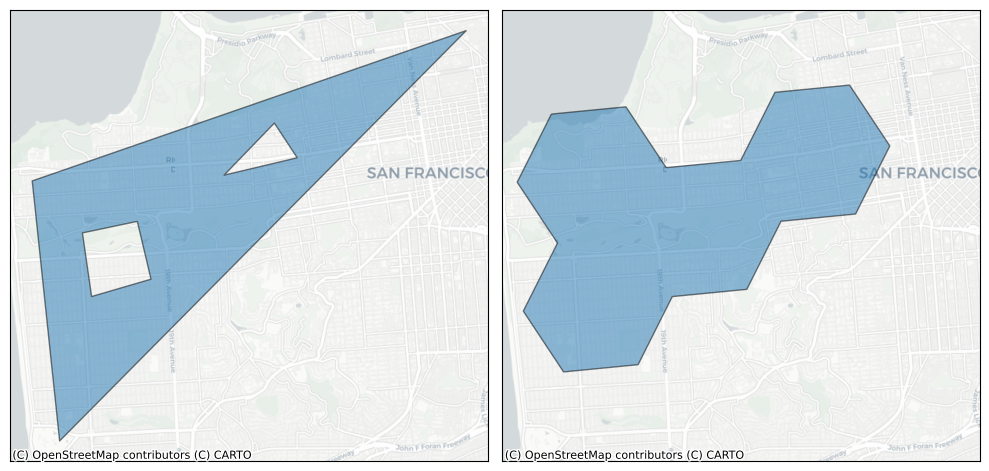

In [36]:
plot_shape_and_cells(poly, 7)

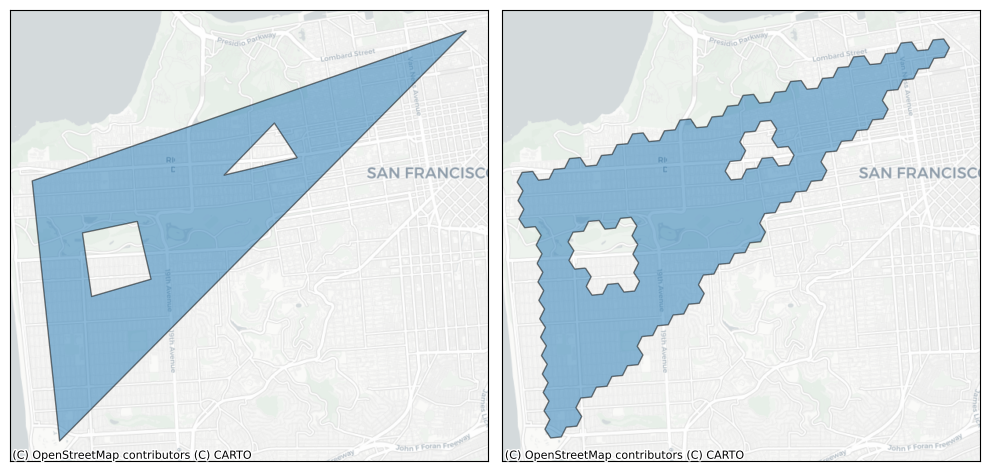

In [37]:
plot_shape_and_cells(poly, 9)

In [38]:
poly1 = h3.LatLngPoly([(37.804, -122.412), (37.778, -122.507), (37.733, -122.501)])
poly2 = h3.LatLngPoly(
    [(37.803, -122.408), (37.736, -122.491), (37.738, -122.380), (37.787, -122.39)],
    [(37.760, -122.441), (37.772, -122.427), (37.773, -122.404), (37.758, -122.401), (37.745, -122.428)]
)
mpoly = h3.LatLngMultiPoly(poly1, poly2)

print(poly1)
print(poly2)
print(mpoly)

<LatLngPoly: [3]>
<LatLngPoly: [4/(5,)]>
<LatLngMultiPoly: [3], [4/(5,)]>


In [39]:
plot_shape(mpoly)

ValueError: Assigning CRS to a GeoDataFrame without a geometry column is not supported. Supply geometry using the 'geometry=' keyword argument, or by providing a DataFrame with column name 'geometry'

In [40]:
cells = h3.h3shape_to_cells(mpoly, res=9)
plot_cells(cells)

ValueError: Assigning CRS to a GeoDataFrame without a geometry column is not supported. Supply geometry using the 'geometry=' keyword argument, or by providing a DataFrame with column name 'geometry'

In [22]:
max_res = 15
list_hex_edge_km = []
list_hex_edge_m = []
list_hex_perimeter_km = []
list_hex_perimeter_m = []
list_hex_area_sqkm = []
list_hex_area_sqm = []

for i in range(0, max_res + 1):
    ekm = h3.edge_length(resolution=i, unit='km')
    em = h3.edge_length(resolution=i, unit='m')
    list_hex_edge_km.append(round(ekm, 3))
    list_hex_edge_m.append(round(em, 3))
    list_hex_perimeter_km.append(round(6 * ekm, 3))
    list_hex_perimeter_m.append(round(6 * em, 3))

    akm = h3.hex_area(resolution=i, unit='km^2')
    am = h3.hex_area(resolution=i, unit='m^2')
    list_hex_area_sqkm.append(round(akm, 3))
    list_hex_area_sqm.append(round(am, 3))

df_meta = pd.DataFrame({"edge_length_km": list_hex_edge_km,
                        "perimeter_km": list_hex_perimeter_km,
                        "area_sqkm": list_hex_area_sqkm,
                        "edge_length_m": list_hex_edge_m,
                        "perimeter_m": list_hex_perimeter_m,
                        "area_sqm": list_hex_area_sqm
                        })

df_meta[["edge_length_km", "perimeter_km", "area_sqkm", 
         "edge_length_m", "perimeter_m", "area_sqm"]]

TypeError: edge_length() got an unexpected keyword argument 'resolution'

<Axes: >

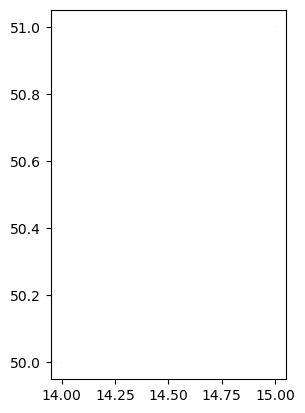

In [12]:
df.plot(color='blue')

In [9]:
df.explore()

In [56]:
import h3pandas
import geopandas as gpd

def aggregate_shade_to_h3(gdf, shade_column, resolution=8):
    """
    Aggregates per-polygon shade values into H3 hexagons using polygon centroids.

    Parameters:
    - gdf: GeoDataFrame with sidewalk polygons and shade column.
    - shade_column: Column name containing shade percentage values.
    - resolution: H3 resolution level (7–10 recommended for urban scale).

    Returns:
    - GeoDataFrame of H3 hexagons with average shade.
    """
    gdf = gdf.copy()

    # Step 1: Clean geometry
    gdf = gdf[gdf.geometry.notnull() & gdf.geometry.is_valid]

    # Step 2: Project to metric CRS for accurate centroid calculation
    gdf_metric = gdf.to_crs(epsg=3857)
    centroids = gdf_metric.geometry.centroid
    centroids_gdf = gpd.GeoDataFrame(gdf[[shade_column]].reset_index(drop=True),
                                     geometry=centroids,
                                     crs="EPSG:3857").to_crs(epsg=4326)

    # Step 3: Assign H3 hex to each centroid
    centroids_gdf["h3"] = centroids_gdf.geometry.h3.geo_to_h3(resolution)

    # Step 4: Aggregate shade values by H3 cell
    h3_agg = centroids_gdf.groupby("h3")[shade_column].mean().reset_index()

    # Step 5: Convert H3 to hex geometry
    hex_gdf = h3_agg.h3.h3_to_geo_boundary()
    return gpd.GeoDataFrame(hex_gdf, geometry="geometry", crs="EPSG:4326")

In [57]:
rome_gdf = combined_city_data["Rome"]
hex_gdf = aggregate_shade_to_h3(rome_gdf, shade_column="shade_availability_index", resolution=8)

# Plot
hex_gdf.plot(column="shade_availability_index", cmap="YlGnBu", legend=True)
plt.title("Rome — Aggregated Shade Availability (H3)")
plt.axis('off')
plt.show()

AttributeError: 'GeoSeries' object has no attribute 'h3'

In [55]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, MultiPolygon
from shapely.geometry.base import BaseGeometry
import h3
import warnings

def plot_shade_map_h3(city, shade_type, time_str, h3_resolution):
    """
    Plot an H3-aggregated shade map for a given city using the specified shade type and time.

    Parameters:
    - city: str, name of the city (must exist in combined_city_data and city_details)
    - shade_type: str, either 'tree' or 'building'
    - time_str: str, in HHMM format (e.g., '1500')
    - h3_resolution: int, H3 resolution (e.g., 8 or 9)
    """
    # --- Validate inputs ---
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")
    if city not in city_details:
        raise ValueError(f"City '{city}' not found in city_details.")
    
    city_gdf = combined_city_data[city]
    date_str = city_details[city]["date"].replace("-", "")
    shade_column = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
    
    if shade_column not in city_gdf.columns:
        raise ValueError(f"Column '{shade_column}' not found in the {city} data.")
    
    # --- Prepare data ---
    gdf = city_gdf.copy()
    gdf["shade_value"] = gdf[shade_column]
    
    # Ensure CRS is WGS84 for H3 (lat/lon)
    if gdf.crs is None or not gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=4326)
    else:
        gdf = gdf.copy()

    print(gdf.columns)
    print(type(gdf))


    # Step 1: Drop obviously bad ones
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]

    # Step 2: Ensure type is explicitly Polygon or MultiPolygon
    gdf = gdf[gdf.geometry.geom_type.isin(["Polygon", "MultiPolygon"])]

    # Step 3: Ensure all are shapely geometries
    gdf = gdf[gdf.geometry.apply(lambda geom: isinstance(geom, BaseGeometry))]

    # Step 4: Buffer fix
    gdf["geometry"] = gdf["geometry"].buffer(0)

    # Step 5: Drop geometries that result in NaNs or are still broken
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf = gdf[gdf.geometry.is_valid]

    # Final safety check
    if gdf.empty:
        raise ValueError("No valid geometries remain after cleaning.")
    
    # --- Get unioned polygon for H3 polyfill ---
    unioned_shape = gdf.geometry.unary_union
    h3_cells = list(h3.polyfill(unioned_shape.__geo_interface__, h3_resolution, geo_json_conformant=True))
    
    # --- Assign polygons to hex cells based on centroid ---
    gdf["hex_id"] = gdf.geometry.centroid.apply(lambda p: h3.geo_to_h3(p.y, p.x, h3_resolution))
    
    # --- Aggregate shade values per hex cell ---
    shade_avg = gdf.groupby("hex_id")["shade_value"].mean().reset_index()
    
    # --- Convert hex cells to geometries ---
    def hex_to_polygon(h):
        boundary = h3.h3_to_geo_boundary(h, geo_json=True)
        return Polygon([(lng, lat) for lat, lng in boundary])
    
    shade_avg["geometry"] = shade_avg["hex_id"].apply(hex_to_polygon)
    hex_gdf = gpd.GeoDataFrame(shade_avg, geometry="geometry", crs="EPSG:4326")
    
    # --- Plot ---
    fig, ax = plt.subplots(1, 1, figsize=(12, 12))
    hex_gdf.plot(
        column="shade_value",
        cmap="RdYlBu",  # diverging colormap
        legend=True,
        ax=ax,
        edgecolor="grey",
        linewidth=0.2
    )
    ax.set_title(f"H3-Aggregated {shade_type.capitalize()} Shade for {city} at {time_str}")
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()

In [56]:
plot_shade_map_h3(
    city="Amsterdam",
    shade_type="tree",
    time_str="1500",
    h3_resolution=8
)

Index(['allowed_turns', 'direction', 'index', 'layer', 'muv', 'road',
       'speed_limit', 'type', 'width', '20240620_building_mean',
       '20240620_building_std', '20240620_building_min',
       '20240620_building_max', '20240620_building_shade_percent_at_0530',
       '20240620_building_shade_percent_at_0600',
       '20240620_building_shade_percent_at_0630',
       '20240620_building_shade_percent_at_0700',
       '20240620_building_shade_percent_at_0730',
       '20240620_building_shade_percent_at_0800',
       '20240620_building_shade_percent_at_0830',
       '20240620_building_shade_percent_at_0900',
       '20240620_building_shade_percent_at_0930',
       '20240620_building_shade_percent_at_1000',
       '20240620_building_shade_percent_at_1030',
       '20240620_building_shade_percent_at_1100',
       '20240620_building_shade_percent_at_1130',
       '20240620_building_shade_percent_at_1200',
       '20240620_building_shade_percent_at_1230',
       '20240620_building_shade_p

TypeError: ufunc 'create_collection' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [61]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import h3
from shapely.geometry import box

def plot_shade_map_h3(city, shade_type, time_str, h3_resolution):
    """
    Plot an H3-aggregated shade map using h3-py v4 API and proper shape workflow.
    """
    # --- Retrieve and prepare data ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or details.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    shade_column = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
    
    if shade_column not in gdf.columns:
        raise ValueError(f"Column '{shade_column}' missing in data.")
    
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["shade_value"] = gdf[shade_column]

    # --- Create bounding box polygon ---
    minx, miny, maxx, maxy = gdf.total_bounds
    bounds_poly = box(minx, miny, maxx, maxy)
    bounds_coords = bounds_poly.__geo_interface__

    # --- Generate H3 cells over the bounding box ---
    h3shape = h3.geo_to_h3shape(bounds_coords)
    h3cells = h3.h3shape_to_cells(h3shape, res=h3_resolution)

    # --- Map each polygon (via centroid) to its H3 cell ---
    gdf["h3_cell"] = gdf.geometry.centroid.apply(
        lambda p: h3.Cell.from_latlng(p.y, p.x, h3_resolution)
    )

    # --- Aggregate shade value per H3 cell ---
    shade_avg = gdf.groupby("h3_cell")["shade_value"].mean()

    # --- Filter h3cells to only those with data ---
    h3cells_with_data = [cell for cell in h3cells if cell in shade_avg.index]
    shade_values = [shade_avg[cell] for cell in h3cells_with_data]

    # --- Plot using h3-py’s built-in shape utilities ---
    fig, ax = plt.subplots(figsize=(12, 12))
    h3shape = h3.cells_to_h3shape(h3cells_with_data)

    # Map shade values to plot
    import matplotlib.cm as cm
    import matplotlib.colors as mcolors

    norm = mcolors.Normalize(vmin=min(shade_values), vmax=max(shade_values))
    cmap = cm.get_cmap("RdYlBu")

    for cell, value in zip(h3cells_with_data, shade_values):
        shape = h3.Cell(cell).boundary()
        poly = [(pt.lng, pt.lat) for pt in shape]
        ax.fill(*zip(*poly), color=cmap(norm(value)), edgecolor="grey", linewidth=0.2)

    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    fig.colorbar(sm, ax=ax, label="Shade %")

    ax.set_title(f"H3 Aggregated {shade_type.capitalize()} Shade for {city} at {time_str}")
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()

In [62]:
plot_shade_map_h3("Amsterdam", "tree", "1500", 7)

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/1114020580.py:36: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(


AttributeError: module 'h3' has no attribute 'Cell'

In [63]:
import geopandas as gpd
from shapely.geometry import box
from h3.latlng import LatLng, LatLngPoly
from h3.h3shape import geo_to_h3shape, h3shape_to_cells, cells_to_h3shape
import matplotlib.pyplot as plt

def latlng_from_bounds(bounds):
    minx, miny, maxx, maxy = bounds
    # return LatLngPoly with clockwise ring (lat, lng)
    ring = [
        LatLng(miny, minx),
        LatLng(miny, maxx),
        LatLng(maxy, maxx),
        LatLng(maxy, minx),
        LatLng(miny, minx)  # close the loop
    ]
    return LatLngPoly(outer=ring)

# Example: get polygon from GeoDataFrame
gdf = combined_city_data["Amsterdam"].to_crs("EPSG:4326")
poly = latlng_from_bounds(gdf.total_bounds)

# Convert to H3 shape
h3shape = geo_to_h3shape(poly)

# Get H3 cells at desired resolution
cells = h3shape_to_cells(h3shape, res=7)

# Plot shape + cells (assuming these helper functions exist)
def plot_shape(shape, ax=None):
    import geopandas as gpd
    df = gpd.GeoDataFrame({'geometry': [shape]}, crs='EPSG:4326')
    df = df.to_crs(epsg=3857)
    if ax is None:
        _, ax = plt.subplots(figsize=(8,8))
    df.plot(ax=ax, alpha=0.5, edgecolor='k')
    return ax

def plot_cells(cells, ax=None):
    shape = cells_to_h3shape(cells)
    return plot_shape(shape, ax=ax)

# Plot both
fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharex=True, sharey=True)
plot_shape(poly, ax=axs[0])
plot_cells(cells, ax=axs[1])
axs[0].set_title("LatLngPoly")
axs[1].set_title("H3 Cells")
fig.tight_layout()
plt.show()

ModuleNotFoundError: No module named 'h3.latlng'

In [66]:
import h3
import geopandas as gpd
from shapely.geometry import box
import matplotlib.pyplot as plt

def plot_df(df, column=None, ax=None):
    df = df.to_crs(epsg=3857)
    if ax is None:
        _, ax = plt.subplots(figsize=(8,8))
    df.plot(
        ax=ax, alpha=0.5, edgecolor='k',
        column=column, categorical=True,
        legend=True, legend_kwds={'loc': 'upper left'},
    )
    cx.add_basemap(ax, crs=df.crs, source=cx.providers.CartoDB.Positron)

def plot_shape(shape, ax=None):
    gdf = gpd.GeoDataFrame({'geometry': [shape]}, crs='EPSG:4326')
    plot_df(gdf, ax=ax)

def plot_cells(cells, ax=None):
    shape = h3.cells_to_h3shape(cells)
    plot_shape(shape, ax=ax)

def plot_shape_and_cells(shape, res=8):
    fig, axs = plt.subplots(1,2, figsize=(12,6), sharex=True, sharey=True)
    plot_shape(shape, ax=axs[0])
    plot_cells(h3.h3shape_to_cells(shape, res), ax=axs[1])
    axs[0].set_title("LatLngPoly")
    axs[1].set_title(f"H3 Cells (res={res})")
    fig.tight_layout()
    plt.show()

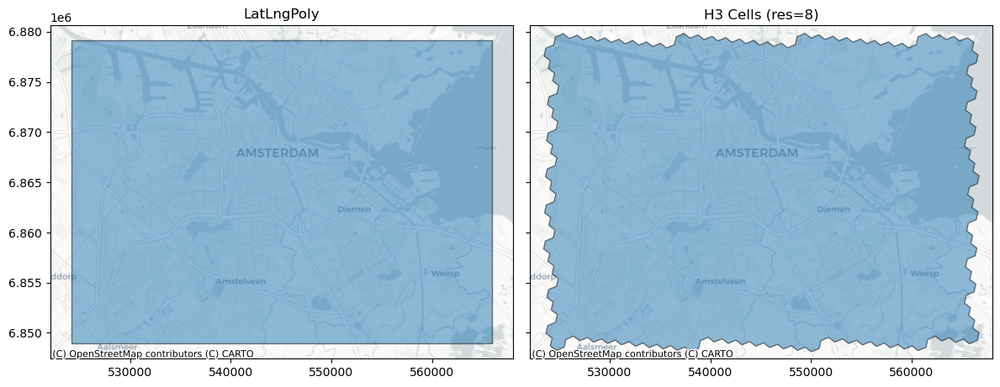

In [67]:
# Example with a bounding box from a GeoDataFrame
gdf = combined_city_data["Amsterdam"].to_crs("EPSG:4326")
bounds = gdf.total_bounds  # [minx, miny, maxx, maxy]

# Define polygon as list of (lat, lng) tuples (clockwise)
outer = [
    (bounds[1], bounds[0]),  # miny, minx
    (bounds[1], bounds[2]),  # miny, maxx
    (bounds[3], bounds[2]),  # maxy, maxx
    (bounds[3], bounds[0]),  # maxy, minx
    (bounds[1], bounds[0])   # close loop
]

poly = h3.LatLngPoly(outer=outer)

# Plot both the shape and the H3 cells
plot_shape_and_cells(poly, res=8)

In [75]:
def aggregate_shade_to_h3(gdf, shade_column, res):
    # Ensure correct projection for H3 (lat/lng)
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["centroid"] = gdf.geometry.centroid
    gdf["h3_cell"] = gdf["centroid"].apply(
        lambda p: h3.latlng_to_cell(p.y, p.x, res)
    )

    # Aggregate mean shade per cell
    agg = gdf.groupby("h3_cell")[shade_column].mean().reset_index()

    # Convert each h3 index to polygon geometry
    agg["geometry"] = agg["h3_cell"].apply(
        lambda cell: h3.cells_to_h3shape([cell])
    )
    
    # Flatten from shapely multipolygon to polygon if needed
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
    
    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326")
    return hex_gdf

In [73]:
def plot_h3_shade(hex_gdf, shade_column):
    hex_gdf = hex_gdf.to_crs(epsg=3857)
    fig, ax = plt.subplots(figsize=(10,10))
    hex_gdf.plot(
        column=shade_column,
        cmap="RdYlBu",
        legend=True,
        edgecolor="grey",
        linewidth=0.2,
        ax=ax
    )
    import contextily as cx
    cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/3332189708.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid


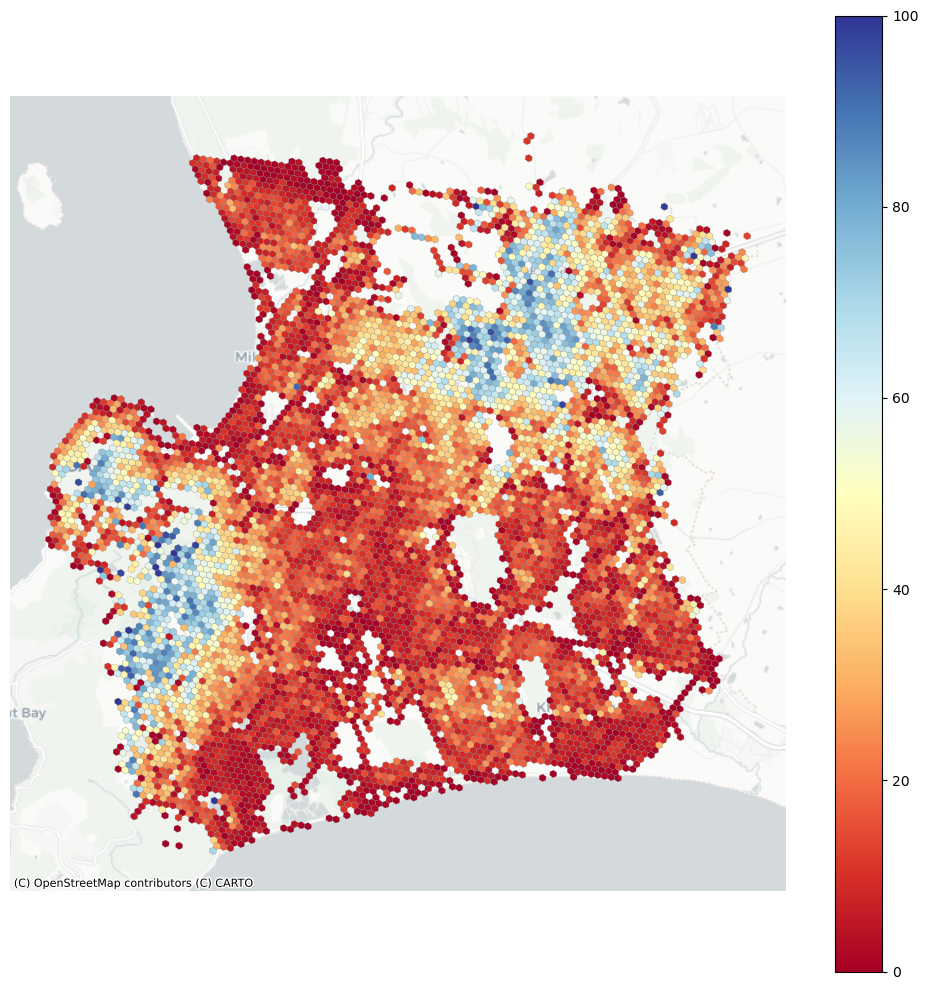

In [83]:
city = "Cape Town"
shade_column = "20241221_tree_shade_percent_at_1500"
res = 9

gdf = combined_city_data[city]
hex_shade = aggregate_shade_to_h3(gdf, shade_column, res)
plot_h3_shade(hex_shade, shade_column)

In [91]:
import geopandas as gpd
import matplotlib.pyplot as plt
import h3
import contextily as cx

def plot_shade_map_h3(city, shade_type, time_str, h3_resolution):
    """
    Aggregates and plots shade values per H3 cell for a given city, shade type, and time.

    Parameters:
    - city: str — key from combined_city_data
    - shade_type: str — "tree" or "building"
    - time_str: str — in HHMM format, e.g., "1500"
    - h3_resolution: int — H3 resolution (e.g., 7–10)
    """
    # --- Validate and prepare ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    shade_column = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
    
    if shade_column not in gdf.columns:
        raise ValueError(f"Column '{shade_column}' not found in {city} data.")

    # --- Ensure lat/lon CRS and clean ---
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    
    # --- Assign H3 cells based on centroid ---
    gdf["centroid"] = gdf.geometry.centroid
    gdf["h3_cell"] = gdf["centroid"].apply(
        lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution)
    )

    # --- Aggregate mean shade per cell ---
    agg = gdf.groupby("h3_cell")[shade_column].mean().reset_index()

    # --- Convert H3 cell indices to polygons ---
    agg["geometry"] = agg["h3_cell"].apply(
        lambda cell: h3.cells_to_h3shape([cell])
    )
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326")

    # --- Plot ---
    hex_gdf = hex_gdf.to_crs(epsg=3857)
    fig, ax = plt.subplots(figsize=(10, 10))
    hex_gdf.plot(
        column=shade_column,
        cmap="YlGnBu",
        legend=True,
        edgecolor="grey",
        linewidth=0.2,
        ax=ax
    )
    cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
    ax.set_title(f"{city} | {shade_type.capitalize()} Shade at {time_str} | H3 res {h3_resolution}")
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2217461076.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid


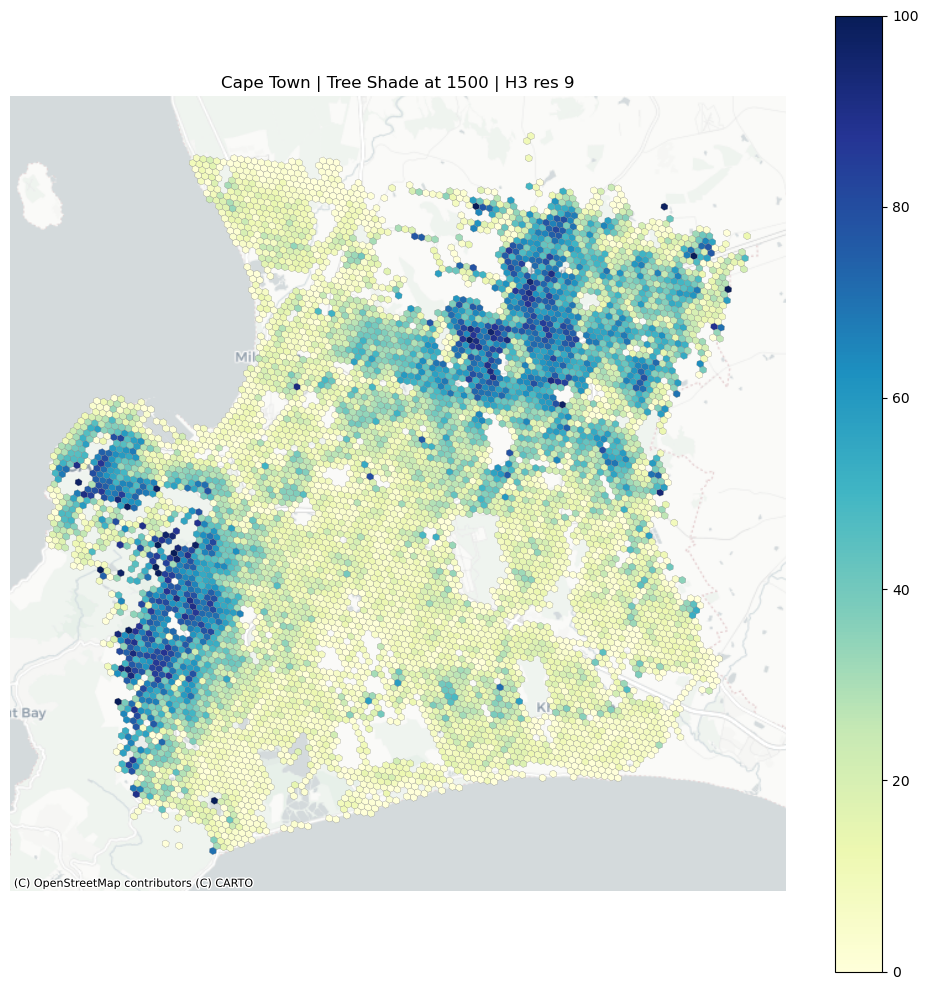

In [92]:
plot_shade_map_h3(
    city="Cape Town",
    shade_type="tree",
    time_str="1500",
    h3_resolution=9
)

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2217461076.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid


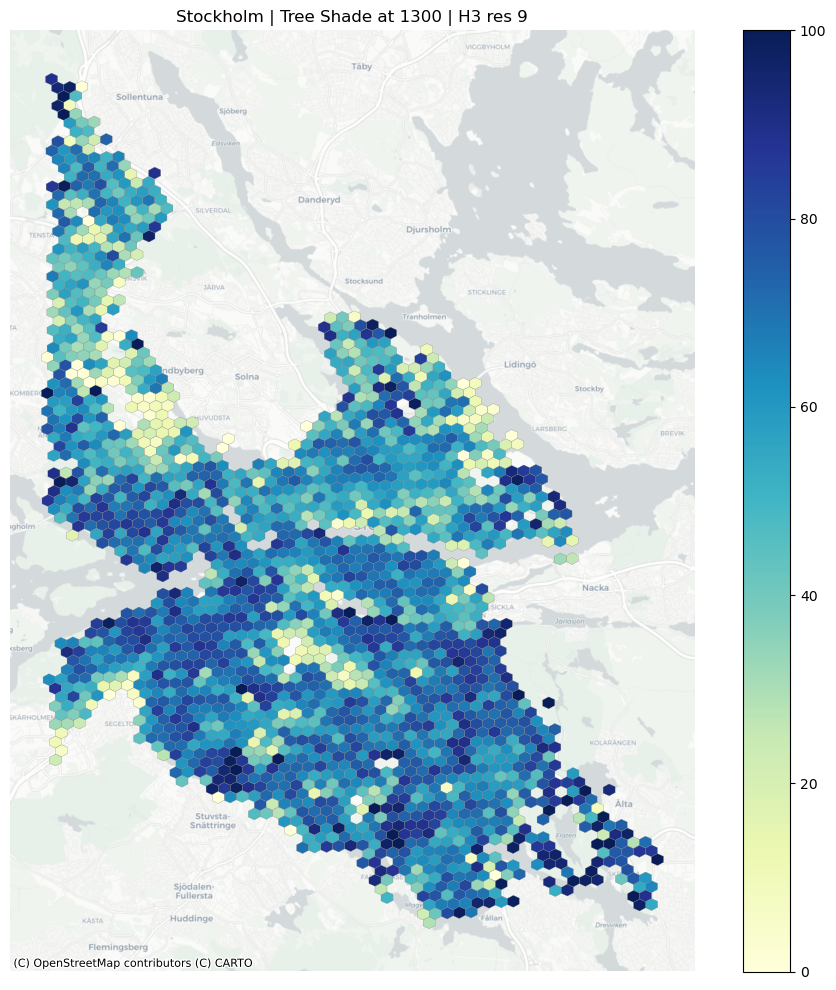

In [93]:
plot_shade_map_h3(
    city="Stockholm",
    shade_type="tree",
    time_str="1300",
    h3_resolution=9
)

In [100]:
import geopandas as gpd
import matplotlib.pyplot as plt
import h3
import contextily as cx
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def plot_shade_comparison_h3(city, time_str, h3_resolution):
    """
    Compare tree and building shade in a city at a given time using H3 aggregation.
    
    Parameters:
    - city: str, name of the city in combined_city_data
    - time_str: str, time in HHMM format (e.g. "1500")
    - h3_resolution: int, H3 resolution (e.g. 7–10)
    """
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    
    for shade_type in ["tree", "building"]:
        col = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
        if col not in gdf.columns:
            raise ValueError(f"Column '{col}' missing in data.")
    
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["centroid"] = gdf.geometry.centroid
    gdf["h3_cell"] = gdf["centroid"].apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate both tree and building shade
    shade_columns = {
        "Tree Shade": f"{date_str}_tree_shade_percent_at_{time_str}",
        "Building Shade": f"{date_str}_building_shade_percent_at_{time_str}"
    }

    hex_frames = []
    for label, col in shade_columns.items():
        agg = gdf.groupby("h3_cell")[col].mean().reset_index()
        agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
        agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
        agg["label"] = label
        agg = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326")
        hex_frames.append(agg)

    # Combine both dataframes
    hex_gdf = pd.concat(hex_frames)
    hex_gdf = hex_gdf.to_crs(epsg=3857)

    # Color mapping
    all_values = pd.concat([
        hex_gdf.loc[hex_gdf["label"] == "Building Shade", shade_columns["Building Shade"]],
        hex_gdf.loc[hex_gdf["label"] == "Tree Shade", shade_columns["Tree Shade"]]
    ])
    vmin, vmax = all_values.min(), all_values.max()
    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = cm.get_cmap("YlGnBu")

    # Plot
    fig, axs = plt.subplots(1, 2, figsize=(14, 8), sharex=True, sharey=True)

    for ax, label in zip(axs, ["Building Shade", "Tree Shade"]):
        df = hex_gdf[hex_gdf["label"] == label]
        column = shade_columns[label]
        df.plot(
            column=column,
            cmap=cmap,
            norm=norm,
            ax=ax,
            edgecolor="grey",
            linewidth=0.2
        )
        cx.add_basemap(ax, crs=df.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(f"{label}", fontsize=14)
        ax.set_axis_off()

    # Shared colorbar
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    cbar = fig.colorbar(sm, ax=axs, orientation="vertical", fraction=0.03, pad=0.02)
    cbar.set_label("Shade Percentage", fontsize=12)

    fig.suptitle(f"{city} | Shade Comparison at {time_str} (H3 res {h3_resolution})", fontsize=16)
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2523676945.py:30: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2523676945.py:59: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("YlGnBu")
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2523676945.py:85: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


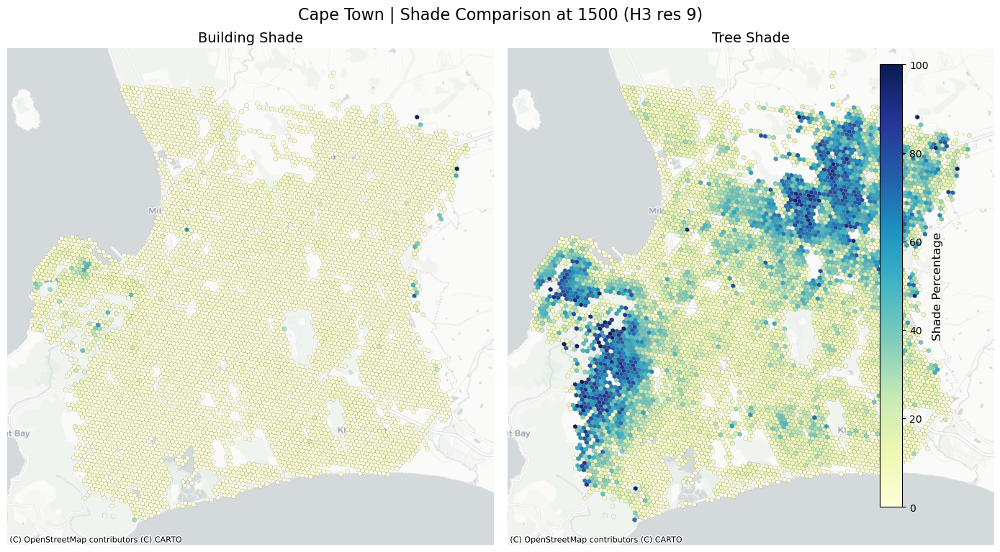

In [101]:
plot_shade_comparison_h3(
    city="Cape Town",
    time_str="1500",
    h3_resolution=9
)

In [103]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import contextily as cx
import pandas as pd
import h3
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_shade_comparison_h3_with_difference(city, time_str, h3_resolution):
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError(f"Shade columns not found in data for {city}.")

    # Prepare and convert to WGS84
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["centroid"] = gdf.geometry.centroid
    gdf["h3_cell"] = gdf["centroid"].apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate
    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col]].mean().reset_index()
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
    agg["difference"] = agg[tree_col] - agg[bldg_col]  # tree - building

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # Set up figure
    fig, axs = plt.subplots(1, 3, figsize=(20, 8), sharex=True, sharey=True)

    # Common bounds
    shade_min = hex_gdf[[tree_col, bldg_col]].min().min()
    shade_max = hex_gdf[[tree_col, bldg_col]].max().max()
    shade_norm = mcolors.Normalize(vmin=shade_min, vmax=shade_max)
    shade_cmap = cm.get_cmap("YlGnBu")

    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)
    diff_cmap = cm.get_cmap("PiYG")

    titles = ["Building Shade", "Combined Shade", "Tree – Building Difference"]
    columns = [bldg_col, tree_col, "difference"]
    cmaps = [shade_cmap, shade_cmap, diff_cmap]
    norms = [shade_norm, shade_norm, diff_norm]

    for ax, title, column, cmap, norm in zip(axs, titles, columns, cmaps, norms):
        hex_gdf.plot(
            column=column,
            cmap=cmap,
            norm=norm,
            edgecolor="grey",
            linewidth=0.2,
            ax=ax
        )
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(title, fontsize=14)
        ax.set_axis_off()

    # Add shared colorbar (for first two plots)
    divider = make_axes_locatable(axs[1])
    cax = divider.append_axes("right", size="3%", pad=0.1)
    sm = cm.ScalarMappable(norm=shade_norm, cmap=shade_cmap)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.set_label("Shade %", fontsize=12)

    # Add separate colorbar for difference
    divider_diff = make_axes_locatable(axs[2])
    cax_diff = divider_diff.append_axes("right", size="3%", pad=0.1)
    sm_diff = cm.ScalarMappable(norm=diff_norm, cmap=diff_cmap)
    cbar_diff = fig.colorbar(sm_diff, cax=cax_diff)
    cbar_diff.set_label("Tree – Building", fontsize=12)

    fig.suptitle(f"{city} | H3 Shade Comparison at {time_str} (res={h3_resolution})", fontsize=18)
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:44: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  shade_cmap = cm.get_cmap("YlGnBu")
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  diff_cmap = cm.get_cmap("PiYG")


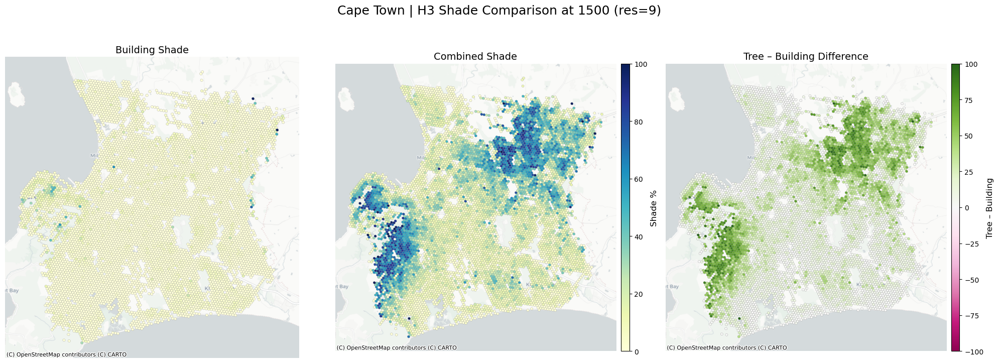

In [ ]:
plot_shade_comparison_h3_with_difference(
    city="Cape Town",
    time_str="1500",
    h3_resolution=9
)

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:44: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  shade_cmap = cm.get_cmap("YlGnBu")
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2310580566.py:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  diff_cmap = cm.get_cmap("PiYG")


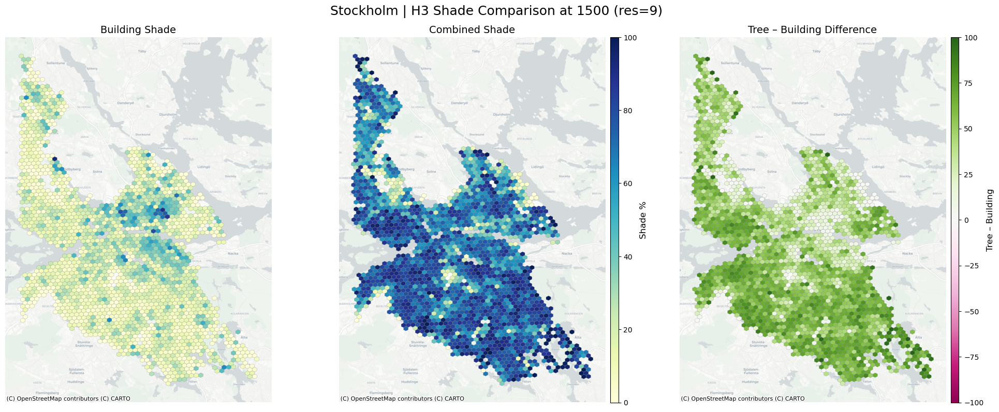

In [105]:
plot_shade_comparison_h3_with_difference(
    city="Stockholm",
    time_str="1500",
    h3_resolution=9
)

In [106]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import contextily as cx
import pandas as pd
import h3
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_shade_comparison_h3_with_difference(city, time_str, h3_resolution):
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")

    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    # Prepare data
    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate shade values
    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col]].mean().reset_index()
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
    agg["difference"] = agg[tree_col] - agg[bldg_col]

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # Colormaps and normalization
    shade_norm = mcolors.Normalize(vmin=hex_gdf[[tree_col, bldg_col]].min().min(),
                                    vmax=hex_gdf[[tree_col, bldg_col]].max().max())
    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)

    columns = [bldg_col, tree_col, "difference"]
    titles = ["Building Shade", "Tree Shade", "Tree – Building Difference"]
    cmaps = [cm.YlGnBu, cm.YlGnBu, cm.PiYG]
    norms = [shade_norm, shade_norm, diff_norm]

    # Plot setup
    fig, axs = plt.subplots(1, 3, figsize=(20, 8), sharex=True, sharey=True)

    for ax, title, col, cmap, norm in zip(axs, titles, columns, cmaps, norms):
        hex_gdf.plot(column=col, cmap=cmap, norm=norm,
                     edgecolor="grey", linewidth=0.2, ax=ax)
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(title, fontsize=14)
        ax.set_axis_off()

    # Colorbars
    for ax, norm, cmap, label in zip([axs[1], axs[2]],
                                     [shade_norm, diff_norm],
                                     [cm.YlGnBu, cm.PiYG],
                                     ["Shade %", "Tree – Building"]):
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3%", pad=0.1)
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.set_label(label, fontsize=12)

    fig.suptitle(f"{city} | H3 Shade Comparison at {time_str} (res={h3_resolution})", fontsize=18)
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/969694706.py:25: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))


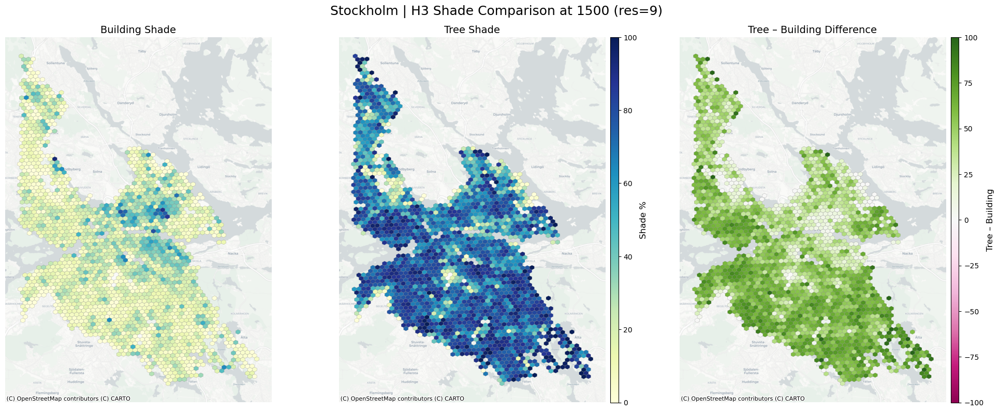

In [107]:
plot_shade_comparison_h3_with_difference(
    city="Stockholm",
    time_str="1500",
    h3_resolution=9
)

In [118]:
def plot_shade_comparison_h3_with_metric(
    city, time_str, h3_resolution,
    comparison_metric="difference",  # or "diversity"
    style=None
):
    import geopandas as gpd
    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import matplotlib.colors as mcolors
    import contextily as cx
    import pandas as pd
    import h3
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import numpy as np

    if style is None:
        style = {
            "suptitle": {"fontsize": 18, "fontweight": "bold"},
            "axtitle": {"fontsize": 14, "fontweight": "normal"},
            "colorbar": {"fontsize": 11},
            "colorbar_label": {"fontsize": 12, "fontweight": "normal"}
        }

    # --- Load and prepare data ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # --- Aggregation ---
    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col]].agg(["mean", "std"]).reset_index()
    agg.columns = ["h3_cell", tree_col, bldg_col, "tree_std", "bldg_std"]
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
    
    # --- Metric for third map ---
    if comparison_metric == "difference":
        agg["metric"] = agg[tree_col] - agg[bldg_col]
        metric_title = "Tree – Building Difference"
        metric_cmap = cm.get_cmap("coolwarm")
        vmax = abs(agg["metric"]).max()
        metric_norm = mcolors.TwoSlopeNorm(vmin=-vmax, vcenter=0, vmax=vmax)
        metric_label = "Difference (%)"
    elif comparison_metric == "diversity":
        agg["metric"] = agg[["tree_std", "bldg_std"]].mean(axis=1)
        metric_title = "Shade Diversity"
        metric_cmap = cm.get_cmap("cividis")
        metric_norm = mcolors.Normalize(vmin=agg["metric"].min(), vmax=agg["metric"].max())
        metric_label = "Std. Dev. of Shade (%)"
    else:
        raise ValueError("Invalid comparison_metric. Choose 'difference' or 'diversity'.")

    # --- Final GeoDataFrame ---
    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # --- Plotting ---
    fig, axs = plt.subplots(1, 3, figsize=(20, 7), sharex=True, sharey=True)
    
    columns = [bldg_col, tree_col, "metric"]
    titles = ["Building Shade", "Tree Shade", metric_title]
    cmaps = [cm.get_cmap("YlGnBu"), cm.get_cmap("YlGnBu"), metric_cmap]
    norms = [
        mcolors.Normalize(vmin=hex_gdf[[tree_col, bldg_col]].min().min(),
                          vmax=hex_gdf[[tree_col, bldg_col]].max().max()),
        mcolors.Normalize(vmin=hex_gdf[[tree_col, bldg_col]].min().min(),
                          vmax=hex_gdf[[tree_col, bldg_col]].max().max()),
        metric_norm
    ]

    for ax, col, title, cmap, norm in zip(axs, columns, titles, cmaps, norms):
        hex_gdf.plot(column=col, cmap=cmap, norm=norm,
                     edgecolor="grey", linewidth=0.2, ax=ax)
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(title, **style["axtitle"])
        ax.set_axis_off()

    # --- Colorbars ---
    for ax, cmap, norm, label in zip([axs[1], axs[2]],
                                     [cmaps[0], cmaps[2]],
                                     [norms[0], norms[2]],
                                     ["Shade (%)", metric_label]):
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="3%", pad=0.1)
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        cbar = fig.colorbar(sm, cax=cax)
        cbar.ax.tick_params(labelsize=style["colorbar"]["fontsize"])
        cbar.set_label(label, **style["colorbar_label"])

    # --- Title ---
    fig.suptitle(f"{city} | H3 Shade Comparison at {time_str} (res={h3_resolution})", **style["suptitle"])
    plt.tight_layout()
    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/376322567.py:38: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/376322567.py:57: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  metric_cmap = cm.get_cmap("cividis")
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/376322567.py:71: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cma

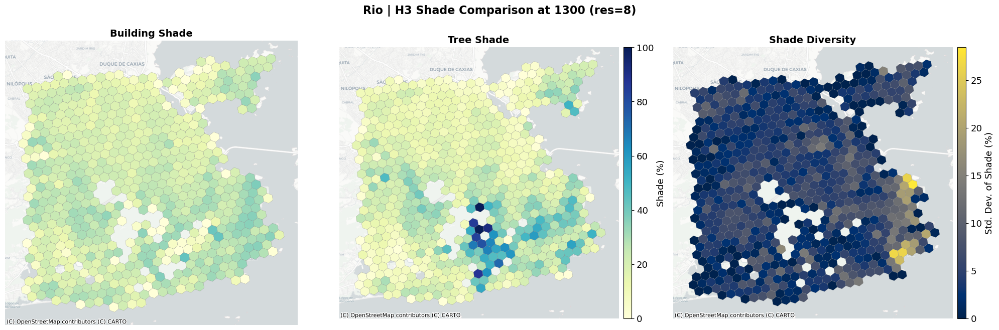

In [121]:
plot_shade_comparison_h3_with_metric(
    city="Rio",
    time_str="1300",
    h3_resolution=8,
    comparison_metric="diversity",  # or "difference"
    style={
        "suptitle": {"fontsize": 16, "fontweight": "bold"},
        "axtitle": {"fontsize": 14, "fontweight": "bold"},
        "colorbar": {"fontsize": 13},
        "colorbar_label": {"fontsize": 13, "fontweight": "normal"}
    }
)

In [138]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import contextily as cx
import pandas as pd
import h3
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np

def plot_shade_comparison_4panel_h3(
    city, time_str, h3_resolution,
    style=None,
    label_panels=True,
    export_path=None,
    export_dpi=300
):
    # --- Style defaults ---
    if style is None:
        style = {
            "axtitle": {"fontsize": 11, "fontweight": "normal"},
            "colorbar": {"fontsize": 9},
            "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
            "label_font": {"fontsize": 11, "fontweight": "bold"}
        }

    # --- Load + preprocess ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")
    
    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # --- Aggregation ---
    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col]].agg(["mean", "std"]).reset_index()
    agg.columns = ["h3_cell", tree_col, bldg_col, "tree_std", "bldg_std"]
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)
    agg["difference"] = agg[tree_col] - agg[bldg_col]
    agg["diversity"] = agg[["tree_std", "bldg_std"]].mean(axis=1)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # --- Layout setup ---
    fig, axs = plt.subplots(2, 2, figsize=(15, 20), sharex=True, sharey=True)
    axs = axs.flatten()

    panels = [
        {"col": bldg_col, "title": "Building Shade", "cmap": cm.YlGnBu},
        {"col": tree_col, "title": "Combined Shade", "cmap": cm.YlGnBu},
        {"col": "difference", "title": "Tree – Building", "cmap": cm.PiYG},
        {"col": "diversity", "title": "Shade Diversity", "cmap": cm.Purples},
    ]

    # --- Normalization ---
    abs_min = hex_gdf[[tree_col, bldg_col]].min().min()
    abs_max = hex_gdf[[tree_col, bldg_col]].max().max()
    shade_norm = mcolors.Normalize(vmin=abs_min, vmax=abs_max)

    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)

    div_min, div_max = hex_gdf["diversity"].min(), hex_gdf["diversity"].max()
    div_norm = mcolors.Normalize(vmin=div_min, vmax=div_max)

    norms = [shade_norm, shade_norm, diff_norm, div_norm]

    # --- Plot each panel ---
    for i, (ax, panel, norm) in enumerate(zip(axs, panels, norms)):
        hex_gdf.plot(
            column=panel["col"],
            cmap=panel["cmap"],
            norm=norm,
            edgecolor="grey",
            linewidth=0.2,
            ax=ax
        )
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(panel["title"], **style["axtitle"])
        ax.set_axis_off()

        # Panel label (a–d)
        if label_panels:
            ax.text(
                0.02, 0.95,
                f"({chr(97 + i)})",
                transform=ax.transAxes,
                verticalalignment='top',
                **style["label_font"]
            )

    # --- Colorbars below each subplot ---
    for ax, panel, norm, cmap, label in zip(axs, panels, norms,
                                            [p["cmap"] for p in panels],
                                            ["Shade %", "Shade %", "Difference (%)", "Std. Dev. (%)"]):
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("bottom", size="5%", pad=0.3)
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
        cbar.ax.tick_params(labelsize=style["colorbar"]["fontsize"])
        cbar.set_label(label, **style["colorbar_label"])

    # --- Finalize layout ---
    plt.tight_layout(rect=[0, 0.03, 1, 0.97])

    if export_path:
        fig.savefig(export_path, dpi=export_dpi, bbox_inches="tight")

    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2183922229.py:41: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))


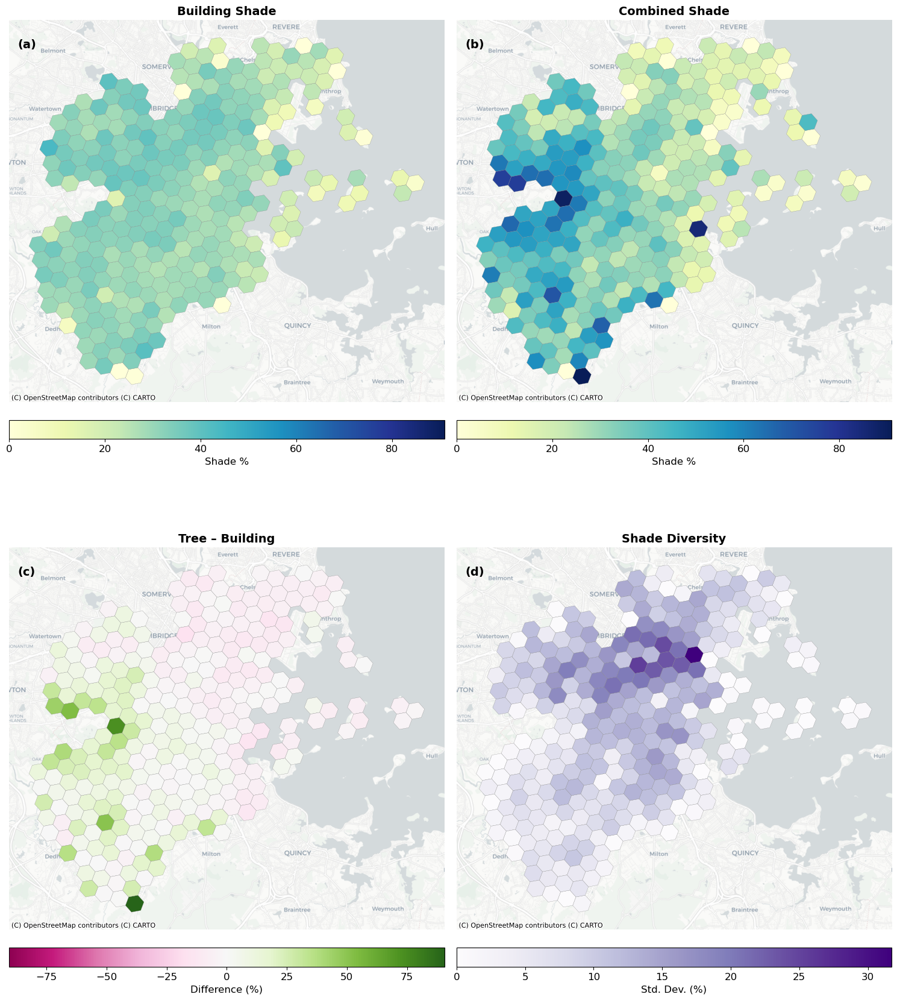

In [139]:
plot_shade_comparison_4panel_h3(
    city="Boston",
    time_str="1200",
    h3_resolution=8,
    style={
        "axtitle": {"fontsize": 14, "fontweight": "bold"},
        "colorbar": {"fontsize": 12},
        "colorbar_label": {"fontsize": 12, "fontweight": "normal"},
        "label_font": {"fontsize": 14, "fontweight": "bold"}
    },
    export_path="../results/figures/shade_4panel_ct1500.pdf",
    export_dpi=300
)

In [179]:
def plot_shade_comparison_4panel_h3(
    city,
    time_str,
    h3_resolution,
    style=None,
    label_panels=True,
    export_path=None,
    export_dpi=300,
    layout_params=None,
    autosize_from_gdf=True,
    preview_layout=False
):
    import geopandas as gpd
    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import matplotlib.colors as mcolors
    import contextily as cx
    import pandas as pd
    import h3
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import numpy as np

    if style is None:
        style = {
            "axtitle": {"fontsize": 11, "fontweight": "normal"},
            "colorbar": {"fontsize": 9},
            "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
            "label_font": {"fontsize": 11, "fontweight": "bold"}
        }

    if layout_params is None:
        layout_params = {
            "rect": [0, 0.03, 1, 0.97],
            "pad": 1.0,
            "h_pad": 0.8,
            "w_pad": 0.8
        }

    # --- Load + preprocess ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")

    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # --- Aggregation with pre-computed difference ---
    gdf["difference"] = gdf[tree_col] - gdf[bldg_col]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col, "difference"]].mean().reset_index()
    agg["tree_std"] = gdf.groupby("h3_cell")[tree_col].std().reset_index(drop=True)
    agg["bldg_std"] = gdf.groupby("h3_cell")[bldg_col].std().reset_index(drop=True)
    agg["diversity"] = agg[["tree_std", "bldg_std"]].mean(axis=1)
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # --- Auto figure size based on aspect ratio ---
    if autosize_from_gdf:
        minx, miny, maxx, maxy = hex_gdf.total_bounds
        aspect_ratio = (maxy - miny) / (maxx - minx)
        base_width = 7.5
        fig_height = max(base_width * aspect_ratio * 2, 9)
        if preview_layout:
            print(f"Bounds: {(minx, miny, maxx, maxy)}")
            print(f"Aspect ratio: {aspect_ratio:.2f} → figure size: ({base_width}, {fig_height:.2f})")
    else:
        base_width, fig_height = 7.5, 10

    fig, axs = plt.subplots(2, 2, figsize=(base_width, fig_height), sharex=True, sharey=True)
    axs = axs.flatten()

    fig.subplots_adjust(hspace=layout_params.get("hspace", 0.2),
                    wspace=layout_params.get("wspace", 0.2))

    # --- Panels ---
    panels = [
        {"col": bldg_col, "title": "Building Shade", "cmap": cm.YlGnBu},
        {"col": tree_col, "title": "Combined Shade", "cmap": cm.YlGnBu},
        {"col": "difference", "title": "Tree – Building", "cmap": cm.PiYG},
        {"col": "diversity", "title": "Shade Diversity", "cmap": cm.Purples},
    ]

    # --- Normalization ---
    abs_min = hex_gdf[[tree_col, bldg_col]].min().min()
    abs_max = hex_gdf[[tree_col, bldg_col]].max().max()
    shade_norm = mcolors.Normalize(vmin=abs_min, vmax=abs_max)

    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)

    div_min, div_max = hex_gdf["diversity"].min(), hex_gdf["diversity"].max()
    div_norm = mcolors.Normalize(vmin=div_min, vmax=div_max)

    norms = [shade_norm, shade_norm, diff_norm, div_norm]

    # --- Plot panels ---
    for i, (ax, panel, norm) in enumerate(zip(axs, panels, norms)):
        hex_gdf.plot(
            column=panel["col"],
            cmap=panel["cmap"],
            norm=norm,
            edgecolor="grey",
            linewidth=0.2,
            ax=ax
        )
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(panel["title"], **style["axtitle"])
        ax.set_axis_off()
        if label_panels:
            ax.text(0.02, 0.95, f"({chr(97 + i)})",
                    transform=ax.transAxes,
                    verticalalignment='top',
                    **style["label_font"])

    # --- Colorbars (horizontal, under each subplot) ---
    labels = ["Shade %", "Shade %", "Difference (%)", "Std. Dev. (%)"]
    for ax, panel, norm, label in zip(axs, panels, norms, labels):
        divider = make_axes_locatable(ax)
        # spacing = style.get("colorbar_spacing", {"size": "5%", "pad": 0.3})
        # cax = divider.append_axes("bottom", size=spacing["size"], pad=spacing["pad"])
        cax = divider.append_axes("bottom", size="5%", pad=0.3)
        sm = cm.ScalarMappable(norm=norm, cmap=panel["cmap"])
        cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
        cbar.ax.tick_params(labelsize=style["colorbar"]["fontsize"])
        cbar.set_label(label, **style["colorbar_label"])

    # --- Layout ---
    plt.tight_layout(**layout_params)

    if export_path:
        fig.savefig(f"{export_path}.pdf", dpi=export_dpi, bbox_inches="tight")
        fig.savefig(f"{export_path}.png", dpi=export_dpi, bbox_inches='tight')

    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2661619037.py:53: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/2661619037.py:57: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))


Bounds: (np.float64(2034893.7679287076), np.float64(-4079295.30544079), np.float64(2117616.1632271633), np.float64(-3949142.6884864727))
Aspect ratio: 1.57 → figure size: (7.5, 23.60)


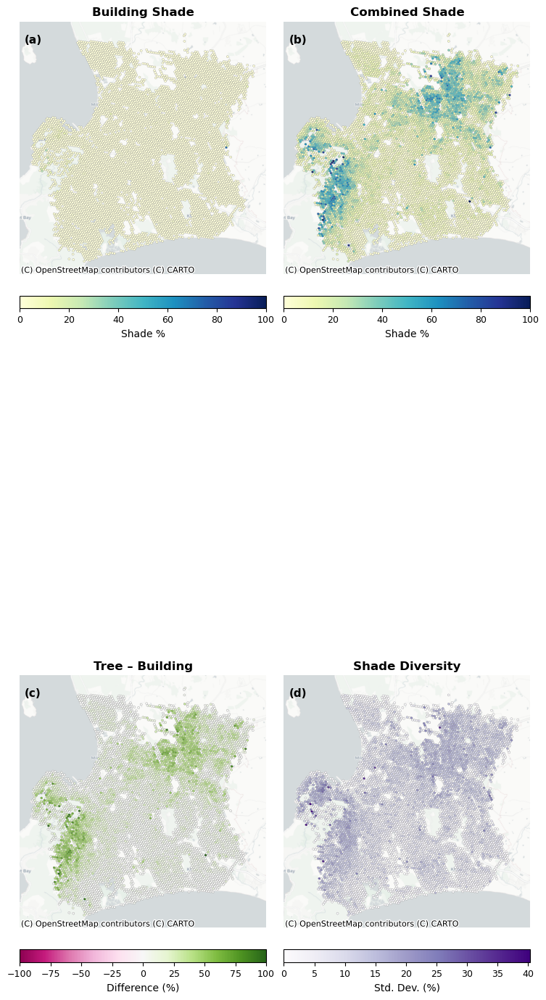

In [180]:
plot_shade_comparison_4panel_h3(
    city="Cape Town",
    time_str="1300",
    h3_resolution=9,
    layout_params={"rect": [0, 0.02, 1, 0.98], 
    "pad": 0.6, "h_pad": 0.25, "w_pad": 0.6},
    style={
    "axtitle": {"fontsize": 12, "fontweight": "bold"},
    "colorbar": {"fontsize": 9},
    "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
    "label_font": {"fontsize": 11, "fontweight": "bold"},
    "colorbar_spacing": {"size": "4%", "pad": 0.15},
    },
    preview_layout=True,
    export_path="../results/figures/Cape_Town_shade_comparison",
    export_dpi=300
)

In [ ]:
def plot_shade_comparison_4panel_h3(
    city,
    time_str,
    h3_resolution,
    style=None,
    label_panels=True,
    export_path=None,
    export_dpi=300,
    layout_params=None,
    autosize_from_gdf=True,
    preview_layout=False,
    figsize=None  # ✅ New
):
    import geopandas as gpd
    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import matplotlib.colors as mcolors
    import contextily as cx
    import pandas as pd
    import h3
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import numpy as np

    if style is None:
        style = {
            "axtitle": {"fontsize": 11, "fontweight": "normal"},
            "colorbar": {"fontsize": 9},
            "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
            "label_font": {"fontsize": 11, "fontweight": "bold"}
        }

    if layout_params is None:
        layout_params = {
            "rect": [0, 0.03, 1, 0.97],
            "pad": 1.0,
            "h_pad": 0.8,
            "w_pad": 0.8
        }

    # --- Load + preprocess ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")

    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # --- Aggregation with pre-computed difference ---
    gdf["difference"] = gdf[tree_col] - gdf[bldg_col]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col, "difference"]].mean().reset_index()
    agg["tree_std"] = gdf.groupby("h3_cell")[tree_col].std().reset_index(drop=True)
    agg["bldg_std"] = gdf.groupby("h3_cell")[bldg_col].std().reset_index(drop=True)
    agg["diversity"] = agg[["tree_std", "bldg_std"]].mean(axis=1)
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # --- Auto figure size based on aspect ratio ---
    if autosize_from_gdf:
        minx, miny, maxx, maxy = hex_gdf.total_bounds
        aspect_ratio = (maxy - miny) / (maxx - minx)
        aspect_ratio = np.clip(aspect_ratio, 0.3, 1.2)  # limit stretch
        base_width = 7.5
        fig_height = min(max(base_width * aspect_ratio * 2, 9), 12)  # cap at 12"
        
        if preview_layout:
            print(f"Bounds: {(minx, miny, maxx, maxy)}")
            print(f"Aspect ratio: {aspect_ratio:.2f} → figure size: ({base_width}, {fig_height:.2f})")
    else:
        base_width, fig_height = 7.5, 10

    fig, axs = plt.subplots(2, 2, figsize=(base_width, fig_height), sharex=True, sharey=True)
    axs = axs.flatten()

    fig.subplots_adjust(hspace=layout_params.get("hspace", 0.2),
                    wspace=layout_params.get("wspace", 0.1))
    
    style = style or {}
    st = style.get("suptitle", {})
    fig.suptitle(
        f"{city} | Shade comparison at {time_str[:2]}:{time_str[2:]} (H3 res {h3_resolution})",
        y=st.pop("y", 0.98),
        **st
    )

    # --- Panels ---
    panels = [
        {"col": bldg_col, "title": "Building Shade", "cmap": cm.YlGnBu},
        {"col": tree_col, "title": "Combined Shade", "cmap": cm.YlGnBu},
        {"col": "difference", "title": "Tree – Building", "cmap": cm.PiYG},
        {"col": "diversity", "title": "Shade Diversity", "cmap": cm.Purples},
    ]

    # --- Normalization ---
    abs_min = hex_gdf[[tree_col, bldg_col]].min().min()
    abs_max = hex_gdf[[tree_col, bldg_col]].max().max()
    shade_norm = mcolors.Normalize(vmin=abs_min, vmax=abs_max)

    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)

    div_min, div_max = hex_gdf["diversity"].min(), hex_gdf["diversity"].max()
    div_norm = mcolors.Normalize(vmin=div_min, vmax=div_max)

    norms = [shade_norm, shade_norm, diff_norm, div_norm]

    # --- Plot panels ---
    for i, (ax, panel, norm) in enumerate(zip(axs, panels, norms)):
        hex_gdf.plot(
            column=panel["col"],
            cmap=panel["cmap"],
            norm=norm,
            edgecolor="grey",
            linewidth=0.2,
            ax=ax
        )
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(panel["title"], **style["axtitle"])
        ax.set_axis_off()
        if label_panels:
            ax.text(0.02, 0.95, f"({chr(97 + i)})",
                    transform=ax.transAxes,
                    verticalalignment='top',
                    **style["label_font"])

    # --- Colorbars (horizontal, under each subplot) ---
    labels = ["Shade %", "Shade %", "Difference (%)", "Std. Dev. (%)"]
    for ax, panel, norm, label in zip(axs, panels, norms, labels):
        divider = make_axes_locatable(ax)
        # spacing = style.get("colorbar_spacing", {"size": "5%", "pad": 0.3})
        # cax = divider.append_axes("bottom", size=spacing["size"], pad=spacing["pad"])
        cax = divider.append_axes("bottom", size="5%", pad=0.3)
        sm = cm.ScalarMappable(norm=norm, cmap=panel["cmap"])
        cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
        cbar.ax.tick_params(labelsize=style["colorbar"]["fontsize"])
        cbar.set_label(label, **style["colorbar_label"])

    # --- Layout ---
    # plt.tight_layout(**layout_params)

    if export_path:
        fig.savefig(f"{export_path}{city}_shade_comparison_h3_{h3_resolution}_{time_str}.pdf", dpi=export_dpi, bbox_inches="tight")
        fig.savefig(f"{export_path}{city}_shade_comparison_h3_{h3_resolution}_{time_str}.png", dpi=export_dpi, bbox_inches='tight')

    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/611421759.py:54: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/611421759.py:58: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))


Bounds: (np.float64(1359463.8846412932), np.float64(5106018.954275222), np.float64(1433301.5262947027), np.float64(5187778.125347397))
Aspect ratio: 1.11 → figure size: (7.5, 12.00)


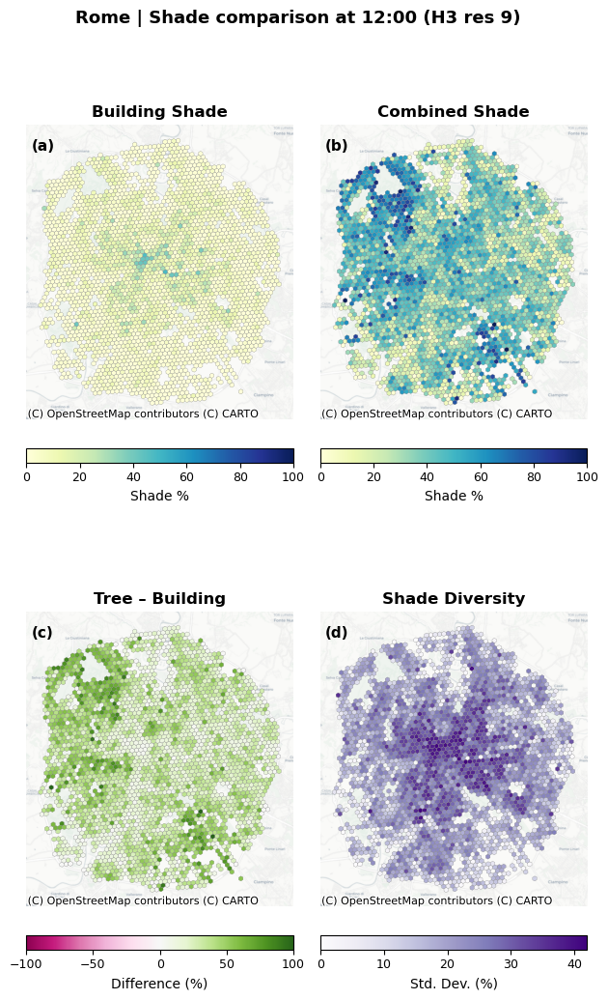

In [251]:
plot_shade_comparison_4panel_h3(
    city="Rome",
    time_str="1200",
    h3_resolution=9,
    layout_params={"rect": [0, 0.03, 1, 0.97], 
    "pad": 0.6, "h_pad": 0.15, "w_pad": 0.15},
    style={
    "axtitle": {"fontsize": 12, "fontweight": "bold"},
    "colorbar": {"fontsize": 9},
    "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
    "label_font": {"fontsize": 11, "fontweight": "bold"},
    "colorbar_spacing": {"size": "4%", "pad": 0.15},
    "suptitle": {"fontsize": 13, "fontweight": "bold", "y": 0.95},
    },
    preview_layout=True,
    export_path="../results/figures/",
    export_dpi=300
)

#### Shade comparison with different cmap

In [254]:
def plot_shade_comparison_4panel_h3(
    city,
    time_str,
    h3_resolution,
    style=None,
    label_panels=True,
    export_path=None,
    export_dpi=300,
    layout_params=None,
    autosize_from_gdf=True,
    preview_layout=False,
    figsize=None
):
    import geopandas as gpd
    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import matplotlib.colors as mcolors
    import contextily as cx
    import pandas as pd
    import h3
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import numpy as np

    def plot_shared_colorbar(ax, norm, cmap, label, style, orientation="vertical", location="right"):
        divider = make_axes_locatable(ax)
        size = style.get("colorbar_spacing", {}).get("size", "5%")
        pad = style.get("colorbar_spacing", {}).get("pad", 0.15)
        cax = divider.append_axes(location, size=size, pad=pad)
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        cbar = plt.colorbar(sm, cax=cax, orientation=orientation)
        cbar.ax.tick_params(labelsize=style.get("colorbar", {}).get("fontsize", 9))
        cbar.set_label(label, **style.get("colorbar_label", {}))

    if style is None:
        style = {
            "axtitle": {"fontsize": 11, "fontweight": "normal"},
            "colorbar": {"fontsize": 9},
            "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
            "label_font": {"fontsize": 11, "fontweight": "bold"},
        }

    if layout_params is None:
        layout_params = {
            "rect": [0, 0.03, 1, 0.97],
            "pad": 1.0,
            "h_pad": 0.8,
            "w_pad": 0.8
        }

    # --- Load + preprocess ---
    if city not in combined_city_data or city not in city_details:
        raise ValueError(f"City '{city}' missing in data or metadata.")

    gdf = combined_city_data[city].copy()
    date_str = city_details[city]["date"].replace("-", "")
    tree_col = f"{date_str}_tree_shade_percent_at_{time_str}"
    bldg_col = f"{date_str}_building_shade_percent_at_{time_str}"

    if tree_col not in gdf.columns or bldg_col not in gdf.columns:
        raise ValueError("Required shade columns not found.")

    gdf = gdf.to_crs("EPSG:4326")
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # --- Aggregation ---
    gdf["difference"] = gdf[tree_col] - gdf[bldg_col]
    gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    agg = gdf.groupby("h3_cell")[[tree_col, bldg_col, "difference"]].mean().reset_index()
    agg["tree_std"] = gdf.groupby("h3_cell")[tree_col].std().reset_index(drop=True)
    agg["bldg_std"] = gdf.groupby("h3_cell")[bldg_col].std().reset_index(drop=True)
    agg["diversity"] = agg[["tree_std", "bldg_std"]].mean(axis=1)
    agg["geometry"] = agg["h3_cell"].apply(lambda cell: h3.cells_to_h3shape([cell]))
    agg["geometry"] = agg["geometry"].apply(lambda g: g.geoms[0] if hasattr(g, "geoms") else g)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    # --- Auto figure size ---
    if figsize:
        base_width, fig_height = figsize
    elif autosize_from_gdf:
        minx, miny, maxx, maxy = hex_gdf.total_bounds
        aspect_ratio = (maxy - miny) / (maxx - minx)
        aspect_ratio = np.clip(aspect_ratio, 0.3, 1.2)
        base_width = 7.5
        fig_height = min(max(base_width * aspect_ratio * 2, 9), 12)
        if preview_layout:
            print(f"Aspect ratio: {aspect_ratio:.2f} → figure size: ({base_width}, {fig_height:.2f})")
    else:
        base_width, fig_height = 7.5, 10

    fig, axs = plt.subplots(2, 2, figsize=(base_width, fig_height), sharex=True, sharey=True)
    axs = axs.flatten()
    fig.subplots_adjust(hspace=layout_params.get("hspace", 0.2), wspace=layout_params.get("wspace", 0.1))

    # --- Title ---
    st = style.get("suptitle", {})
    fig.suptitle(
        f"{city} | Shade comparison at {time_str[:2]}:{time_str[2:]} (H3 res {h3_resolution})",
        y=st.pop("y", 0.98),
        **st
    )

    # --- Panels ---
    panels = [
        {"col": bldg_col, "title": "Building Shade", "cmap": cm.YlGnBu},
        {"col": tree_col, "title": "Combined Shade", "cmap": cm.YlGnBu},
        {"col": "difference", "title": "Tree – Building", "cmap": cm.PiYG},
        {"col": "diversity", "title": "Shade Diversity", "cmap": cm.Purples},
    ]

    # --- Normalization ---
    abs_min = hex_gdf[[tree_col, bldg_col]].min().min()
    abs_max = hex_gdf[[tree_col, bldg_col]].max().max()
    shade_norm = mcolors.Normalize(vmin=abs_min, vmax=abs_max)

    diff_max = abs(hex_gdf["difference"]).max()
    diff_norm = mcolors.TwoSlopeNorm(vmin=-diff_max, vcenter=0, vmax=diff_max)

    div_min, div_max = hex_gdf["diversity"].min(), hex_gdf["diversity"].max()
    div_norm = mcolors.Normalize(vmin=div_min, vmax=div_max)

    norms = [shade_norm, shade_norm, diff_norm, div_norm]

    # --- Plot panels ---
    for i, (ax, panel, norm) in enumerate(zip(axs, panels, norms)):
        hex_gdf.plot(
            column=panel["col"],
            cmap=panel["cmap"],
            norm=norm,
            edgecolor="grey",
            linewidth=0.2,
            ax=ax
        )
        cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)
        ax.set_title(panel["title"], **style["axtitle"])
        ax.set_axis_off()
        if label_panels:
            ax.text(0.02, 0.95, f"({chr(97 + i)})", transform=ax.transAxes, verticalalignment='top', **style["label_font"])

        if i == 1:
            plot_shared_colorbar(ax, shade_norm, cm.YlGnBu, "Shade %", style, orientation="vertical", location="right")

    # --- Remaining colorbars (difference and diversity) ---
    for i in [2, 3]:
        ax = axs[i]
        panel = panels[i]
        norm = norms[i]
        label = ["Difference (%)", "Std. Dev. (%)"][i - 2]
        divider = make_axes_locatable(ax)
        size = style.get("colorbar_spacing", {}).get("size", "5%")
        pad = style.get("colorbar_spacing", {}).get("pad", 0.3)
        cax = divider.append_axes("bottom", size=size, pad=pad)
        sm = cm.ScalarMappable(norm=norm, cmap=panel["cmap"])
        cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
        cbar.ax.tick_params(labelsize=style["colorbar"]["fontsize"])
        cbar.set_label(label, **style["colorbar_label"])

    if export_path:
        fig.savefig(f"{export_path}{city}_shade_comparison_h3_{h3_resolution}_{time_str}_new.pdf", dpi=export_dpi, bbox_inches="tight")
        fig.savefig(f"{export_path}{city}_shade_comparison_h3_{h3_resolution}_{time_str}_new.png", dpi=export_dpi, bbox_inches="tight")

    plt.show()

/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/1130179606.py:64: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))
/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_32746/1130179606.py:68: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["h3_cell"] = gdf.geometry.centroid.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))


Aspect ratio: 1.11 → figure size: (7.5, 12.00)


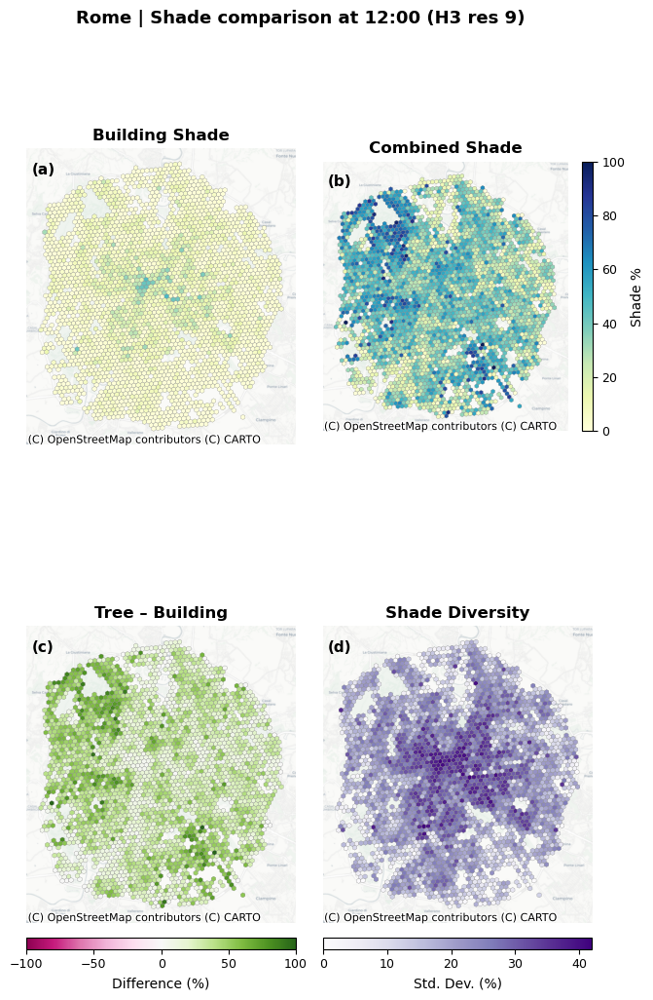

In [255]:
plot_shade_comparison_4panel_h3(
    city="Rome",
    time_str="1200",
    h3_resolution=9,
    layout_params={"rect": [0, 0.03, 1, 0.97], 
    "pad": 0.6, "h_pad": 0.15, "w_pad": 0.15},
    style={
    "axtitle": {"fontsize": 12, "fontweight": "bold"},
    "colorbar": {"fontsize": 9},
    "colorbar_label": {"fontsize": 10, "fontweight": "normal"},
    "label_font": {"fontsize": 11, "fontweight": "bold"},
    "colorbar_spacing": {"size": "4%", "pad": 0.15},
    "suptitle": {"fontsize": 13, "fontweight": "bold", "y": 0.95},
    },
    preview_layout=True,
    export_path="../results/figures/",
    export_dpi=300
)

### Single map

### Shade availability Index

In [257]:
import pandas as pd
import plotly.graph_objects as go

# Extract data for Rome
gdf = combined_city_data["Rome"].copy()

# Define categorization function
def categorize_shade_index(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# Apply to both building and tree shade availability columns
gdf["building_category"] = gdf["shade_availability_index_building"].apply(categorize_shade_index)
gdf["tree_category"] = gdf["shade_availability_index_tree"].apply(categorize_shade_index)

# Count transitions between building and tree categories
transition_counts = (
    gdf.groupby(["building_category", "tree_category"])
    .size()
    .reset_index(name="count")
)

# Get unique labels and create index mappings
building_labels = transition_counts["building_category"].unique().tolist()
tree_labels = transition_counts["tree_category"].unique().tolist()
all_labels = building_labels + [label for label in tree_labels if label not in building_labels]
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Map source/target to index positions
transition_counts["source"] = transition_counts["building_category"].map(label_to_index)
transition_counts["target"] = transition_counts["tree_category"].map(label_to_index) + len(building_labels)

# Build Sankey diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels + tree_labels,
        color="lightgray"
    ),
    link=dict(
        source=transition_counts["source"],
        target=transition_counts["target"],
        value=transition_counts["count"]
    )
)])

fig.update_layout(title_text="Shade Availability Transitions: Building → Tree (Rome)", font_size=12)
fig.show()

In [261]:
import pandas as pd
import plotly.graph_objects as go

# --- CONFIGURATION ---
city = "Boston"  # change this to another city as needed

# Define category color scheme
shade_colors = {
    "Excellent": "#1a9850",    # deep green
    "Very good": "#66bd63",    # medium green
    "Acceptable": "#fee08b",   # yellow-orange
    "Poor": "#d73027"          # red
}

# Define categorization function
def categorize_shade_index(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# --- DATA PREPARATION ---
gdf = combined_city_data[city].copy()

gdf["building_category"] = gdf["shade_availability_index_building"].apply(categorize_shade_index)
gdf["tree_category"] = gdf["shade_availability_index_tree"].apply(categorize_shade_index)

# Filter out "No data" entries
gdf = gdf[
    (gdf["building_category"] != "No data") &
    (gdf["tree_category"] != "No data")
]

# Count transitions between categories
transition_counts = (
    gdf.groupby(["building_category", "tree_category"])
    .size()
    .reset_index(name="count")
)

# Unique category order for consistency
categories = ["Excellent", "Very good", "Acceptable", "Poor"]
label_left = [f"{cat} (building)" for cat in categories]
label_right = [f"{cat} (tree)" for cat in categories]
all_labels = label_left + label_right

# Map labels to node indices
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Add source and target indices
transition_counts["source"] = transition_counts["building_category"].apply(lambda x: label_to_index[f"{x} (building)"])
transition_counts["target"] = transition_counts["tree_category"].apply(lambda x: label_to_index[f"{x} (tree)"])

# Build node colors (left and right side use same category colors)
node_colors = [shade_colors[cat] for cat in categories] * 2

# --- PLOTTING ---
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,
        color=node_colors
    ),
    link=dict(
        source=transition_counts["source"],
        target=transition_counts["target"],
        value=transition_counts["count"]
    )
)])

fig.update_layout(
    title_text=f"Shade Category Transitions: Building → Tree ({city})",
    font_size=12,
    height=500
)
fig.show()

In [262]:
import pandas as pd
import plotly.graph_objects as go

# --- CONFIGURATION ---
city = "Rome"  # adjust as needed

# Define categories top-to-bottom
categories = ["Poor", "Acceptable", "Very good", "Excellent"]

# Color scheme
base_colors = {
    "Poor": "#d73027",
    "Acceptable": "#fee08b",
    "Very good": "#66bd63",
    "Excellent": "#1a9850"
}

# Slightly faded versions for "before trees"
def desaturate(hex_color):
    import matplotlib.colors as mcolors
    r, g, b = mcolors.hex2color(hex_color)
    r, g, b = [0.6 + 0.4 * c for c in (r, g, b)]  # brighten toward white
    return mcolors.to_hex((r, g, b))

colors_before = [desaturate(base_colors[c]) for c in categories]
colors_after = [base_colors[c] for c in categories]
node_colors = colors_before + colors_after

# Categorize shade index
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# --- DATA ---
gdf = combined_city_data[city].copy()
gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

# Filter valid rows
gdf = gdf[
    (gdf["building_cat"] != "No data") &
    (gdf["combined_cat"] != "No data")
]

# Transition counts
counts = (
    gdf.groupby(["building_cat", "combined_cat"])
    .size()
    .reset_index(name="count")
)

# Ensure correct order
label_left = [f"{c} (before)" for c in categories]
label_right = [f"{c} (after)" for c in categories]
all_labels = label_left + label_right
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Map sources and targets
counts["source"] = counts["building_cat"].apply(lambda x: label_to_index[f"{x} (before)"])
counts["target"] = counts["combined_cat"].apply(lambda x: label_to_index[f"{x} (after)"])

# --- PLOT ---
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=20,
        thickness=24,
        line=dict(color="black", width=0.4),
        label=all_labels,
        color=node_colors
    ),
    link=dict(
        source=counts["source"],
        target=counts["target"],
        value=counts["count"],
        color="rgba(150,150,150,0.2)"  # neutral link color for now
    )
)])

fig.update_layout(
    title={
        "text": f"<b>Trees dramatically improve sidewalk shade in {city}</b><br><span style='font-size:14px'>Shade availability index before and after adding tree shade</span>",
        "x": 0.5,
        "xanchor": "center"
    },
    font_size=13,
    height=600,
    margin=dict(l=10, r=10, t=80, b=10)
)

fig.show()

In [263]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors

city = "Rome"

# Ordered categories for top-to-bottom display
categories = ["Poor", "Acceptable", "Very good", "Excellent"]

# Base color scheme for each category
base_colors = {
    "Poor": "#d73027",
    "Acceptable": "#fee08b",
    "Very good": "#66bd63",
    "Excellent": "#1a9850"
}

# Lighten function for building (before) node colors
def desaturate(hex_color, strength=0.4):
    r, g, b = mcolors.hex2color(hex_color)
    r, g, b = [1 - strength * (1 - c) for c in (r, g, b)]  # blend toward white
    return mcolors.to_hex((r, g, b))

# Categorization logic
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# Load and prepare data
gdf = combined_city_data[city].copy()
gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)
gdf = gdf[
    (gdf["building_cat"] != "No data") &
    (gdf["combined_cat"] != "No data")
]

# Count transitions
transitions = (
    gdf.groupby(["building_cat", "combined_cat"])
    .size()
    .reset_index(name="count")
)

# Labels and mapping
label_left = [f"{c} (before)" for c in categories]
label_right = [f"{c} (after)" for c in categories]
all_labels = label_left + label_right
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Map sources and targets
transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (before)"])
transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (after)"])

# Node colors
node_colors = [desaturate(base_colors[c]) for c in categories] + [base_colors[c] for c in categories]

# Link colors (based on building_cat source)
opacity = 0.3
transitions["link_color"] = transitions["building_cat"].apply(
    lambda c: mcolors.to_rgba(base_colors[c], opacity)
).apply(lambda rgba: f"rgba({int(rgba[0]*255)}, {int(rgba[1]*255)}, {int(rgba[2]*255)}, {rgba[3]})")

# Plot
fig = go.Figure(data=[go.Sankey(
    arrangement="snap",
    node=dict(
        pad=20,
        thickness=24,
        line=dict(color="black", width=0.4),
        label=all_labels,
        color=node_colors
    ),
    link=dict(
        source=transitions["source"],
        target=transitions["target"],
        value=transitions["count"],
        color=transitions["link_color"]
    )
)])

fig.update_layout(
    title={
        "text": f"<b>Tree shade improves sidewalk shade in {city}</b><br><span style='font-size:14px'>Transitions in shade availability index after accounting for vegetation</span>",
        "x": 0.5,
        "xanchor": "center"
    },
    font_size=13,
    height=600,
    margin=dict(l=20, r=20, t=80, b=20)
)

fig.show()

In [ ]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors

# --- CONFIGURATION ---
city = "Rome"  # or any other loaded city
gdf = combined_city_data[city].copy()

# Categorization function
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# Define categories and color palette
categories = ["Excellent", "Very good", "Acceptable", "Poor"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Categorize building and tree (combined) shade
gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

# Filter valid data
gdf = gdf[
    (gdf["building_cat"] != "No data") &
    (gdf["combined_cat"] != "No data")
]

# Count transitions
transitions = (
    gdf.groupby(["building_cat", "combined_cat"])
    .size()
    .reset_index(name="count")
)

# Create node labels and indices
label_left = [f"{c} (building)" for c in categories]
label_right = [f"{c} (combined)" for c in categories]
all_labels = label_left + label_right
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Map to source/target
transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (building)"])
transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (combined)"])

# Build node and link colors
opacity = 0.3
desaturated = lambda c: f"rgba({int(mcolors.to_rgba(c)[0]*255)}, {int(mcolors.to_rgba(c)[1]*255)}, {int(mcolors.to_rgba(c)[2]*255)}, {opacity})"
node_colors = [desaturated(base_colors[c]) for c in categories] + [base_colors[c] for c in categories]

transitions["link_color"] = transitions["combined_cat"].apply(
    lambda c: f"rgba({int(mcolors.to_rgba(base_colors[c])[0]*255)}, {int(mcolors.to_rgba(base_colors[c])[1]*255)}, {int(mcolors.to_rgba(base_colors[c])[2]*255)}, 0.5)"
)

# --- PLOT ---
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,
        color=node_colors
    ),
    link=dict(
        source=transitions["source"],
        target=transitions["target"],
        value=transitions["count"],
        color=transitions["link_color"]
    )
)])

fig.update_layout(
    title_text=f"Impact of Tree Shade on Shade Availability Categories ({city})",
    font_size=12,
    height=500
)

fig.show()

In [276]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors

# --- CONFIGURATION ---
city = "Boston"  # or any other loaded city
gdf = combined_city_data[city].copy()

# Ensure projected CRS (e.g. meters)
if gdf.crs.is_geographic:
    gdf = gdf.to_crs(epsg=3857)

# Calculate area (if not already present)
gdf["area_m2"] = gdf.geometry.area

# Categorization function
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# Define categories and color palette
categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Categorize building and tree (combined) shade
gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

# Filter valid data
gdf = gdf[
    (gdf["building_cat"] != "No data") &
    (gdf["combined_cat"] != "No data")
]

# # Count transitions
# transitions = (
#     gdf.groupby(["building_cat", "combined_cat"])
#     .size()
#     .reset_index(name="count")
# )

# Group transitions by category pair, summing area instead of counting
transitions = (
    gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
    .sum()
    .reset_index(name="area")
)


# Normalize to hectares or km² if needed
transitions["area"] = transitions["area"] / 1_000_000  # km²


# Create node labels and indices
label_left = [f"{c} (building)" for c in categories]
label_right = [f"{c} (combined shade)" for c in categories]
all_labels = label_left + label_right
label_to_index = {label: i for i, label in enumerate(all_labels)}

# Map to source/target
# Force correct category order visually
cat_order = {cat: i for i, cat in enumerate(categories)}
transitions["source_order"] = transitions["building_cat"].map(cat_order)
transitions["target_order"] = transitions["combined_cat"].map(cat_order)


transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (building)"])
transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (combined shade)"])
# Build node and link colors
opacity = 0.3
desaturated = lambda c: f"rgba({int(mcolors.to_rgba(c)[0]*255)}, {int(mcolors.to_rgba(c)[1]*255)}, {int(mcolors.to_rgba(c)[2]*255)}, {opacity})"
node_colors = [desaturated(base_colors[c]) for c in categories] + [base_colors[c] for c in categories]

transitions["link_color"] = transitions["combined_cat"].apply(
    lambda c: f"rgba({int(mcolors.to_rgba(base_colors[c])[0]*255)}, {int(mcolors.to_rgba(base_colors[c])[1]*255)}, {int(mcolors.to_rgba(base_colors[c])[2]*255)}, 0.5)"
)

# --- PLOT ---
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_labels,
        color=node_colors
    ),
    link=dict(
        source=transitions["source"],
        target=transitions["target"],
        value=transitions["area"],
        color=transitions["link_color"]
    )
)])

fig.update_layout(
    title_text=f"Impact of Tree Shade on Shade Availability Categories ({city})",
    font_size=12,
    height=700  # or even 800
)

fig.show()

In [279]:
import plotly.io as pio
pio.kaleido.scope

In [ ]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

# Define categories and color palette
categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Desaturation helper
def desaturated(c, opacity=0.3):
    rgba = mcolors.to_rgba(c)
    return f"rgba({int(rgba[0]*255)}, {int(rgba[1]*255)}, {int(rgba[2]*255)}, {opacity})"

# Categorization function
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# --- MAIN LOOP ---
for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")

    gdf = gdf.copy()
    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area

    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000  # km²

    # Define label order explicitly
    label_left = [f"{c} (building)" for c in categories]
    label_right = [f"{c} (combined shade)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (building)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (combined shade)"])

    # Color nodes and links
    node_colors = [base_colors[c] for c in categories] + [base_colors[c] for c in categories]
    transitions["link_color"] = transitions["combined_cat"].apply(
        lambda c: f"rgba({int(mcolors.to_rgba(base_colors[c])[0]*255)}, {int(mcolors.to_rgba(base_colors[c])[1]*255)}, {int(mcolors.to_rgba(base_colors[c])[2]*255)}, 0.5)"
    )

    # --- Plot ---
    fig = go.Figure(data=[go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels,
            color=node_colors
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"]
        )
    )])

    fig.update_layout(
        title_text=f"How Trees Improve Urban Shade: Category Transitions of the Shade Availability Index in {city}",
        font_size=12,
        height=700,
    )

    # Export as SVG
    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}.svg")
    fig.write_image(export_path)
    print(f"Saved to {export_path}")

SyntaxError: invalid syntax. Perhaps you forgot a comma? (1782098975.py, line 95)

In [8]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Categorize SAI
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

def mix_colors(c1, c2, bias=0.75, alpha=0.65):
    r1, g1, b1 = [int(x * 255) for x in mcolors.to_rgba(c1)[:3]]
    r2, g2, b2 = [int(x * 255) for x in mcolors.to_rgba(c2)[:3]]
    rm = int((1 - bias) * r1 + bias * r2)
    gm = int((1 - bias) * g1 + bias * g2)
    bm = int((1 - bias) * b1 + bias * b2)
    return f"rgba({rm},{gm},{bm},{alpha})"
# --- MAIN LOOP ---
for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")
    gdf = gdf.copy()

    # Ensure metric CRS
    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area
    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000  # km²

    # Calculate % per source category
    source_totals = transitions.groupby("building_cat")["area"].sum().to_dict()
    transitions["percentage"] = transitions.apply(
        lambda row: 100 * row["area"] / source_totals[row["building_cat"]],
        axis=1
    )

    # Node labels
    label_left = [f"{c} (bldg only)" for c in categories]
    label_right = [f"{c} (+ trees)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}
    print("Node mapping:")
    for label, idx in label_to_index.items():
        print(f"{idx}: {label}")


    # Sort transitions by the fixed category order
    cat_order = {cat: i for i, cat in enumerate(categories)}
    transitions["source_order"] = transitions["building_cat"].map(cat_order)
    transitions["target_order"] = transitions["combined_cat"].map(cat_order)
    transitions = transitions.sort_values(by=["source_order", "target_order"]).reset_index(drop=True)

    for cat in categories:
        for side in ["building_cat", "combined_cat"]:
            condition = ~gdf[side].isin([cat])
            if condition.all():  # category is missing
                dummy = {
                    "building_cat": cat if side == "building_cat" else categories[0],
                    "combined_cat": cat if side == "combined_cat" else categories[0],
                    "area": 0
                }
                transitions = pd.concat([transitions, pd.DataFrame([dummy])], ignore_index=True)

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (bldg only)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (+ trees)"])

    # Node colors
    node_colors = [base_colors[c] for c in categories] + [base_colors[c] for c in categories]

    # Link color: mix of source and target
    transitions["link_color"] = transitions.apply(
        lambda row: mix_colors(base_colors[row["building_cat"]], base_colors[row["combined_cat"]], alpha=0.5), 
        axis=1
    )

    # Compute total gain
    improved = transitions[
        transitions.apply(lambda row: categories.index(row["combined_cat"]) > categories.index(row["building_cat"]), axis=1)
    ]
    total_gain = improved["area"].sum()

    # Create Sankey plot
    fig = go.Figure(data=[go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels,
            color=node_colors
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"],
            customdata=transitions["percentage"],
            hovertemplate=(
                "%{value:.2f} km²<br>"
                "%{customdata:.1f}% of source category"
            )
        )
    )])

    # Layout & annotations
    fig.update_layout(
        title_text=f"Shade Availability Index: Building-only vs Combined Shade in {city}",
        title_x=0.5,
        font_size=12,
        height=800,
        width=1000,
        margin=dict(t=120, b=100, l=80, r=80),
        annotations=[
            dict(
                text=f"Total improved area: {total_gain:.2f} km²",
                x=0.5, y=-0.12,
                xref='paper', yref='paper',
                showarrow=False,
                font=dict(size=14),
                align='center'
            )
        ]
    )

    # Export PNG (high resolution)
    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}.png")
    fig.write_image(export_path, format="png", scale=3, width=1000, height=800)
    print(f"Saved to {export_path}")

Processing Stockholm...
Node mapping:
0: Poor (bldg only)
1: Acceptable (bldg only)
2: Very good (bldg only)
3: Excellent (bldg only)
4: Poor (+ trees)
5: Acceptable (+ trees)
6: Very good (+ trees)
7: Excellent (+ trees)
Saved to ../results/figures/shade_sankey_exports/sankey_stockholm.png
Processing Amsterdam...
Node mapping:
0: Poor (bldg only)
1: Acceptable (bldg only)
2: Very good (bldg only)
3: Excellent (bldg only)
4: Poor (+ trees)
5: Acceptable (+ trees)
6: Very good (+ trees)
7: Excellent (+ trees)
Saved to ../results/figures/shade_sankey_exports/sankey_amsterdam.png
Processing Boston...
Node mapping:
0: Poor (bldg only)
1: Acceptable (bldg only)
2: Very good (bldg only)
3: Excellent (bldg only)
4: Poor (+ trees)
5: Acceptable (+ trees)
6: Very good (+ trees)
7: Excellent (+ trees)
Saved to ../results/figures/shade_sankey_exports/sankey_boston.png
Processing Rome...
Node mapping:
0: Poor (bldg only)
1: Acceptable (bldg only)
2: Very good (bldg only)
3: Excellent (bldg only)
4

In [9]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Categorize SAI
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

# Color blending for gradient effect
def mix_colors(c1, c2, bias=0.75, alpha=0.75):
    r1, g1, b1 = [int(x * 255) for x in mcolors.to_rgba(c1)[:3]]
    r2, g2, b2 = [int(x * 255) for x in mcolors.to_rgba(c2)[:3]]
    rm = int((1 - bias) * r1 + bias * r2)
    gm = int((1 - bias) * g1 + bias * g2)
    bm = int((1 - bias) * b1 + bias * b2)
    return f"rgba({rm},{gm},{bm},{alpha})"

# --- MAIN LOOP ---
for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")
    gdf = gdf.copy()

    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area
    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000  # km²

    # Inject dummy flows to enforce label order
    for cat in categories:
        transitions = pd.concat([
            transitions,
            pd.DataFrame([{
                "building_cat": cat,
                "combined_cat": cat,
                "area": 0.00001,
            }])
        ], ignore_index=True)

    # Calculate percentages per source
    source_totals = transitions.groupby("building_cat")["area"].sum().to_dict()
    transitions["percentage"] = transitions.apply(
        lambda row: 100 * row["area"] / source_totals[row["building_cat"]],
        axis=1
    )

    # Labels and ordering
    label_left = [f"{c} (bldg only)" for c in categories]
    label_right = [f"{c} (+ trees)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}
    cat_order = {cat: i for i, cat in enumerate(categories)}

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (bldg only)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (+ trees)"])
    transitions["source_order"] = transitions["building_cat"].map(cat_order)
    transitions["target_order"] = transitions["combined_cat"].map(cat_order)

    transitions = transitions.sort_values(by=["source_order", "target_order"]).reset_index(drop=True)

    node_colors = [base_colors[c] for c in categories] + [base_colors[c] for c in categories]
    transitions["link_color"] = transitions.apply(
        lambda row: mix_colors(base_colors[row["building_cat"]], base_colors[row["combined_cat"]], alpha=0.75),
        axis=1
    )

    # Total improvement
    improved = transitions[
        transitions.apply(lambda row: cat_order[row["combined_cat"]] > cat_order[row["building_cat"]], axis=1)
    ]
    total_gain = improved["area"].sum()

    # Plot
    fig = go.Figure(data=[go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels,
            color=node_colors
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"],
            customdata=transitions["percentage"],
            hovertemplate="%{value:.2f} km²<br>%{customdata:.1f}% of source category"
        )
    )])

    fig.update_layout(
        title_text=f"Shade Availability Index Improvements in {city}",
        title_x=0.5,
        font_size=12,
        height=800,
        width=1000,
        margin=dict(t=120, b=100, l=80, r=80),
        annotations=[
            dict(
                text=f"Total improved area: {total_gain:.2f} km²",
                x=0.5, y=-0.12,
                xref='paper', yref='paper',
                showarrow=False,
                font=dict(size=14),
                align='center'
            )
        ]
    )

    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}.png")
    fig.write_image(export_path, format="png", scale=3, width=1000, height=800)
    print(f"Saved to {export_path}")

Processing Stockholm...
Saved to ../results/figures/shade_sankey_exports/sankey_stockholm.png
Processing Amsterdam...
Saved to ../results/figures/shade_sankey_exports/sankey_amsterdam.png
Processing Boston...
Saved to ../results/figures/shade_sankey_exports/sankey_boston.png
Processing Rome...
Saved to ../results/figures/shade_sankey_exports/sankey_rome.png
Processing Tunis...
Saved to ../results/figures/shade_sankey_exports/sankey_tunis.png
Processing Hong Kong...
Saved to ../results/figures/shade_sankey_exports/sankey_hong_kong.png
Processing Belem...
Saved to ../results/figures/shade_sankey_exports/sankey_belem.png
Processing Rio...
Saved to ../results/figures/shade_sankey_exports/sankey_rio.png
Processing Sydney...
Saved to ../results/figures/shade_sankey_exports/sankey_sydney.png
Processing Cape Town...
Saved to ../results/figures/shade_sankey_exports/sankey_cape_town.png


In [11]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

# Categorize SAI
def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

def mix_colors(c1, c2, bias=0.75, alpha=0.65):
    r1, g1, b1 = [int(x * 255) for x in mcolors.to_rgba(c1)[:3]]
    r2, g2, b2 = [int(x * 255) for x in mcolors.to_rgba(c2)[:3]]
    rm = int((1 - bias) * r1 + bias * r2)
    gm = int((1 - bias) * g1 + bias * g2)
    bm = int((1 - bias) * b1 + bias * b2)
    return f"rgba({rm},{gm},{bm},{alpha})"

# --- MAIN LOOP ---
for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")
    gdf = gdf.copy()

    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area
    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000  # km²

    source_totals = transitions.groupby("building_cat")["area"].sum().to_dict()
    transitions["percentage"] = transitions.apply(
        lambda row: 100 * row["area"] / source_totals[row["building_cat"]],
        axis=1
    )

    label_left = [f"{c} (bldg only)" for c in categories]
    label_right = [f"{c} (+ trees)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (bldg only)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (+ trees)"])

    node_colors = [base_colors[c] for c in categories] + [base_colors[c] for c in categories]
    transitions["link_color"] = transitions.apply(
        lambda row: mix_colors(base_colors[row["building_cat"]], base_colors[row["combined_cat"]], alpha=0.65),
        axis=1
    )

    node_x = [0.001] * len(label_left) + [0.999] * len(label_right)
    node_y = [i / len(label_left) for i in range(len(label_left))] + [i / len(label_right) for i in range(len(label_right))]

    improved = transitions[
        transitions.apply(lambda row: categories.index(row["combined_cat"]) > categories.index(row["building_cat"]), axis=1)
    ]
    total_gain = improved["area"].sum()

    fig = go.Figure(data=[go.Sankey(
        arrangement='snap',
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels,
            color=node_colors,
            x=node_x,
            y=node_y
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"],
            customdata=transitions["percentage"],
            hovertemplate=(
                "%{value:.2f} km²<br>"
                "%{customdata:.1f}% of source category"
            )
        )
    )])

    fig.update_layout(
        title_text=f"Shade Availability Index: Building-only vs Combined Shade in {city}",
        title_x=0.5,
        font_size=12,
        height=800,
        width=1000,
        margin=dict(t=120, b=100, l=80, r=80),
        annotations=[
            dict(
                text=f"Total improved area: {total_gain:.2f} km²",
                x=0.5, y=-0.12,
                xref='paper', yref='paper',
                showarrow=False,
                font=dict(size=14),
                align='center'
            )
        ]
    )

    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}.png")
    fig.write_image(export_path, format="png", scale=3, width=1000, height=800)
    print(f"Saved to {export_path}")

Processing Stockholm...
Saved to ../results/figures/shade_sankey_exports/sankey_stockholm.png
Processing Amsterdam...
Saved to ../results/figures/shade_sankey_exports/sankey_amsterdam.png
Processing Boston...
Saved to ../results/figures/shade_sankey_exports/sankey_boston.png
Processing Rome...
Saved to ../results/figures/shade_sankey_exports/sankey_rome.png
Processing Tunis...
Saved to ../results/figures/shade_sankey_exports/sankey_tunis.png
Processing Hong Kong...
Saved to ../results/figures/shade_sankey_exports/sankey_hong_kong.png
Processing Belem...
Saved to ../results/figures/shade_sankey_exports/sankey_belem.png
Processing Rio...
Saved to ../results/figures/shade_sankey_exports/sankey_rio.png
Processing Sydney...
Saved to ../results/figures/shade_sankey_exports/sankey_sydney.png
Processing Cape Town...
Saved to ../results/figures/shade_sankey_exports/sankey_cape_town.png


In [6]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

categories = ["Poor", "Acceptable", "Very good", "Excellent"]
base_colors = {
    "Excellent": "#1a9850",
    "Very good": "#66bd63",
    "Acceptable": "#fee08b",
    "Poor": "#d73027"
}

def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

def mix_colors(c1, c2, bias=0.75, alpha=0.7):
    r1, g1, b1 = [int(x * 255) for x in mcolors.to_rgba(c1)[:3]]
    r2, g2, b2 = [int(x * 255) for x in mcolors.to_rgba(c2)[:3]]
    rm = int((1 - bias) * r1 + bias * r2)
    gm = int((1 - bias) * g1 + bias * g2)
    bm = int((1 - bias) * b1 + bias * b2)
    return f"rgba({rm},{gm},{bm},{alpha})"

for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")
    gdf = gdf.copy()

    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area
    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000

    source_totals = transitions.groupby("building_cat")["area"].sum().to_dict()
    target_totals = transitions.groupby("combined_cat")["area"].sum().to_dict()

    transitions["percentage"] = transitions.apply(
        lambda row: 100 * row["area"] / source_totals[row["building_cat"]],
        axis=1
    )

    label_left = [f"{c} (bldg only)" for c in categories]
    label_right = [f"{c} (+ trees)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (bldg only)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (+ trees)"])

    node_colors = [base_colors[c] for c in categories] * 2

    transitions["link_color"] = transitions.apply(
        lambda row: mix_colors(base_colors[row["building_cat"]], base_colors[row["combined_cat"]]),
        axis=1
    )

    left_labels = [
        f"{cat} (bldg only)\n({(source_totals.get(cat, 0) / sum(source_totals.values())) * 100:.1f}%)"
        for cat in categories
    ]
    right_labels = [
        f"{cat} (+ trees)\n({(target_totals.get(cat, 0) / sum(target_totals.values())) * 100:.1f}%)"
        for cat in categories
    ]
    all_labels_annotated = left_labels + right_labels

    fig = go.Figure(data=[go.Sankey(
        arrangement="snap",
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels_annotated,
            color=node_colors,
            x=[0.1]*4 + [0.9]*4,
            y=[0.1, 0.3, 0.5, 0.7]*2
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"],
            customdata=transitions["percentage"],
            hovertemplate="%{value:.2f} km²<br>%{customdata:.1f}% of source category"
        )
    )])

    fig.update_layout(
        title_text=f"Shade Availability Index: Building-only vs Combined Shade in {city}",
        title_x=0.5,
        font_size=12,
        height=800,
        width=1000,
        margin=dict(t=120, b=100, l=80, r=80),
    )

    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}.png")
    fig.write_image(export_path, format="png", scale=3, width=1000, height=800)
    print(f"Saved to {export_path}")

Processing Stockholm...
Saved to ../results/figures/shade_sankey_exports/sankey_stockholm.png
Processing Amsterdam...
Saved to ../results/figures/shade_sankey_exports/sankey_amsterdam.png
Processing Boston...
Saved to ../results/figures/shade_sankey_exports/sankey_boston.png
Processing Rome...
Saved to ../results/figures/shade_sankey_exports/sankey_rome.png
Processing Tunis...
Saved to ../results/figures/shade_sankey_exports/sankey_tunis.png
Processing Hong Kong...
Saved to ../results/figures/shade_sankey_exports/sankey_hong_kong.png
Processing Belem...
Saved to ../results/figures/shade_sankey_exports/sankey_belem.png
Processing Rio...
Saved to ../results/figures/shade_sankey_exports/sankey_rio.png
Processing Sydney...
Saved to ../results/figures/shade_sankey_exports/sankey_sydney.png
Processing Cape Town...
Saved to ../results/figures/shade_sankey_exports/sankey_cape_town.png


In [18]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.colors as mcolors
import os

# --- CONFIGURATION ---
output_dir = "../results/figures/shade_sankey_exports"
os.makedirs(output_dir, exist_ok=True)

categories = ["Poor", "Acceptable", "Very good", "Excellent"]
# base_colors = {
#     "Excellent": "#1a9850",
#     "Very good": "#66bd63",
#     "Acceptable": "#fee08b",
#     "Poor": "#d73027"
# }
base_colors = {
    "Poor": "#fdae61",
    "Acceptable": "#fee08b",
    "Very good": "#abd9e9",
    "Excellent": "#2c7bb6"
}

def categorize(index):
    if pd.isna(index):
        return "No data"
    elif index >= 0.9:
        return "Excellent"
    elif index >= 0.7:
        return "Very good"
    elif index >= 0.5:
        return "Acceptable"
    else:
        return "Poor"

def mix_colors(c1, c2, bias=0.75, alpha=0.7):
    r1, g1, b1 = [int(x * 255) for x in mcolors.to_rgba(c1)[:3]]
    r2, g2, b2 = [int(x * 255) for x in mcolors.to_rgba(c2)[:3]]
    rm = int((1 - bias) * r1 + bias * r2)
    gm = int((1 - bias) * g1 + bias * g2)
    bm = int((1 - bias) * b1 + bias * b2)
    return f"rgba({rm},{gm},{bm},{alpha})"

for city, gdf in combined_city_data.items():
    print(f"Processing {city}...")
    gdf = gdf.copy()

    if gdf.crs.is_geographic:
        gdf = gdf.to_crs(epsg=3857)

    gdf["area_m2"] = gdf.geometry.area
    gdf["building_cat"] = gdf["shade_availability_index_building"].apply(categorize)
    gdf["combined_cat"] = gdf["shade_availability_index_tree"].apply(categorize)

    gdf = gdf[
        (gdf["building_cat"] != "No data") &
        (gdf["combined_cat"] != "No data")
    ]

    transitions = (
        gdf.groupby(["building_cat", "combined_cat"])["area_m2"]
        .sum()
        .reset_index(name="area")
    )
    transitions["area"] /= 1_000_000

    source_totals = transitions.groupby("building_cat")["area"].sum().to_dict()
    target_totals = transitions.groupby("combined_cat")["area"].sum().to_dict()

    transitions["percentage"] = transitions.apply(
        lambda row: 100 * row["area"] / source_totals[row["building_cat"]],
        axis=1
    )

    label_left = [f"{c} (bldg only)" for c in categories]
    label_right = [f"{c} (+ trees)" for c in categories]
    all_labels = label_left + label_right
    label_to_index = {label: i for i, label in enumerate(all_labels)}

    transitions["source"] = transitions["building_cat"].apply(lambda c: label_to_index[f"{c} (bldg only)"])
    transitions["target"] = transitions["combined_cat"].apply(lambda c: label_to_index[f"{c} (+ trees)"])

    node_colors = [base_colors[c] for c in categories] * 2

    transitions["link_color"] = transitions.apply(
        lambda row: mix_colors(base_colors[row["building_cat"]], base_colors[row["combined_cat"]]),
        axis=1
    )

    left_labels = [
        f"{cat} (bldg only)\n({(source_totals.get(cat, 0) / sum(source_totals.values())) * 100:.1f}%)"
        for cat in categories
    ]
    right_labels = [
        f"{cat} (+ trees)\n({(target_totals.get(cat, 0) / sum(target_totals.values())) * 100:.1f}%)"
        for cat in categories
    ]
    all_labels_annotated = left_labels + right_labels

    fig = go.Figure(data=[go.Sankey(
        arrangement="snap",
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=all_labels_annotated,
            color=node_colors,
            x=[0.1]*4 + [0.9]*4,
            y=[0.1, 0.3, 0.5, 0.7]*2
        ),
        link=dict(
            source=transitions["source"],
            target=transitions["target"],
            value=transitions["area"],
            color=transitions["link_color"],
            customdata=transitions["percentage"],
            hovertemplate="%{value:.2f} km²<br>%{customdata:.1f}% of source category"
        )
    )])

    fig.update_layout(
        title_text=f"Shade Availability Index: Building-only vs Combined Shade in {city}",
        title_x=0.5,
        font_size=14,
        height=800,
        width=1000,
        margin=dict(t=120, b=100, l=80, r=80),
    )

    export_path = os.path.join(output_dir, f"sankey_{city.lower().replace(' ', '_')}_recolor.png")
    fig.write_image(export_path, format="png", scale=3, width=1000, height=800)
    print(f"Saved to {export_path}")

Processing Stockholm...
Saved to ../results/figures/shade_sankey_exports/sankey_stockholm_recolor.png
Processing Amsterdam...
Saved to ../results/figures/shade_sankey_exports/sankey_amsterdam_recolor.png
Processing Boston...
Saved to ../results/figures/shade_sankey_exports/sankey_boston_recolor.png
Processing Rome...
Saved to ../results/figures/shade_sankey_exports/sankey_rome_recolor.png
Processing Tunis...
Saved to ../results/figures/shade_sankey_exports/sankey_tunis_recolor.png
Processing Hong Kong...
Saved to ../results/figures/shade_sankey_exports/sankey_hong_kong_recolor.png
Processing Belem...
Saved to ../results/figures/shade_sankey_exports/sankey_belem_recolor.png
Processing Rio...
Saved to ../results/figures/shade_sankey_exports/sankey_rio_recolor.png
Processing Sydney...
Saved to ../results/figures/shade_sankey_exports/sankey_sydney_recolor.png
Processing Cape Town...
Saved to ../results/figures/shade_sankey_exports/sankey_cape_town_recolor.png


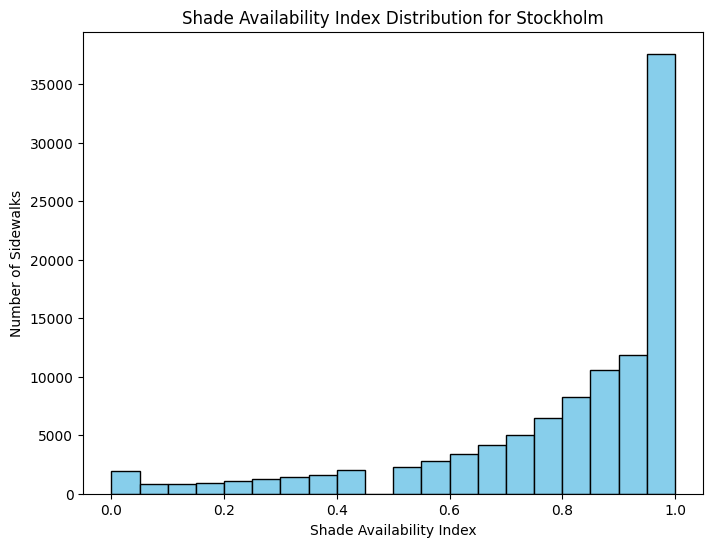

In [ ]:
import matplotlib.pyplot as plt

# Choose the city you want to visualize (e.g., "Tunis")
city_key = "Stockholm"
if city_key in combined_city_data:
    city_df = combined_city_data[city_key]
    
    # --- Histogram of the shade availability index ---
    plt.figure(figsize=(8, 6))
    plt.hist(city_df["shade_availability_index"], bins=20, color="skyblue", edgecolor="black")
    plt.title(f"Shade Availability Index Distribution for {city_key}")
    plt.xlabel("Shade Availability Index")
    plt.ylabel("Number of Sidewalks")
    plt.show()
    
    # # --- Spatial plot of sidewalks colored by shade availability index ---
    # if "geometry" in city_df.columns:
    #     fig, ax = plt.subplots(1, 1, figsize=(10, 8))
    #     city_df.plot(column="shade_availability_index", cmap="viridis", legend=True, ax=ax)
    #     ax.set_title(f"Spatial Distribution of Shade Availability Index for {city_key}")
    #     plt.show()
else:
    print(f"No data available for city key {city_key}")

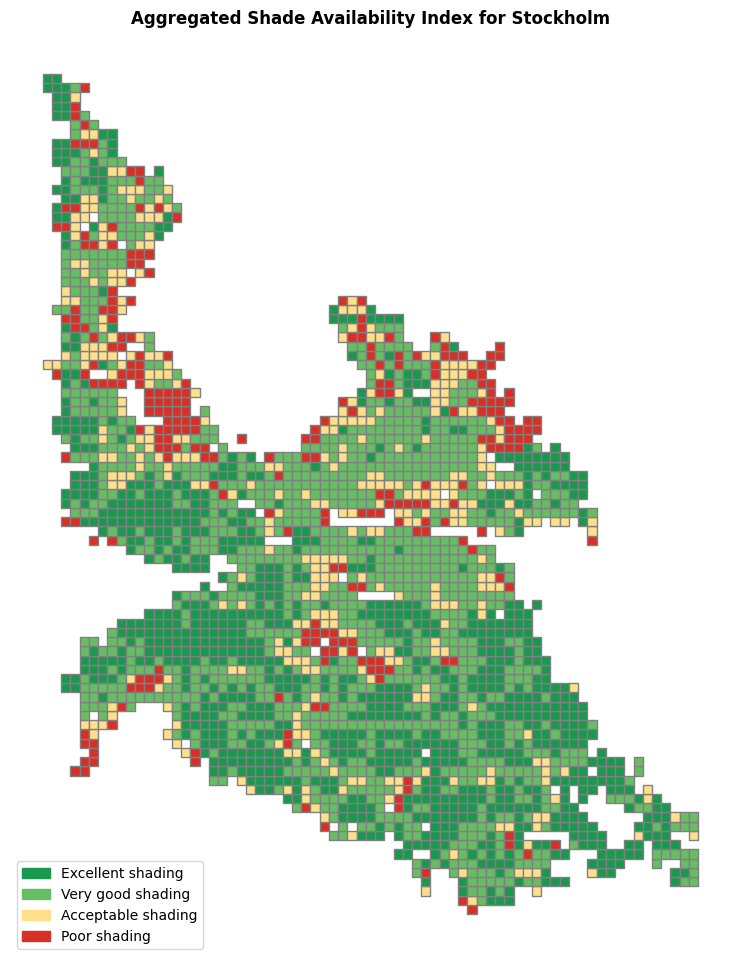

In [ ]:
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import box
from matplotlib.colors import ListedColormap

def create_grid(gdf, cell_size):
    """
    Create a grid (as a GeoDataFrame) covering the extent of gdf,
    with square cells of size cell_size (in the units of gdf's CRS).
    """
    xmin, ymin, xmax, ymax = gdf.total_bounds
    cols = int(np.ceil((xmax - xmin) / cell_size))
    rows = int(np.ceil((ymax - ymin) / cell_size))
    
    grid_cells = []
    for i in range(cols):
        for j in range(rows):
            cell = box(xmin + i * cell_size, 
                       ymin + j * cell_size, 
                       xmin + (i + 1) * cell_size, 
                       ymin + (j + 1) * cell_size)
            grid_cells.append(cell)
    
    grid = gpd.GeoDataFrame({'geometry': grid_cells}, crs=gdf.crs)
    return grid

def plot_shade_map(city, 
                   value_type='index', 
                   shade_type=None, 
                   time_str=None, 
                   classification='graduated', 
                   cell_size=1000):
    """
    Plot an aggregated shade map for a given city.
    
    Parameters:
    - city: Name of the city (must be a key in combined_city_data and city_details)
    - value_type: Either "time" or "index".
          "time": Uses a specific time-based shade column (requires shade_type and time_str).
          "index": Uses the computed "shade_availability_index" column.
    - shade_type: Either "building" or "tree" (required if value_type is "time").
    - time_str: A string representing the time in HHMM format (e.g., "1200") (required if value_type is "time").
    - classification: "graduated" for a continuous color ramp or "categorical" to bin the data.
    - cell_size: The grid cell size (in the units of the city's projected CRS).
    """
    # Retrieve the city's sidewalk GeoDataFrame and details.
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")
    city_gdf = combined_city_data[city]
    
    if city not in city_details:
        raise ValueError(f"City '{city}' not found in city_details.")
    date_str = city_details[city]["date"].replace("-", "")  # e.g., "20251221"
    
    # Determine which column to use.
    if value_type == 'time':
        if shade_type is None or time_str is None:
            raise ValueError("For value_type 'time', both shade_type and time_str must be provided.")
        shade_column = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
        if shade_column not in city_gdf.columns:
            raise ValueError(f"Column '{shade_column}' not found in the {city} data.")
        city_gdf = city_gdf.copy()
        city_gdf["shade_value"] = city_gdf[shade_column]
    elif value_type == 'index':
        if "shade_availability_index" not in city_gdf.columns:
            raise ValueError("The column 'shade_availability_index' was not found in the city data. Make sure it is computed beforehand.")
        city_gdf = city_gdf.copy()
        city_gdf["shade_value"] = city_gdf["shade_availability_index"]
    else:
        raise ValueError("value_type must be either 'time' or 'index'.")
    
    # Reproject to a projected CRS if necessary so that cell_size is meaningful.
    if city_gdf.crs.is_geographic:
        city_gdf = city_gdf.to_crs(epsg=3857)
    
    # Create a grid covering the extent of the city's sidewalk data.
    grid = create_grid(city_gdf, cell_size)
    
    # Spatially join the sidewalk polygons with the grid.
    joined = gpd.sjoin(city_gdf, grid, how="inner", predicate="intersects")
    
    # For each grid cell, compute the average shade value.
    grid_avg = joined.groupby("index_right")["shade_value"].mean()
    
    # Map the aggregated values back onto the grid GeoDataFrame.
    grid["avg_shade"] = grid.index.map(grid_avg)
    
    # Drop grid cells with no data.
    grid = grid.dropna(subset=["avg_shade"])
    
    # --- Binning for categorical display if selected ---
    if classification == "categorical":
        # Define shading categories based on targets.
        conditions = [
            grid["avg_shade"] >= 0.9,
            (grid["avg_shade"] >= 0.7) & (grid["avg_shade"] < 0.9),
            (grid["avg_shade"] >= 0.5) & (grid["avg_shade"] < 0.7),
            grid["avg_shade"] < 0.5
        ]
        choices = ["Excellent shading", "Very good shading", "Acceptable shading", "Poor shading"]
        grid["shade_category"] = np.select(conditions, choices, default="Unknown")
        
        # Revised categorical colors: from dark green (excellent) to red (poor).
        cat_colors = {
            "Excellent shading": "#1a9850",  # dark green
            "Very good shading": "#66bd63",   # medium green
            "Acceptable shading": "#fee08b",    # yellow/orange
            "Poor shading": "#d73027"         # red
        }
        grid["color"] = grid["shade_category"].map(cat_colors)
        
        # Plot the grid using the categorical colors.
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        grid.plot(color=grid["color"], edgecolor="grey", ax=ax)
        ax.set_title(f"Aggregated Shade Availability Index for {city}", weight='bold')
        ax.set_axis_off()
        
        # Create a custom legend.
        import matplotlib.patches as mpatches
        patches = [mpatches.Patch(color=color, label=label) for label, color in cat_colors.items()]
        ax.legend(handles=patches, loc="lower left")
        plt.show()
    
    # --- Graduated (continuous) display ---
    else:
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        grid.plot(column="avg_shade", cmap="YlGnBu", legend=True, edgecolor="grey", ax=ax)
        ax.set_title(f"Aggregated Shade Map for {city} ({classification.capitalize()})")
        ax.set_axis_off()
        plt.show()

# Example usage:
# To generate a map for Tunis using the precomputed shade availability index and categorical bins:
plot_shade_map(city="Stockholm", value_type='index', classification='categorical', cell_size=250)

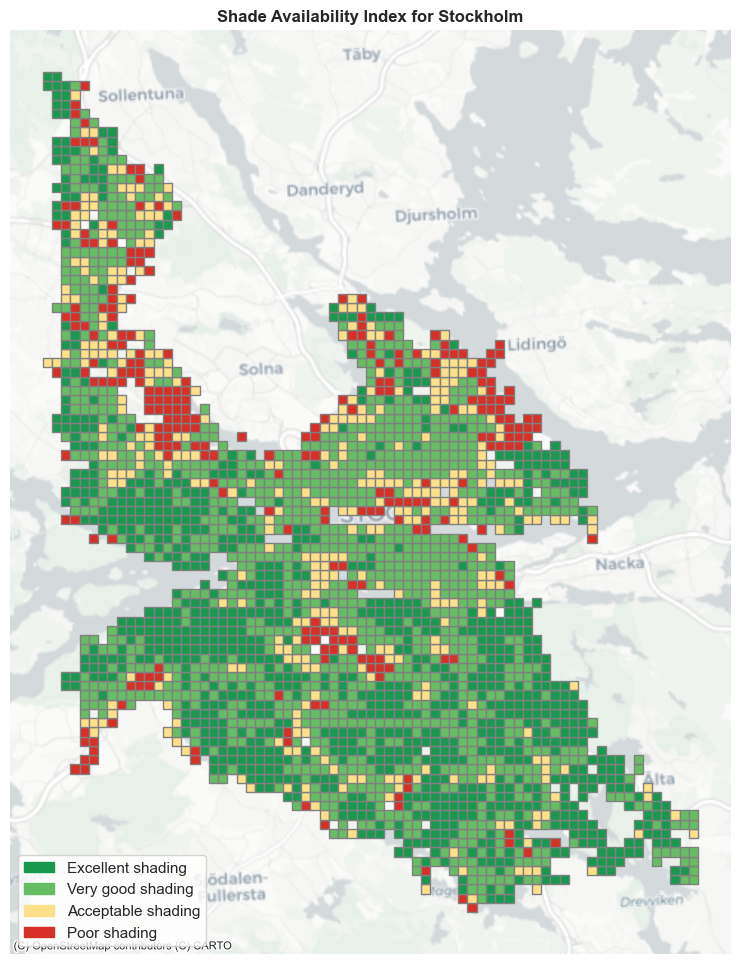

In [15]:
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import box
from matplotlib.colors import ListedColormap

def create_grid(gdf, cell_size):
    """
    Create a grid (as a GeoDataFrame) covering the extent of gdf,
    with square cells of size cell_size (in the units of gdf's CRS).
    """
    xmin, ymin, xmax, ymax = gdf.total_bounds
    cols = int(np.ceil((xmax - xmin) / cell_size))
    rows = int(np.ceil((ymax - ymin) / cell_size))
    
    grid_cells = []
    for i in range(cols):
        for j in range(rows):
            cell = box(xmin + i * cell_size, 
                       ymin + j * cell_size, 
                       xmin + (i + 1) * cell_size, 
                       ymin + (j + 1) * cell_size)
            grid_cells.append(cell)
    
    grid = gpd.GeoDataFrame({'geometry': grid_cells}, crs=gdf.crs)
    return grid

def plot_shade_map(city, 
                   value_type='index', 
                   shade_type=None, 
                   time_str=None, 
                   classification='graduated', 
                   cell_size=1000,
                   add_basemap=False):
    """
    Plot an aggregated shade map for a given city.
    
    Parameters:
    - city: Name of the city (must be a key in combined_city_data and city_details)
    - value_type: Either "time" or "index".
          "time": Uses a specific time-based shade column (requires shade_type and time_str).
          "index": Uses the computed "shade_availability_index" column.
    - shade_type: Either "building" or "tree" (required if value_type is "time").
    - time_str: A string representing the time in HHMM format (e.g., "1200") (required if value_type is "time").
    - classification: "graduated" for a continuous color ramp or "categorical" to bin the data.
    - cell_size: The grid cell size (in the units of the city's projected CRS).
    - add_basemap: Optional boolean to add a background map using Contextily.
    """
    # Retrieve the city's sidewalk GeoDataFrame and details.
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")
    city_gdf = combined_city_data[city]
    
    if city not in city_details:
        raise ValueError(f"City '{city}' not found in city_details.")
    date_str = city_details[city]["date"].replace("-", "")  # e.g., "20251221"
    
    # Determine which column to use.
    if value_type == 'time':
        if shade_type is None or time_str is None:
            raise ValueError("For value_type 'time', both shade_type and time_str must be provided.")
        shade_column = f"{date_str}_{shade_type}_shade_percent_at_{time_str}"
        if shade_column not in city_gdf.columns:
            raise ValueError(f"Column '{shade_column}' not found in the {city} data.")
        city_gdf = city_gdf.copy()
        city_gdf["shade_value"] = city_gdf[shade_column]
    elif value_type == 'index':
        if "shade_availability_index" not in city_gdf.columns:
            raise ValueError("The column 'shade_availability_index' was not found in the city data. Make sure it is computed beforehand.")
        city_gdf = city_gdf.copy()
        city_gdf["shade_value"] = city_gdf["shade_availability_index"]
    else:
        raise ValueError("value_type must be either 'time' or 'index'.")
    
    # Reproject to a projected CRS if necessary so that cell_size is meaningful.
    if city_gdf.crs.is_geographic:
        city_gdf = city_gdf.to_crs(epsg=3857)
    
    # Create a grid covering the extent of the city's sidewalk data.
    grid = create_grid(city_gdf, cell_size)
    
    # Spatially join the sidewalk polygons with the grid.
    joined = gpd.sjoin(city_gdf, grid, how="inner", predicate="intersects")
    
    # For each grid cell, compute the average shade value.
    grid_avg = joined.groupby("index_right")["shade_value"].mean()
    
    # Map the aggregated values back onto the grid GeoDataFrame.
    grid["avg_shade"] = grid.index.map(grid_avg)
    
    # Drop grid cells with no data.
    grid = grid.dropna(subset=["avg_shade"])
    
    # --- Plotting ---
    if classification == "categorical":
        # Define shading categories based on targets.
        conditions = [
            grid["avg_shade"] >= 0.9,
            (grid["avg_shade"] >= 0.7) & (grid["avg_shade"] < 0.9),
            (grid["avg_shade"] >= 0.5) & (grid["avg_shade"] < 0.7),
            grid["avg_shade"] < 0.5
        ]
        choices = ["Excellent shading", "Very good shading", "Acceptable shading", "Poor shading"]
        grid["shade_category"] = np.select(conditions, choices, default="Unknown")
        
        # Revised categorical colors: from dark green (excellent) to red (poor).
        cat_colors = {
            "Excellent shading": "#1a9850",  # dark green
            "Very good shading": "#66bd63",   # medium green
            "Acceptable shading": "#fee08b",    # yellow/orange
            "Poor shading": "#d73027"         # red
        }
        grid["color"] = grid["shade_category"].map(cat_colors)
        
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        grid.plot(color=grid["color"], edgecolor="grey", ax=ax)
        if add_basemap:
            import contextily as ctx
            ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=grid.crs)
        ax.set_title(f"Shade Availability Index for {city}", weight='bold')
        ax.set_axis_off()
        
        # Create a custom legend.
        import matplotlib.patches as mpatches
        patches = [mpatches.Patch(color=color, label=label) for label, color in cat_colors.items()]
        ax.legend(handles=patches, loc="lower left")
        plt.show()
    
    else:  # Graduated (continuous) display.
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        grid.plot(column="avg_shade", cmap="YlGnBu", legend=True, edgecolor="grey", ax=ax)
        if add_basemap:
            import contextily as ctx
            ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=grid.crs)
        ax.set_title(f"Aggregated Shade Map for {city} ({classification.capitalize()})")
        ax.set_axis_off()
        plt.show()

# Example usage:
# To generate a map for Stockholm using the precomputed shade availability index and categorical bins,
# with a background map added:
plot_shade_map(city="Stockholm", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

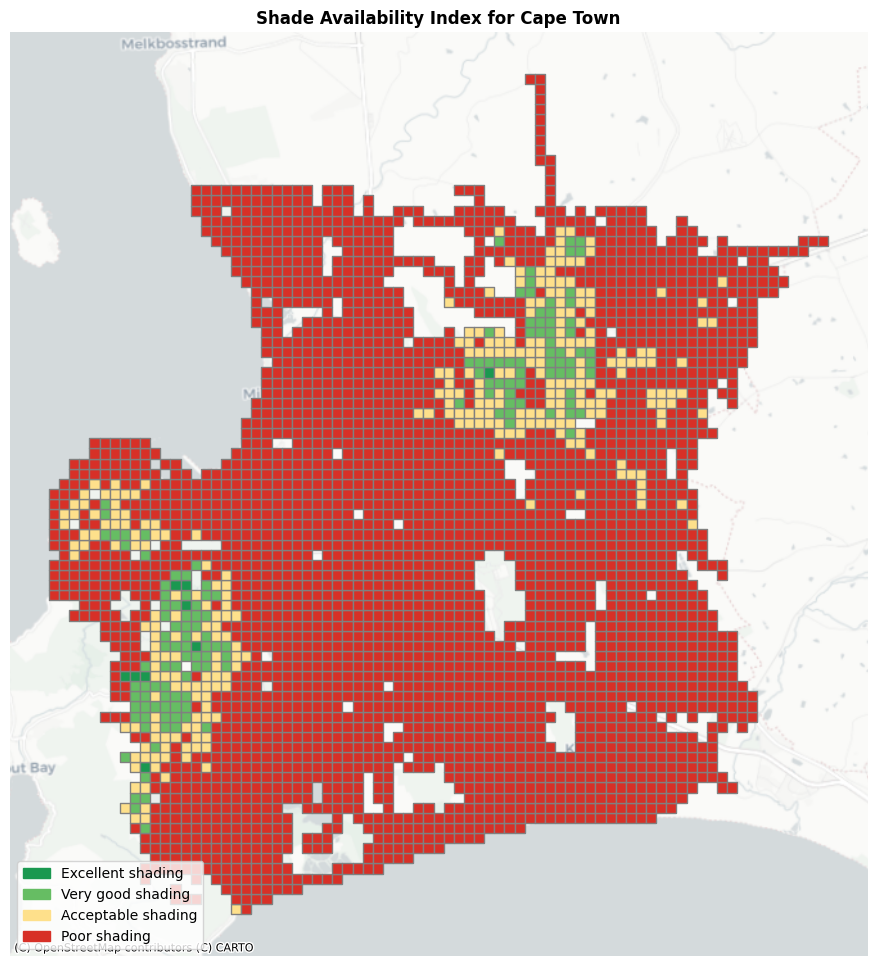

In [ ]:
plot_shade_map(city="Cape Town", value_type='index', classification='categorical', cell_size=500, add_basemap=True)

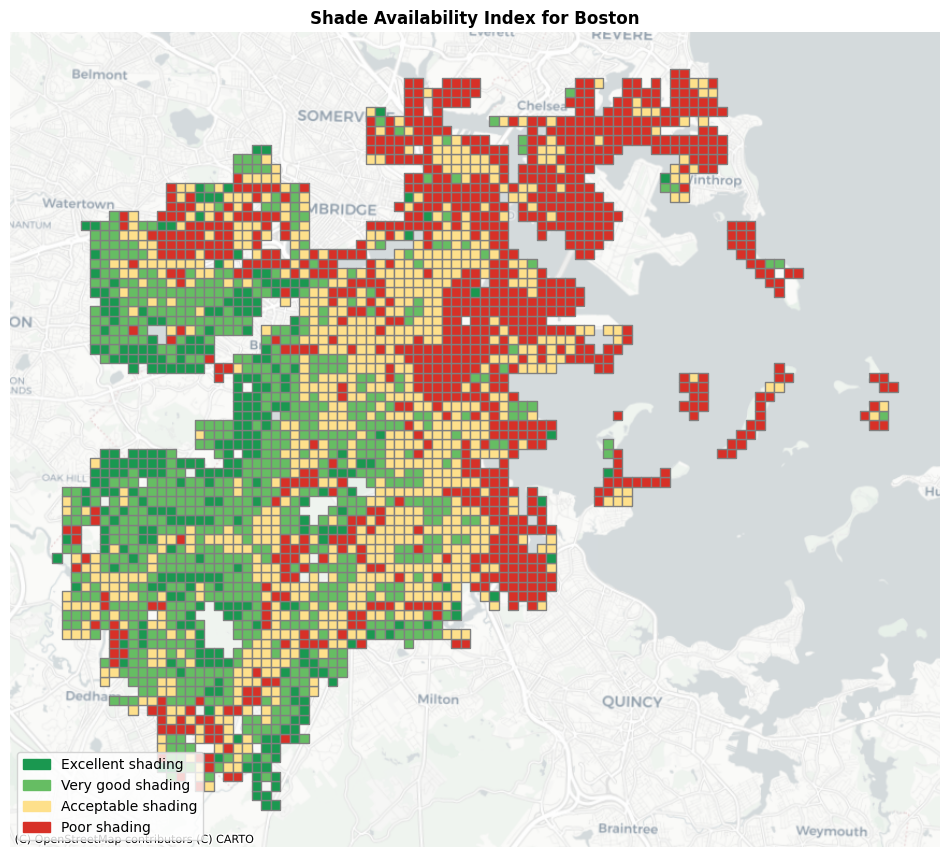

In [ ]:
plot_shade_map(city="Boston", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

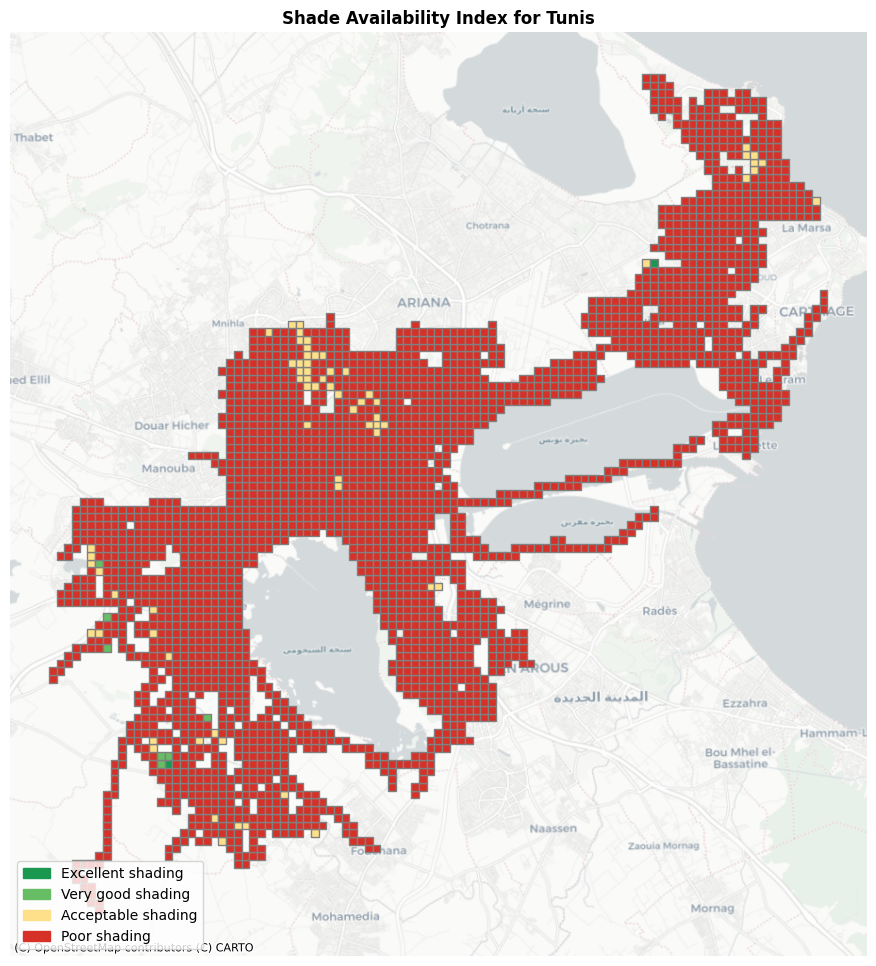

In [ ]:
plot_shade_map(city="Tunis", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

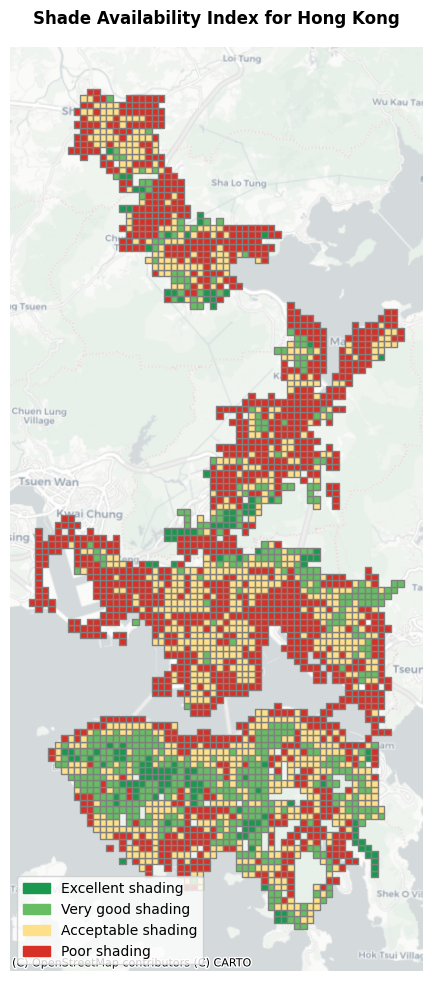

In [ ]:
plot_shade_map(city="Hong Kong", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

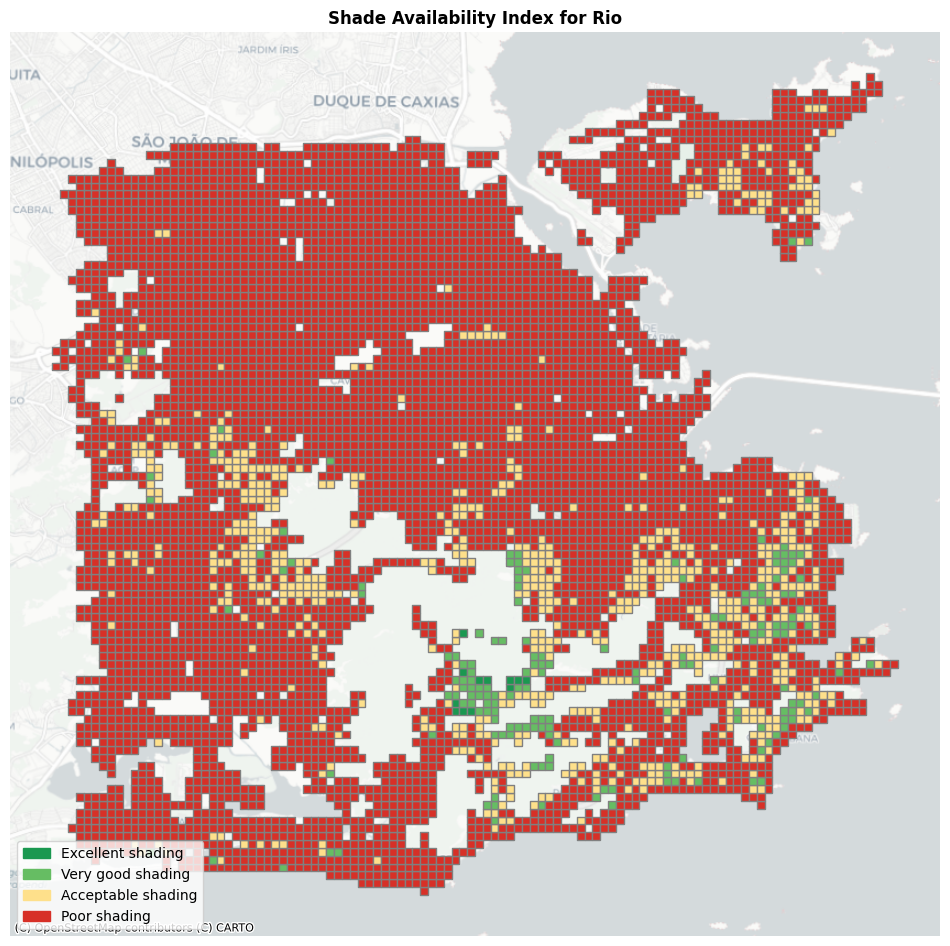

In [ ]:
plot_shade_map(city="Rio", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

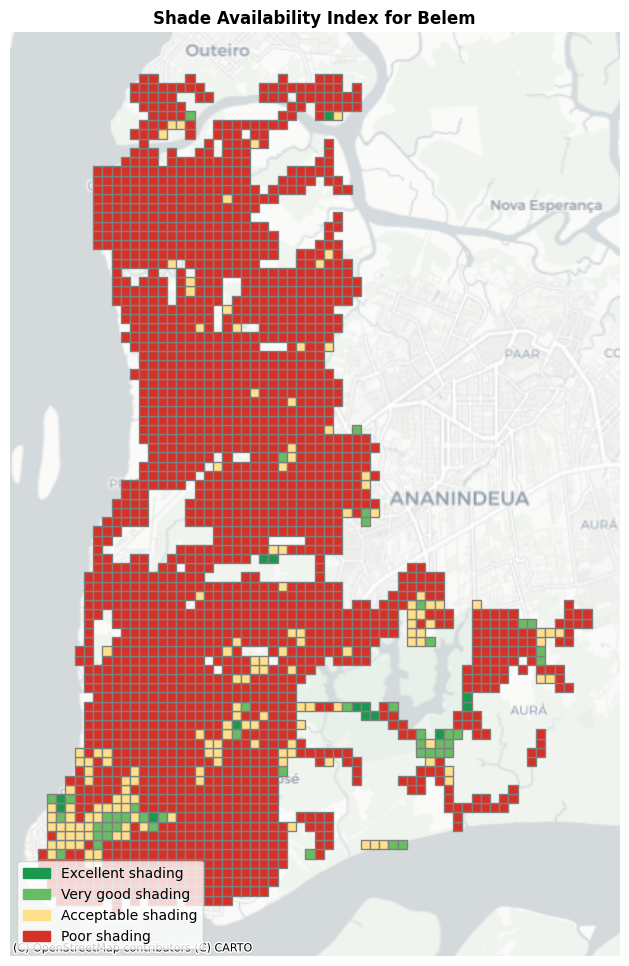

In [ ]:
plot_shade_map(city="Belem", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

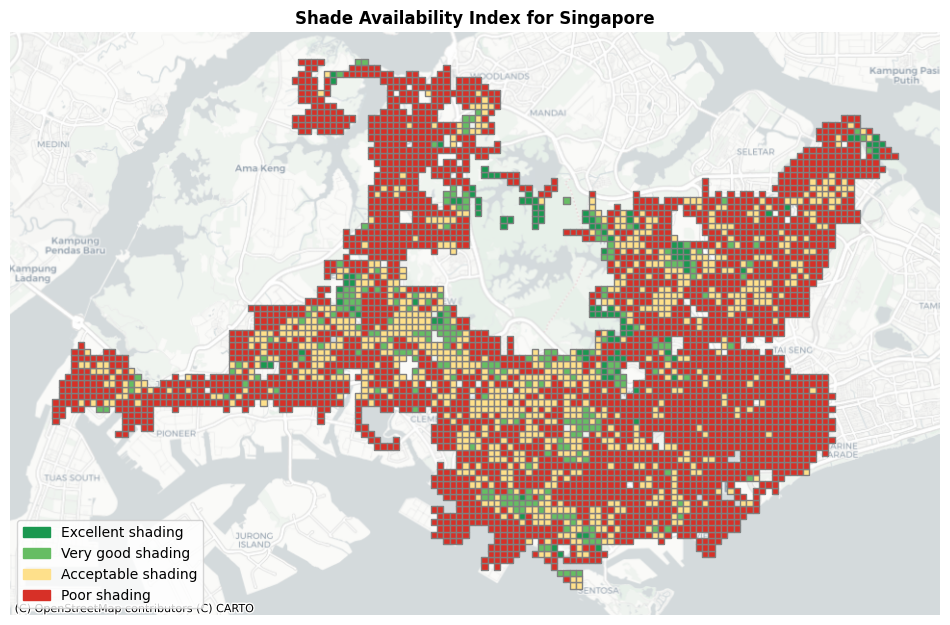

In [ ]:
plot_shade_map(city="Singapore", value_type='index', classification='categorical', cell_size=250, add_basemap=True)

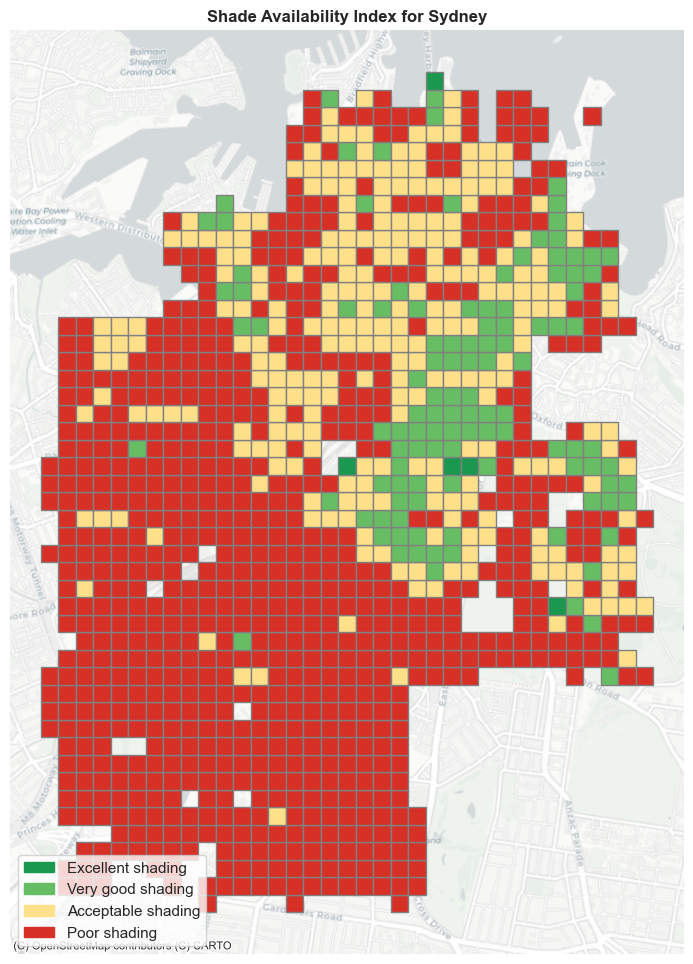

In [16]:
plot_shade_map(city="Sydney", value_type='index', classification='categorical', cell_size=150, add_basemap=True)

## H3 Shade availability index

In [36]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx
import h3
from shapely.geometry import Polygon
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches

def h3_cell_to_polygon(cell):
    """Convert an H3 cell to a shapely Polygon, assuming boundary is a list of (lat, lon) tuples."""
    boundary = h3.cell_to_boundary(cell)  # List of (lat, lon)
    coords = [(lon, lat) for lat, lon in boundary]  # convert to (x, y)
    return Polygon(coords)
def plot_shade_index_h3_binned(city, h3_resolution=8):
    """
    Plot binned shade availability index aggregated to H3 hexagons for a city.
    """
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")

    gdf = combined_city_data[city].copy()

    if "shade_availability_index_tree" not in gdf.columns:
        raise ValueError("Column 'shade_availability_index_tree' not found.")
    
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf = gdf.to_crs(epsg=3857)
    gdf["centroid"] = gdf.geometry.centroid
    gdf = gdf.set_geometry("centroid").to_crs("EPSG:4326")
    gdf["h3_cell"] = gdf.geometry.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # gdf = gdf.to_crs("EPSG:4326")
    # gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    # gdf["centroid"] = gdf.geometry.centroid
    # gdf["h3_cell"] = gdf["centroid"].apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate by H3 cell
    agg = gdf.groupby("h3_cell")["shade_availability_index_tree"].mean().reset_index()

    # Create geometry using fixed method
    agg["geometry"] = agg["h3_cell"].apply(h3_cell_to_polygon)

    # Categorize shade index
    bins = [0, 0.5, 0.7, 0.9, 1]
    labels = ["Poor shading", "Acceptable shading", "Very good shading", "Excellent shading"]
    colors = {
        "Poor shading": "#d73027",
        "Acceptable shading": "#fee08b",
        "Very good shading": "#66bd63",
        "Excellent shading": "#1a9850"
    }

    agg["category"] = pd.cut(agg["shade_availability_index_tree"], bins=bins, labels=labels, include_lowest=True)
    agg["color"] = agg["category"].map(colors)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)

    missing = hex_gdf[hex_gdf["color"].isna()]
    if not missing.empty:
        print(f"Dropping {len(missing)} hexagons with unclassified shade index:")
        print(missing[["h3_cell", "shade_availability_index_tree"]])
    # Drop rows without a category (which causes color=NaN)
    hex_gdf = hex_gdf.dropna(subset=["color"])

    # Plot
    fig, ax = plt.subplots(figsize=(10, 10))
    hex_gdf.plot(color=hex_gdf["color"], edgecolor="grey", linewidth=0.2, ax=ax)

    cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)#, zoom=16)

    # Legend
    legend_patches = [mpatches.Patch(color=clr, label=lbl) for lbl, clr in colors.items()]
    ax.legend(handles=legend_patches, loc="lower left", title="Shade Index")
    ax.set_title(f"{city} | Binned Shade Availability Index (H3 res {h3_resolution})", fontsize=14)
    ax.set_axis_off()

    plt.tight_layout()
    plt.show()

Dropping 1668 hexagons with unclassified shade index:
              h3_cell  shade_availability_index_tree
1     892a302812bffff                            NaN
2     892a302812fffff                            NaN
3     892a3028133ffff                            NaN
4     892a3028137ffff                            NaN
5     892a302813bffff                            NaN
...               ...                            ...
3223  892a339a6b3ffff                            NaN
3224  892a339a6b7ffff                            NaN
3225  892a339a6bbffff                            NaN
3226  892a339a6c7ffff                            NaN
3227  892a339a6d7ffff                            NaN

[1668 rows x 2 columns]


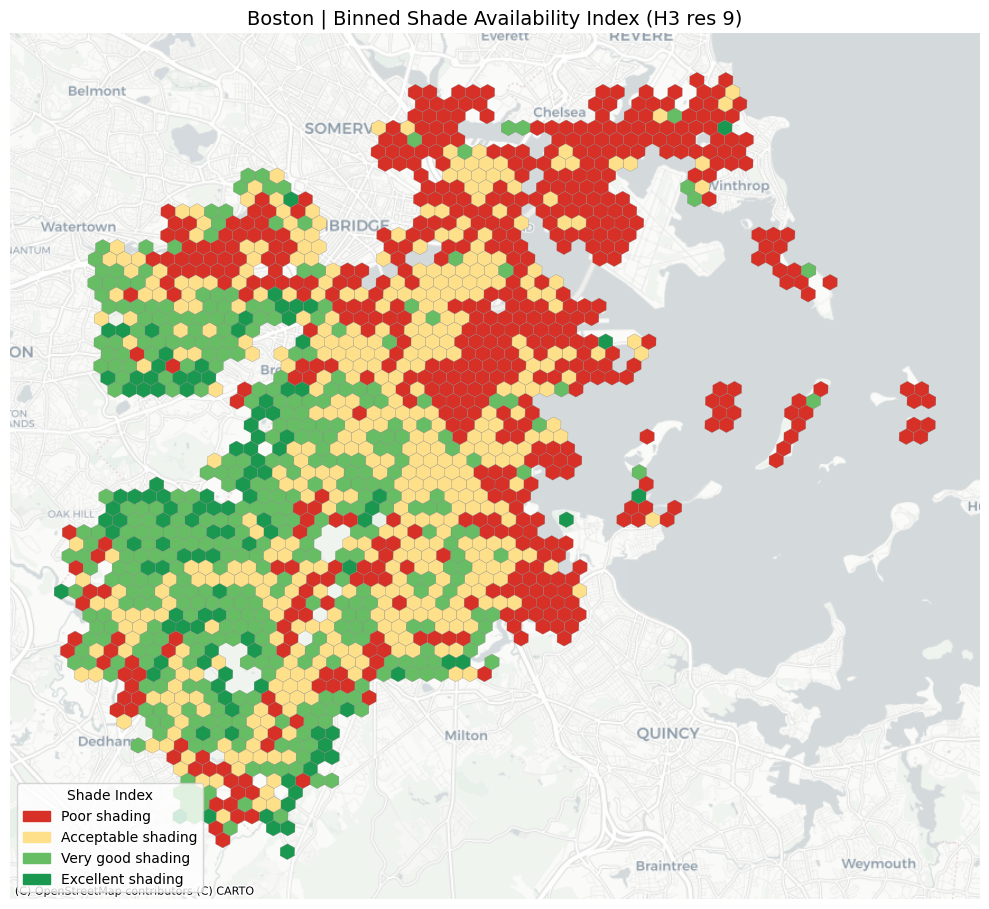

In [40]:
plot_shade_index_h3_binned("Boston", h3_resolution=9)

In [14]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx
import h3
from shapely.geometry import Polygon
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches
from matplotlib_scalebar.scalebar import ScaleBar

def h3_cell_to_polygon(cell):
    """Convert H3 cell to shapely Polygon (lon/lat to x/y)."""
    boundary = h3.cell_to_boundary(cell)  # list of (lat, lon)
    coords = [(lon, lat) for lat, lon in boundary]
    return Polygon(coords)

def plot_shade_index_h3_binned(city, h3_resolution=8, save_path=None):
    """
    Plot binned shade availability index aggregated to H3 hexagons for a city,
    styled for journal supplementary materials.
    """
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")

    gdf = combined_city_data[city].copy()

    if "shade_availability_index_tree" not in gdf.columns:
        raise ValueError("Column 'shade_availability_index_tree' not found.")

    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf = gdf.to_crs(epsg=3857)
    gdf["centroid"] = gdf.geometry.centroid
    gdf = gdf.set_geometry("centroid").to_crs("EPSG:4326")
    gdf["h3_cell"] = gdf.geometry.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate
    agg = gdf.groupby("h3_cell")["shade_availability_index_tree"].mean().reset_index()
    agg["geometry"] = agg["h3_cell"].apply(h3_cell_to_polygon)

    # Categorize
    bins = [0, 0.5, 0.7, 0.9, 1]
    labels = ["Poor shading", "Acceptable shading", "Very good shading", "Excellent shading"]
    # colors = {
    #     "Poor shading": "#d73027",
    #     "Acceptable shading": "#fee08b",
    #     "Very good shading": "#66bd63",
    #     "Excellent shading": "#1a9850"
    # }
    colors = {
        "Poor shading": "#fdae61",
        "Acceptable shading": "#fee08b",
        "Very good shading": "#abd9e9",
        "Excellent shading": "#2c7bb6"
    }
    agg["category"] = pd.cut(agg["shade_availability_index_tree"], bins=bins, labels=labels, include_lowest=True)
    agg["color"] = agg["category"].map(colors)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)
    hex_gdf = hex_gdf.dropna(subset=["color"])

    # Plot
    fig, ax = plt.subplots(figsize=(10, 10))
    hex_gdf.plot(color=hex_gdf["color"], alpha=0.65, edgecolor="gray", linewidth=0.1, ax=ax)

    cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron)#, zoom=15)

    # Title
    ax.set_title(f"{city} | Combined Shade Availability Index (H3 res {h3_resolution})", fontsize=16, fontweight="bold")

    # Legend
    legend_patches = [
        mpatches.Patch(color=clr, label=lbl) for lbl, clr in colors.items()
    ]
    legend = ax.legend(
        handles=legend_patches,
        loc="lower left",
        title="Shade Availability Index",
        title_fontproperties={"weight": "bold", "size": 12},
        prop={"size": 11}
    )

    # Scale bar
    scalebar = ScaleBar(dx=1, units="m", location='lower right', scale_loc="bottom", length_fraction=0.1, box_alpha=0)
    ax.add_artist(scalebar)

    ax.set_axis_off()
    plt.tight_layout()

    # Save output
    if save_path:
        fig.savefig(f"{save_path}/{city}_shade_index_h3_res{h3_resolution}_recolor.png", dpi=300, bbox_inches='tight')
        fig.savefig(f"{save_path}/{city}_shade_index_h3_res{h3_resolution}_recolor.pdf", dpi=300, bbox_inches='tight')

    plt.show()

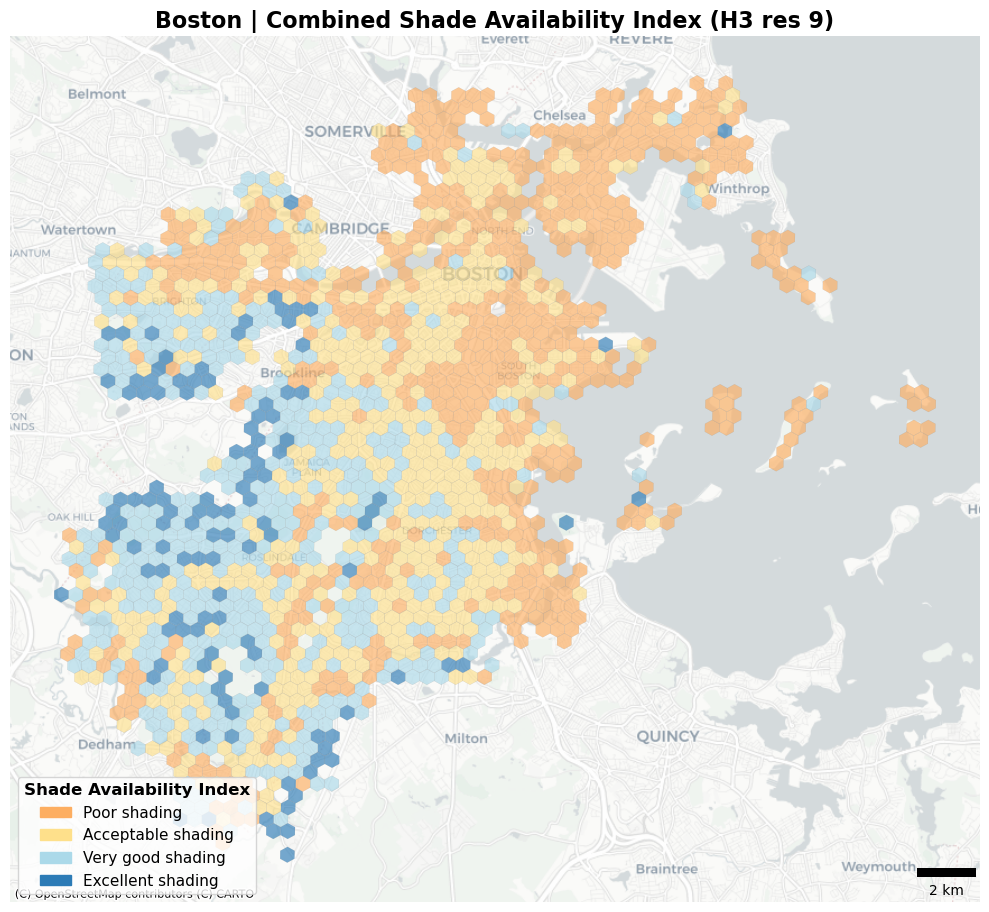

In [15]:
plot_shade_index_h3_binned("Boston", h3_resolution=9, save_path="../results/figures")

In [8]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx
import h3
from shapely.geometry import Polygon
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches
from matplotlib_scalebar.scalebar import ScaleBar
import osmnx as ox
from shapely.geometry.base import BaseGeometry


def plot_shade_index_h3_binned(city, h3_resolution=8, save_path=None, add_osm_labels=True):
    """
    Plot binned tree shade availability index aggregated to H3 hexagons for a city,
    styled for journal supplementary materials with optional OSM label overlay.
    """
    if city not in combined_city_data:
        raise ValueError(f"City '{city}' not found in combined_city_data.")
    gdf = combined_city_data[city].copy()

    if "shade_availability_index_tree" not in gdf.columns:
        raise ValueError("Column 'shade_availability_index_tree' not found.")

    # Reproject and generate H3 cells
    gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty]
    gdf = gdf.to_crs(epsg=3857)
    gdf["centroid"] = gdf.geometry.centroid
    gdf = gdf.set_geometry("centroid").to_crs("EPSG:4326")
    gdf["h3_cell"] = gdf.geometry.apply(lambda p: h3.latlng_to_cell(p.y, p.x, h3_resolution))

    # Aggregate
    agg = gdf.groupby("h3_cell")["shade_availability_index_tree"].mean().reset_index()
    agg["geometry"] = agg["h3_cell"].apply(h3_cell_to_polygon)

    # Categorize
    bins = [0, 0.5, 0.7, 0.9, 1]
    labels = ["Poor shading", "Acceptable shading", "Very good shading", "Excellent shading"]
    # colors = {
    #     "Poor shading": "#d73027",
    #     "Acceptable shading": "#fee08b",
    #     "Very good shading": "#66bd63",
    #     "Excellent shading": "#1a9850"
    # }
    colors = {
        "Poor shading": "#fdae61",
        "Acceptable shading": "#fee08b",
        "Very good shading": "#abd9e9",
        "Excellent shading": "#2c7bb6"
    }
    agg["category"] = pd.cut(agg["shade_availability_index_tree"], bins=bins, labels=labels, include_lowest=True)
    agg["color"] = agg["category"].map(colors)

    hex_gdf = gpd.GeoDataFrame(agg, geometry="geometry", crs="EPSG:4326").to_crs(epsg=3857)
    hex_gdf = hex_gdf.dropna(subset=["color"])

    # Plot
    fig, ax = plt.subplots(figsize=(10, 10))
    hex_gdf.plot(color=hex_gdf["color"], alpha=0.5, edgecolor="grey", linewidth=0.2, ax=ax)

    # Basemap
    cx.add_basemap(ax, crs=hex_gdf.crs, source=cx.providers.CartoDB.Positron, zoom=15)
    
    if add_osm_labels:
        try:
            # Union of all hex polygons as AOI
            hex_area = hex_gdf.to_crs("EPSG:4326").unary_union.buffer(0.001)

            tags = {"place": ["neighbourhood", "suburb", "quarter", "locality"]}

            # Manually get response as JSON
            response_jsons = ox.downloader._overpass_request(data=ox.downloader._make_overpass_polygon_request(hex_area, tags))

            print(response_jsons)

            # Manually parse features and skip problematic geometries
            geometries = []
            names = []
            for element in ox.downloader._parse_nodes_and_ways(response_jsons):
                geom = element.get("geometry")
                name = element.get("tags", {}).get("name")
                if geom and name:
                    if isinstance(geom, BaseGeometry) and geom.is_valid and not geom.is_empty:
                        geometries.append(geom)
                        names.append(name)
                    print(name)

            if not geometries:
                print("No valid named geometries returned from Overpass.")
            else:
                label_gdf = gpd.GeoDataFrame({"name": names, "geometry": geometries}, crs="EPSG:4326").to_crs(hex_gdf.crs)
                for _, row in label_gdf.iterrows():
                    ax.text(
                        row.geometry.centroid.x,
                        row.geometry.centroid.y,
                        row["name"],
                        fontsize=9,
                        color="black",
                        ha="center",
                        alpha=0.85,
                        zorder=10
                    )

        except Exception as e:
            print(f"Final fallback OSM label loading failed: {e}")

    # Title and legend
    ax.set_title(f"{city} | Tree Shade Availability Index", fontsize=16, fontweight="bold")
    legend_patches = [mpatches.Patch(color=clr, label=lbl) for lbl, clr in colors.items()]
    ax.legend(
        handles=legend_patches,
        loc="lower left",
        title="Shade Availability Index",
        title_fontproperties={"weight": "bold", "size": 12},
        prop={"size": 11}
    )

    # Optional scale bar (requires matplotlib-scalebar)
    try:
        from matplotlib_scalebar.scalebar import ScaleBar
        scalebar = ScaleBar(dx=1, units="m", location='lower right', scale_loc="bottom", length_fraction=0.1, box_alpha=0)
        ax.add_artist(scalebar)
    except ImportError:
        pass

    ax.set_axis_off()
    plt.tight_layout()

    # Save if needed
    if save_path:
        fig.savefig(f"{save_path}/{city}_shade_index_h3_res{h3_resolution}_recolor.png", dpi=300, bbox_inches='tight')
        fig.savefig(f"{save_path}/{city}_shade_index_h3_res{h3_resolution}_recolor.pdf", dpi=300, bbox_inches='tight')

    plt.show()

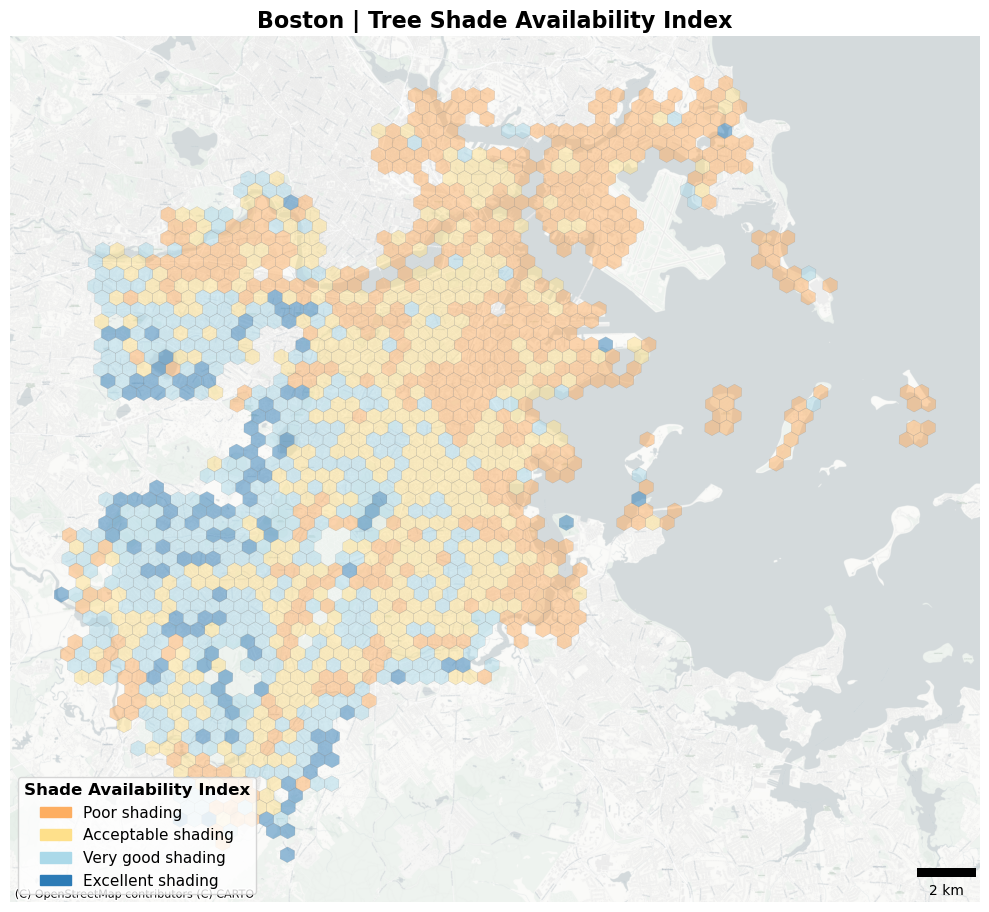

In [9]:
plot_shade_index_h3_binned("Boston", h3_resolution=9, add_osm_labels=False, save_path="../results/figures")

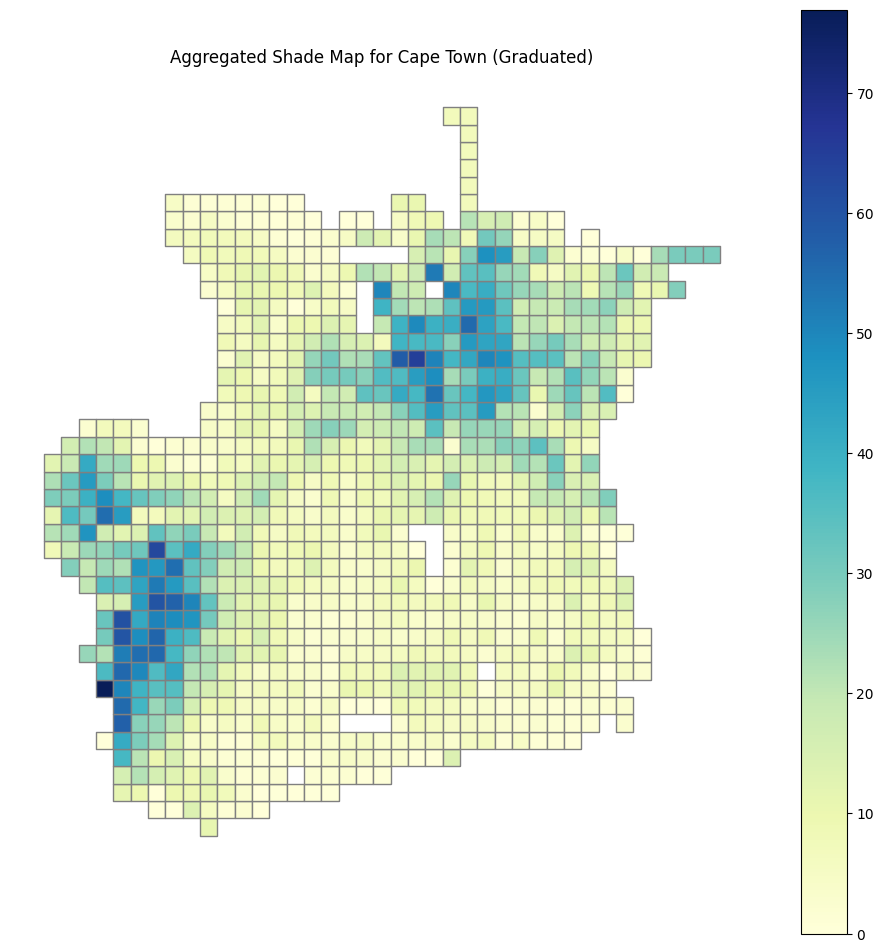

In [ ]:

# For a time-specific shade overview (if needed), you could use:
plot_shade_map(city="Cape Town", value_type='time', shade_type="tree", time_str="1200", classification='graduated', cell_size=1000)